In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import tensorflow as tf
import cv2
import random
import pickle
import time

In [3]:
# Подключение библиотек
from keras.datasets import mnist, cifar10 # Mnist - набор рукописных цифр, cifar10 - изображения объектов 1-ти классов
from keras.layers import Input, Dense, Reshape, Flatten, Dropout, BatchNormalization, Activation, MaxPooling2D, concatenate, Embedding, multiply # Базовые слои keras
from keras.layers.advanced_activations import LeakyReLU # LeakyReLU - функция активации
from keras.layers.convolutional import UpSampling2D, Conv2D, Conv2DTranspose # Сверточные слои keras
from keras.models import Sequential, Model # Формат модели keras
from tensorflow.keras.optimizers import Adam # Оптимизатор 

import matplotlib.pyplot as plt # Отображение графиков

import numpy as np # Numpy массивы

In [4]:
!unzip '/content/drive/My Drive/DATAS/cat_vs_dog.zip' -d cat_vs_dog

Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5501.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5502.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5503.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5504.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5505.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5506.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5507.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5508.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5509.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/551.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5510.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog/5511.jpg  
  inflating: cat_vs_dog/kagglecatsanddogs_3367a/PetImages

In [5]:
img_rows = 64 # Высота изображения в пикселях
img_cols = 64 # Ширина изображения в пикселях
channels = 1 # Количество каналов (глубина изображения)
img_shape = (img_rows, img_cols, channels) # Размерность входных данных для набора Mnist
latent_dim = 100 # Размерность скрытого пространства
batch_size = 128 # Размер batch_size

optimizer = Adam(0.0002, 0.5) # Оптимайзер

In [6]:
Datadir = 'cat_vs_dog/kagglecatsanddogs_3367a/PetImages/'
Categories = ['Dog', 'Cat']

img_size = 64
training_data = []

for Category in Categories:
    path = os.path.join(Datadir, Category)
    print("Loading data from ", path)
    class_num = Categories.index(Category)
    for img in os.listdir(path):
        try:
            img_array = cv2.imread(os.path.join(
                path, img), cv2.IMREAD_GRAYSCALE)
            img_resize = cv2.resize(img_array, (img_size, img_size))
            training_data.append([img_resize, class_num])
        except Exception as e:
            pass

Loading data from  cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Dog
Loading data from  cat_vs_dog/kagglecatsanddogs_3367a/PetImages/Cat


In [7]:
X, y = [], []
for feature, label in training_data:
    X.append(feature)
    y.append(label)
X_train = np.array(X).reshape(-1, img_size, img_size, 1)
X_train = X_train / 127.5 - 1.
y = np.array(y)

In [8]:
print(X_train.shape)
print(y.shape)

(24946, 64, 64, 1)
(24946,)


In [33]:
def create_generator(img_shape) :
  generator = Sequential()
  generator.add (Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
  generator.add (LeakyReLU(alpha=0.2))
  generator.add (Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
  generator.add (LeakyReLU(alpha=0.2))
  generator.add (Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
  generator.add (LeakyReLU(alpha=0.2))
  generator.add (Conv2D (1, (8, 8), activation='tanh', padding='same'))

  noise = Input(shape=latent_dim)
  label = Input(shape = (1,))
  label_modify = Flatten()(Embedding(2, latent_dim)(label))
  model_input = multiply([noise, label_modify])
  
  noise_modify = Dense (8 * 8 * batch_size) (model_input)
  noise_modify = LeakyReLU (alpha=0.2) (noise_modify)
  noise_modify = Reshape ((8, 8, batch_size)) (noise_modify)
  
  img = generator(noise_modify) # Записываем в переменную img значение, возвращаемое generator'ом  с входным параметром noise

  generator = Model([noise, label], img)
  
  return generator # Функция возвращаем generator

In [18]:
def create_discriminator(img_shape) :
  discriminator = Sequential()
  discriminator.add(Conv2D(64,(3,3),strides=(2,2), padding='same'))
  discriminator.add(LeakyReLU(alpha=0.2))
  discriminator.add(Conv2D(64,(3,3),strides=(2,2), padding='same'))
  discriminator.add(LeakyReLU(alpha=0.2))
  discriminator.add(Flatten())
  discriminator.add(Dense(32))
  discriminator.add(Dropout(0.4))
  discriminator.add(Dense(1,activation='sigmoid'))  

  img = Input(shape=img_shape) # Создаем слой Input (записываем входные данные размерностью (img_rows, img_cols, channels) в img)
  label = Input(shape = (1,))
  label_modify = Flatten()(Embedding(2, np.prod(img_shape))(label))
  model_input = multiply([Flatten()(img), label_modify])

  validity = discriminator(Reshape(img_shape)(model_input)) # Записываем в переменную validity значение, возвращаемое currDisc'ом с входным параметром img
  
  discriminator_conv = Model([img, label], validity) # Создаем модель discriminator_conv (входные данные: img, выходные данные: validity)

  # Компилируем модель дискриманотра
  discriminator_conv.compile(loss='binary_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])
 
  discriminator_conv.trainable = False  # Замораживаем обучение дискриматора 
 
  return discriminator_conv # Функция возвращает discriminator_conv

In [29]:
def sample_images(epoch, gen, noise, label): # Функция печати изображений
  r, c = 2, 3 # Параметры вывода (количество строк (r) и количество столбцов (c))
  
  gen_imgs = gen.predict([noise, label]) # Предиктим картинку с помощью входной переменной gen
  
  #gen_imgs = 0.5 * gen_imgs + 0.5 # Трансформируем значения в диапазон от 0 до 1

  fig, axs = plt.subplots(r, c) # Создаем окно вывода r на c (5 на 5) ячеек
  cnt = 0 # Порядковый номер картинки
  for i in range(r): 
      for j in range(c):
          axs[i,j].imshow(gen_imgs[cnt, :,:,0], cmap='gray') # Записываем в axs[i,j] сгенерироввнное изображение из gen_img с индексом cnt
          axs[i,j].axis('off') # Отключаем печать названия осей
          cnt += 1 # Увеличиваем индекс изображения
  plt.show() # Рисуем сгенерированные изображения
  fig.savefig("images/%d.png" % epoch) # Сохраняем изображения в папке images
  plt.close() # Завершаем работу с plt

In [30]:
def train(generator, discriminator, epochs=30000, batch_size=128): # Функция обучения   
  
  valid = np.ones((batch_size, 1)) # Создаем массив единиц длинной batch_size
  fake = np.zeros((batch_size, 1)) # Создаем массив нулей длинной batch_size

  discriminator.trainable = False  # Замораживаем обучение дискриматора 

  z = Input(shape=latent_dim) # Создаем слой Input (Записываем входные данные рамерностью letent_dim в z)
  label = Input(shape = (1,))
  img = generator([z, label]) # Записываем в переменную img значение, возвращаемое generator'ом  с входным параметром z
  validity = discriminator([img, label]) # Записываем в переменную validity значение, возвращаемое discriminator'ом с входным параметром img

  combined = Model([z, label], validity) # Создаем полную сеть combined (входные данные: z, выходные данне: validity)
  combined.compile(loss='binary_crossentropy', optimizer = optimizer) # Компилируем сеть combined, используя в качестве функции ошибки binary_crossentropy

  sample_interval = 50 # Указываем интервал, через который будем текущие сгенерированые изображения
  
  d_loss_list = [] # Массив значений ошибки дескриминатора
  g_loss_list = [] # Массив значений ошибки генератора
  d_acc_list = [] # Массив значений точности модели
  r, c = 2, 3
  CONST_NOISE = np.random.normal(0, 1, (r * c, latent_dim)) # Создаем вектор размерностью (r*c,latent_dim (25,100)) из нормально распределенных значений
  for epoch in range(epochs): 
    # ---------------------
    #  Train Discriminator
    # ---------------------

    idx = np.random.choice(X_train.shape[0], batch_size, replace=False) # Создаем массив случайных значений в диапазоне от 0 до X_train.shape[0] длинной batch_size
    imgs = X_train[idx] # В переменную imgs записываем значение из X_train с индексами из idx
    label = y[idx]
    noise = np.random.normal(0, 1, (batch_size, latent_dim)) # Создаем массив размерностью (batch_size,latent_dim) из нормально распределенных значений
    
    gen_imgs = generator.predict([noise, label]) # Предиктим картинку с помощью входной переменной generator
      
    # Train the discriminator
    d_loss_real = discriminator.train_on_batch([imgs, label], valid) # Получаем ошибку дискриминатора, обученного на реальной картинке (для этого передаем в функцию train_on_batch реальные изображения (imgs) и массив единици (valid))
    d_loss_fake = discriminator.train_on_batch([gen_imgs, label], fake) # Получаем ошибку дискриминатора, обученного на сгенерированной картинке (для этого передаем в функцию train_on_batch сгенерирпованные изображения (gen_imgs) и массив нулей (fake))
    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake) # Получаем массив ошибок дискриминатора (поэлементно складываем массивы d_loss_real и d_loss_fake) и делим каждое значение пополам

    # ---------------------
    #  Train Generator
    # ---------------------

    g_loss = combined.train_on_batch([noise, label], valid) # Получаем ошибку генератора (для этого передаем в функцию train_on_batch шум (noise) и массив единиц (valid))
    
    print ("%d [D loss: %f, acc.: %.2f%%] [G loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss)) # Печатаем номер эпохи и значения ошибок на этой эпохе

    d_loss_list.append(d_loss[0]) # Добавляем в маасив значений ошибок дискриматора первое значение в массиве d_loss
    g_loss_list.append(g_loss) # Добавляем в массив значений ошибок генератора g_loss
    d_acc_list.append(100*d_loss[1]) # Добавляем в массив значений точности модели второе значение в массиве d_loss умноженное на 100
        
    # Проверяем на условие вывода информации раз в sample_interval эпох
    if ((epoch % sample_interval == 0) | (epoch == epochs-1)): 
        sample_images(epoch, generator, CONST_NOISE, label = np.array([1, 1, 1, 0, 0, 0])) # Вызываем функцию sample_images для печати изображений
  
  # Выводим графики, 1 - график ошибок дискриминатора и генератора, 2 - график точности распознавания
  plt.plot(d_loss_list, label="Ошибка дискриминатора")
  plt.plot(g_loss_list, label="Ошибка генератора")
  plt.legend()
  plt.show()
  plt.plot(d_acc_list, label="Точность распознавания дискриминатора")
  plt.legend()
  plt.show()

0 [D loss: 0.885145, acc.: 13.67%] [G loss: 1.115753]


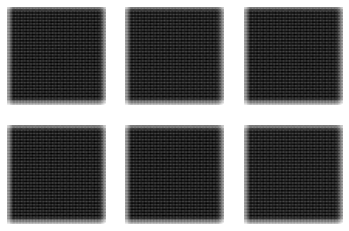

1 [D loss: 0.941026, acc.: 0.00%] [G loss: 0.732888]
2 [D loss: 0.737092, acc.: 0.00%] [G loss: 0.686963]
3 [D loss: 0.723639, acc.: 50.00%] [G loss: 0.684153]
4 [D loss: 0.707675, acc.: 50.00%] [G loss: 0.703153]
5 [D loss: 0.696618, acc.: 49.22%] [G loss: 0.743862]
6 [D loss: 0.698728, acc.: 29.69%] [G loss: 0.722397]
7 [D loss: 0.706787, acc.: 24.61%] [G loss: 0.687537]
8 [D loss: 0.705763, acc.: 37.11%] [G loss: 0.682177]
9 [D loss: 0.703645, acc.: 41.80%] [G loss: 0.680389]
10 [D loss: 0.704396, acc.: 44.92%] [G loss: 0.677749]
11 [D loss: 0.717086, acc.: 45.70%] [G loss: 0.666763]
12 [D loss: 0.713347, acc.: 47.27%] [G loss: 0.670858]
13 [D loss: 0.704885, acc.: 49.22%] [G loss: 0.681358]
14 [D loss: 0.700258, acc.: 50.00%] [G loss: 0.690288]
15 [D loss: 0.695535, acc.: 50.00%] [G loss: 0.701780]
16 [D loss: 0.689764, acc.: 74.22%] [G loss: 0.729557]
17 [D loss: 0.677543, acc.: 89.06%] [G loss: 0.835340]
18 [D loss: 0.664821, acc.: 50.00%] [G loss: 0.969861]
19 [D loss: 0.638557,

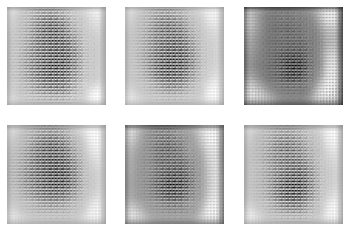

51 [D loss: 0.746234, acc.: 41.80%] [G loss: 0.602509]
52 [D loss: 0.730456, acc.: 43.36%] [G loss: 0.618625]
53 [D loss: 0.723580, acc.: 42.19%] [G loss: 0.628349]
54 [D loss: 0.719205, acc.: 42.58%] [G loss: 0.643155]
55 [D loss: 0.711500, acc.: 45.70%] [G loss: 0.655894]
56 [D loss: 0.705283, acc.: 43.75%] [G loss: 0.665930]
57 [D loss: 0.703592, acc.: 41.80%] [G loss: 0.677352]
58 [D loss: 0.698846, acc.: 39.06%] [G loss: 0.690269]
59 [D loss: 0.691253, acc.: 39.45%] [G loss: 0.702267]
60 [D loss: 0.685318, acc.: 42.58%] [G loss: 0.717188]
61 [D loss: 0.677848, acc.: 84.77%] [G loss: 0.729538]
62 [D loss: 0.671280, acc.: 85.55%] [G loss: 0.730710]
63 [D loss: 0.670851, acc.: 84.38%] [G loss: 0.734595]
64 [D loss: 0.666250, acc.: 87.89%] [G loss: 0.732926]
65 [D loss: 0.657890, acc.: 94.14%] [G loss: 0.735200]
66 [D loss: 0.657458, acc.: 92.58%] [G loss: 0.735994]
67 [D loss: 0.648720, acc.: 96.48%] [G loss: 0.737594]
68 [D loss: 0.646610, acc.: 96.09%] [G loss: 0.736307]
69 [D loss

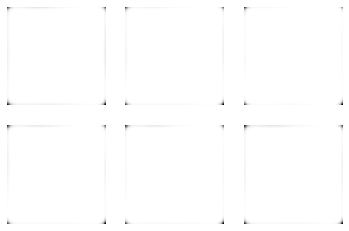

101 [D loss: 0.157437, acc.: 96.09%] [G loss: 2.929770]
102 [D loss: 0.118274, acc.: 98.83%] [G loss: 2.959143]
103 [D loss: 0.097710, acc.: 98.83%] [G loss: 3.149875]
104 [D loss: 0.085042, acc.: 99.22%] [G loss: 3.400633]
105 [D loss: 0.073421, acc.: 100.00%] [G loss: 3.348606]
106 [D loss: 0.089412, acc.: 98.05%] [G loss: 3.562831]
107 [D loss: 0.060555, acc.: 99.61%] [G loss: 3.554819]
108 [D loss: 0.065126, acc.: 98.83%] [G loss: 3.516486]
109 [D loss: 0.054579, acc.: 99.61%] [G loss: 3.593677]
110 [D loss: 0.038199, acc.: 100.00%] [G loss: 3.789654]
111 [D loss: 0.046067, acc.: 98.83%] [G loss: 3.828326]
112 [D loss: 0.047549, acc.: 99.61%] [G loss: 3.778363]
113 [D loss: 0.046557, acc.: 99.22%] [G loss: 3.942899]
114 [D loss: 0.041600, acc.: 98.44%] [G loss: 3.899349]
115 [D loss: 0.027342, acc.: 100.00%] [G loss: 3.937843]
116 [D loss: 0.024497, acc.: 100.00%] [G loss: 4.157746]
117 [D loss: 0.027762, acc.: 99.61%] [G loss: 4.491848]
118 [D loss: 0.025173, acc.: 100.00%] [G los

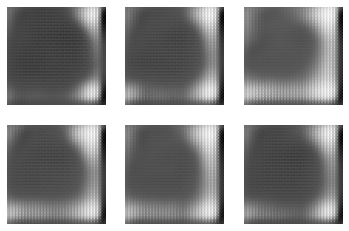

151 [D loss: 0.693406, acc.: 39.84%] [G loss: 0.662220]
152 [D loss: 0.690895, acc.: 39.45%] [G loss: 0.665540]
153 [D loss: 0.697470, acc.: 39.84%] [G loss: 0.663679]
154 [D loss: 0.701529, acc.: 39.45%] [G loss: 0.665318]
155 [D loss: 0.712711, acc.: 38.28%] [G loss: 0.670789]
156 [D loss: 0.710064, acc.: 38.67%] [G loss: 0.691788]
157 [D loss: 0.705642, acc.: 38.28%] [G loss: 0.723072]
158 [D loss: 0.688990, acc.: 53.12%] [G loss: 0.772081]
159 [D loss: 0.671739, acc.: 67.58%] [G loss: 0.824648]
160 [D loss: 0.653631, acc.: 78.12%] [G loss: 0.857437]
161 [D loss: 0.644612, acc.: 77.34%] [G loss: 0.888740]
162 [D loss: 0.648374, acc.: 79.69%] [G loss: 0.862300]
163 [D loss: 0.651664, acc.: 80.08%] [G loss: 0.822861]
164 [D loss: 0.677669, acc.: 63.28%] [G loss: 0.740856]
165 [D loss: 0.704277, acc.: 38.28%] [G loss: 0.690480]
166 [D loss: 0.721687, acc.: 32.42%] [G loss: 0.663668]
167 [D loss: 0.718489, acc.: 31.25%] [G loss: 0.656960]
168 [D loss: 0.717366, acc.: 33.98%] [G loss: 0.

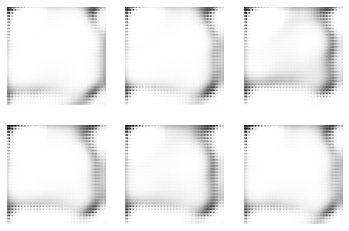

201 [D loss: 0.928238, acc.: 0.78%] [G loss: 0.870502]
202 [D loss: 0.786554, acc.: 50.00%] [G loss: 1.114413]
203 [D loss: 0.697474, acc.: 50.00%] [G loss: 1.250651]
204 [D loss: 0.638240, acc.: 51.17%] [G loss: 1.374880]
205 [D loss: 0.571561, acc.: 54.30%] [G loss: 1.447083]
206 [D loss: 0.549033, acc.: 58.20%] [G loss: 1.483947]
207 [D loss: 0.511993, acc.: 65.62%] [G loss: 1.547667]
208 [D loss: 0.481483, acc.: 73.44%] [G loss: 1.514232]
209 [D loss: 0.465620, acc.: 80.08%] [G loss: 1.508379]
210 [D loss: 0.477300, acc.: 84.38%] [G loss: 1.373562]
211 [D loss: 0.484585, acc.: 89.06%] [G loss: 1.209503]
212 [D loss: 0.515195, acc.: 93.36%] [G loss: 1.016392]
213 [D loss: 0.610612, acc.: 60.55%] [G loss: 0.788666]
214 [D loss: 0.726243, acc.: 43.75%] [G loss: 0.671619]
215 [D loss: 0.817809, acc.: 40.62%] [G loss: 0.577212]
216 [D loss: 0.845402, acc.: 37.89%] [G loss: 0.548284]
217 [D loss: 0.843702, acc.: 27.34%] [G loss: 0.596560]
218 [D loss: 0.832230, acc.: 21.48%] [G loss: 0.6

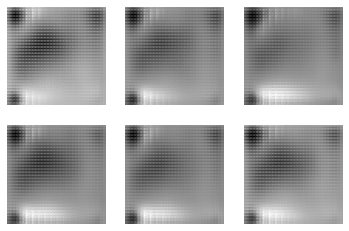

251 [D loss: 0.701401, acc.: 24.61%] [G loss: 0.695177]
252 [D loss: 0.700759, acc.: 25.39%] [G loss: 0.696316]
253 [D loss: 0.705581, acc.: 26.17%] [G loss: 0.698213]
254 [D loss: 0.703899, acc.: 28.91%] [G loss: 0.697830]
255 [D loss: 0.703972, acc.: 26.56%] [G loss: 0.694729]
256 [D loss: 0.708702, acc.: 23.05%] [G loss: 0.692364]
257 [D loss: 0.711943, acc.: 26.95%] [G loss: 0.692127]
258 [D loss: 0.711044, acc.: 23.05%] [G loss: 0.688149]
259 [D loss: 0.711818, acc.: 21.88%] [G loss: 0.688094]
260 [D loss: 0.718805, acc.: 16.41%] [G loss: 0.684211]
261 [D loss: 0.715891, acc.: 21.09%] [G loss: 0.682062]
262 [D loss: 0.721035, acc.: 15.62%] [G loss: 0.682197]
263 [D loss: 0.721557, acc.: 17.19%] [G loss: 0.678725]
264 [D loss: 0.721485, acc.: 14.84%] [G loss: 0.678923]
265 [D loss: 0.718382, acc.: 18.36%] [G loss: 0.679305]
266 [D loss: 0.717537, acc.: 18.75%] [G loss: 0.686723]
267 [D loss: 0.712819, acc.: 24.22%] [G loss: 0.687384]
268 [D loss: 0.711592, acc.: 25.78%] [G loss: 0.

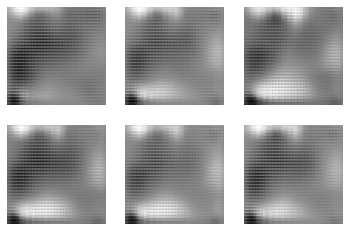

301 [D loss: 0.690801, acc.: 36.72%] [G loss: 0.698068]
302 [D loss: 0.692047, acc.: 32.42%] [G loss: 0.702242]
303 [D loss: 0.696462, acc.: 33.98%] [G loss: 0.707414]
304 [D loss: 0.692245, acc.: 47.27%] [G loss: 0.713074]
305 [D loss: 0.695653, acc.: 53.91%] [G loss: 0.719092]
306 [D loss: 0.690410, acc.: 67.97%] [G loss: 0.724901]
307 [D loss: 0.687173, acc.: 68.75%] [G loss: 0.731563]
308 [D loss: 0.685801, acc.: 69.53%] [G loss: 0.738426]
309 [D loss: 0.687488, acc.: 68.75%] [G loss: 0.744359]
310 [D loss: 0.680235, acc.: 68.75%] [G loss: 0.751364]
311 [D loss: 0.675479, acc.: 71.09%] [G loss: 0.758057]
312 [D loss: 0.675132, acc.: 70.31%] [G loss: 0.763784]
313 [D loss: 0.670328, acc.: 68.75%] [G loss: 0.766447]
314 [D loss: 0.674432, acc.: 68.36%] [G loss: 0.772670]
315 [D loss: 0.670523, acc.: 68.36%] [G loss: 0.776354]
316 [D loss: 0.666835, acc.: 70.31%] [G loss: 0.780990]
317 [D loss: 0.666003, acc.: 69.92%] [G loss: 0.781657]
318 [D loss: 0.666311, acc.: 72.27%] [G loss: 0.

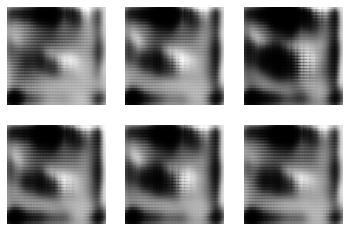

351 [D loss: 0.679538, acc.: 36.33%] [G loss: 0.682378]
352 [D loss: 0.698224, acc.: 36.72%] [G loss: 0.683214]
353 [D loss: 0.687603, acc.: 36.33%] [G loss: 0.697679]
354 [D loss: 0.707737, acc.: 38.67%] [G loss: 0.709932]
355 [D loss: 0.675070, acc.: 55.47%] [G loss: 0.762807]
356 [D loss: 0.642837, acc.: 57.03%] [G loss: 0.878191]
357 [D loss: 0.564162, acc.: 87.89%] [G loss: 1.052312]
358 [D loss: 0.522344, acc.: 83.59%] [G loss: 1.216774]
359 [D loss: 0.483063, acc.: 87.89%] [G loss: 1.348441]
360 [D loss: 0.504942, acc.: 83.98%] [G loss: 1.266164]
361 [D loss: 0.563630, acc.: 82.42%] [G loss: 1.046164]
362 [D loss: 0.610537, acc.: 62.89%] [G loss: 0.859240]
363 [D loss: 0.711946, acc.: 41.80%] [G loss: 0.681475]
364 [D loss: 0.739149, acc.: 36.72%] [G loss: 0.594995]
365 [D loss: 0.798385, acc.: 31.64%] [G loss: 0.550842]
366 [D loss: 0.828861, acc.: 31.64%] [G loss: 0.506313]
367 [D loss: 0.872955, acc.: 23.83%] [G loss: 0.501557]
368 [D loss: 0.879382, acc.: 19.92%] [G loss: 0.

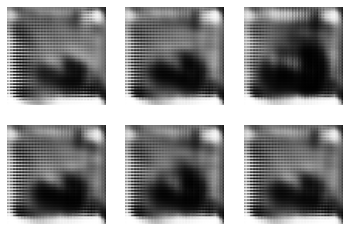

401 [D loss: 0.703731, acc.: 52.73%] [G loss: 0.769731]
402 [D loss: 0.700621, acc.: 48.05%] [G loss: 0.750373]
403 [D loss: 0.710402, acc.: 42.97%] [G loss: 0.730712]
404 [D loss: 0.725707, acc.: 30.08%] [G loss: 0.709031]
405 [D loss: 0.737539, acc.: 22.27%] [G loss: 0.673127]
406 [D loss: 0.742474, acc.: 21.48%] [G loss: 0.656470]
407 [D loss: 0.758624, acc.: 19.53%] [G loss: 0.650457]
408 [D loss: 0.760564, acc.: 21.09%] [G loss: 0.649374]
409 [D loss: 0.748125, acc.: 22.66%] [G loss: 0.657830]
410 [D loss: 0.764091, acc.: 17.58%] [G loss: 0.655781]
411 [D loss: 0.771133, acc.: 15.62%] [G loss: 0.657224]
412 [D loss: 0.767045, acc.: 16.80%] [G loss: 0.653156]
413 [D loss: 0.762776, acc.: 18.36%] [G loss: 0.672913]
414 [D loss: 0.755799, acc.: 20.70%] [G loss: 0.699180]
415 [D loss: 0.739319, acc.: 28.52%] [G loss: 0.730606]
416 [D loss: 0.740258, acc.: 28.52%] [G loss: 0.730705]
417 [D loss: 0.731463, acc.: 30.47%] [G loss: 0.735386]
418 [D loss: 0.734368, acc.: 35.55%] [G loss: 0.

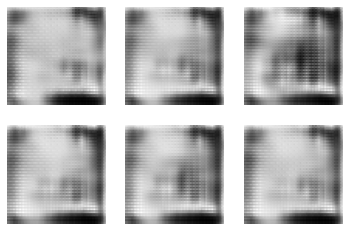

451 [D loss: 0.711388, acc.: 28.91%] [G loss: 0.682398]
452 [D loss: 0.720398, acc.: 23.05%] [G loss: 0.683901]
453 [D loss: 0.713101, acc.: 20.70%] [G loss: 0.694611]
454 [D loss: 0.709197, acc.: 28.12%] [G loss: 0.697286]
455 [D loss: 0.706191, acc.: 30.86%] [G loss: 0.702155]
456 [D loss: 0.703604, acc.: 33.59%] [G loss: 0.707875]
457 [D loss: 0.705377, acc.: 33.20%] [G loss: 0.714184]
458 [D loss: 0.696223, acc.: 48.83%] [G loss: 0.722879]
459 [D loss: 0.695725, acc.: 55.08%] [G loss: 0.731171]
460 [D loss: 0.693341, acc.: 61.72%] [G loss: 0.738143]
461 [D loss: 0.687010, acc.: 67.97%] [G loss: 0.744457]
462 [D loss: 0.691772, acc.: 66.80%] [G loss: 0.752702]
463 [D loss: 0.686720, acc.: 66.41%] [G loss: 0.757188]
464 [D loss: 0.686858, acc.: 65.23%] [G loss: 0.758439]
465 [D loss: 0.684242, acc.: 64.45%] [G loss: 0.762786]
466 [D loss: 0.677165, acc.: 69.14%] [G loss: 0.770920]
467 [D loss: 0.672047, acc.: 71.09%] [G loss: 0.773874]
468 [D loss: 0.673356, acc.: 69.53%] [G loss: 0.

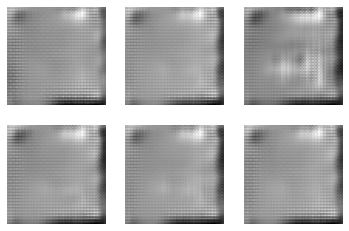

501 [D loss: 0.635887, acc.: 86.33%] [G loss: 0.763501]
502 [D loss: 0.639479, acc.: 87.11%] [G loss: 0.774585]
503 [D loss: 0.627772, acc.: 85.55%] [G loss: 0.784552]
504 [D loss: 0.621852, acc.: 89.06%] [G loss: 0.795180]
505 [D loss: 0.640040, acc.: 80.86%] [G loss: 0.802160]
506 [D loss: 0.613500, acc.: 87.89%] [G loss: 0.813436]
507 [D loss: 0.621815, acc.: 85.94%] [G loss: 0.823895]
508 [D loss: 0.614236, acc.: 85.94%] [G loss: 0.827030]
509 [D loss: 0.613148, acc.: 84.77%] [G loss: 0.833614]
510 [D loss: 0.607382, acc.: 86.72%] [G loss: 0.834621]
511 [D loss: 0.593132, acc.: 89.45%] [G loss: 0.836666]
512 [D loss: 0.597742, acc.: 87.11%] [G loss: 0.839722]
513 [D loss: 0.609666, acc.: 85.16%] [G loss: 0.844003]
514 [D loss: 0.606051, acc.: 83.59%] [G loss: 0.831034]
515 [D loss: 0.617101, acc.: 77.34%] [G loss: 0.820681]
516 [D loss: 0.651148, acc.: 64.84%] [G loss: 0.777762]
517 [D loss: 0.671355, acc.: 60.16%] [G loss: 0.737931]
518 [D loss: 0.724337, acc.: 45.31%] [G loss: 0.

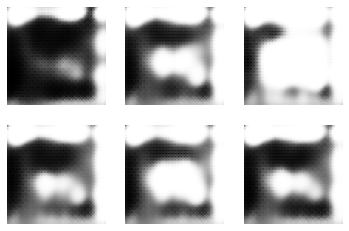

551 [D loss: 0.776921, acc.: 37.50%] [G loss: 0.784848]
552 [D loss: 0.736185, acc.: 47.27%] [G loss: 0.828425]
553 [D loss: 0.735385, acc.: 38.67%] [G loss: 0.846406]
554 [D loss: 0.696588, acc.: 49.61%] [G loss: 0.943681]
555 [D loss: 0.640910, acc.: 55.47%] [G loss: 1.152187]
556 [D loss: 0.586438, acc.: 61.33%] [G loss: 1.334188]
557 [D loss: 0.532597, acc.: 66.41%] [G loss: 1.492808]
558 [D loss: 0.518564, acc.: 70.31%] [G loss: 1.602675]
559 [D loss: 0.509561, acc.: 75.78%] [G loss: 1.589561]
560 [D loss: 0.515982, acc.: 81.25%] [G loss: 1.518640]
561 [D loss: 0.536758, acc.: 82.03%] [G loss: 1.368437]
562 [D loss: 0.559391, acc.: 84.38%] [G loss: 1.190851]
563 [D loss: 0.662410, acc.: 69.14%] [G loss: 0.922070]
564 [D loss: 0.686436, acc.: 55.47%] [G loss: 0.849013]
565 [D loss: 0.775325, acc.: 41.80%] [G loss: 0.740286]
566 [D loss: 0.776619, acc.: 37.50%] [G loss: 0.673375]
567 [D loss: 0.780150, acc.: 35.55%] [G loss: 0.631971]
568 [D loss: 0.782018, acc.: 33.59%] [G loss: 0.

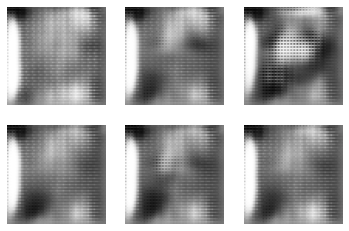

601 [D loss: 0.717412, acc.: 34.77%] [G loss: 0.693775]
602 [D loss: 0.762606, acc.: 23.05%] [G loss: 0.642079]
603 [D loss: 0.833653, acc.: 18.36%] [G loss: 0.570204]
604 [D loss: 0.868217, acc.: 21.48%] [G loss: 0.541063]
605 [D loss: 0.827176, acc.: 17.97%] [G loss: 0.597492]
606 [D loss: 0.784052, acc.: 14.84%] [G loss: 0.695389]
607 [D loss: 0.712318, acc.: 37.50%] [G loss: 0.819142]
608 [D loss: 0.656001, acc.: 61.72%] [G loss: 0.932842]
609 [D loss: 0.605761, acc.: 70.31%] [G loss: 1.028750]
610 [D loss: 0.602597, acc.: 69.92%] [G loss: 1.053670]
611 [D loss: 0.605466, acc.: 78.12%] [G loss: 0.987718]
612 [D loss: 0.631169, acc.: 82.42%] [G loss: 0.879767]
613 [D loss: 0.655313, acc.: 79.30%] [G loss: 0.800287]
614 [D loss: 0.661134, acc.: 82.42%] [G loss: 0.776303]
615 [D loss: 0.661976, acc.: 85.16%] [G loss: 0.771845]
616 [D loss: 0.664168, acc.: 79.30%] [G loss: 0.768569]
617 [D loss: 0.659758, acc.: 82.42%] [G loss: 0.760502]
618 [D loss: 0.668551, acc.: 71.48%] [G loss: 0.

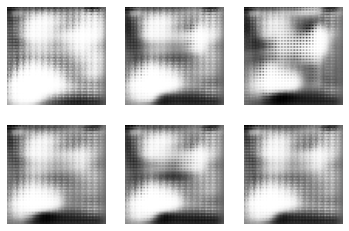

651 [D loss: 0.675436, acc.: 59.77%] [G loss: 0.788654]
652 [D loss: 0.664730, acc.: 65.23%] [G loss: 0.807518]
653 [D loss: 0.651545, acc.: 72.27%] [G loss: 0.829262]
654 [D loss: 0.652087, acc.: 73.83%] [G loss: 0.825619]
655 [D loss: 0.650699, acc.: 76.17%] [G loss: 0.814978]
656 [D loss: 0.659338, acc.: 72.66%] [G loss: 0.801507]
657 [D loss: 0.654637, acc.: 76.17%] [G loss: 0.787387]
658 [D loss: 0.663870, acc.: 71.09%] [G loss: 0.771041]
659 [D loss: 0.676756, acc.: 62.89%] [G loss: 0.757874]
660 [D loss: 0.680708, acc.: 56.64%] [G loss: 0.729972]
661 [D loss: 0.690700, acc.: 46.48%] [G loss: 0.703783]
662 [D loss: 0.714522, acc.: 36.33%] [G loss: 0.668221]
663 [D loss: 0.723149, acc.: 33.98%] [G loss: 0.648770]
664 [D loss: 0.730564, acc.: 30.86%] [G loss: 0.644435]
665 [D loss: 0.729796, acc.: 29.30%] [G loss: 0.653612]
666 [D loss: 0.718960, acc.: 29.69%] [G loss: 0.676393]
667 [D loss: 0.712035, acc.: 30.08%] [G loss: 0.696535]
668 [D loss: 0.702467, acc.: 45.70%] [G loss: 0.

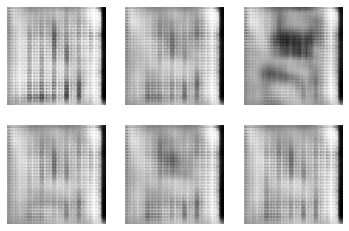

701 [D loss: 0.874322, acc.: 14.45%] [G loss: 0.536064]
702 [D loss: 0.885881, acc.: 11.72%] [G loss: 0.544580]
703 [D loss: 0.820971, acc.: 11.33%] [G loss: 0.643773]
704 [D loss: 0.749481, acc.: 27.73%] [G loss: 0.758503]
705 [D loss: 0.709702, acc.: 45.70%] [G loss: 0.845769]
706 [D loss: 0.701195, acc.: 44.14%] [G loss: 0.805978]
707 [D loss: 0.719478, acc.: 40.62%] [G loss: 0.738804]
708 [D loss: 0.713947, acc.: 37.89%] [G loss: 0.721367]
709 [D loss: 0.705577, acc.: 42.97%] [G loss: 0.731691]
710 [D loss: 0.700134, acc.: 48.05%] [G loss: 0.742481]
711 [D loss: 0.696122, acc.: 46.48%] [G loss: 0.746453]
712 [D loss: 0.692320, acc.: 55.08%] [G loss: 0.751447]
713 [D loss: 0.695424, acc.: 58.98%] [G loss: 0.768378]
714 [D loss: 0.676128, acc.: 67.97%] [G loss: 0.776907]
715 [D loss: 0.668573, acc.: 72.27%] [G loss: 0.786768]
716 [D loss: 0.668000, acc.: 71.88%] [G loss: 0.791313]
717 [D loss: 0.663298, acc.: 73.05%] [G loss: 0.808928]
718 [D loss: 0.658510, acc.: 72.66%] [G loss: 0.

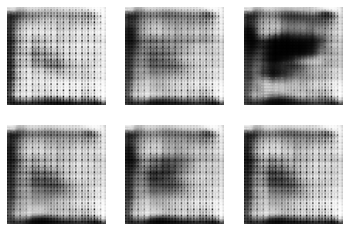

751 [D loss: 0.697530, acc.: 64.06%] [G loss: 0.755809]
752 [D loss: 0.695100, acc.: 59.77%] [G loss: 0.748859]
753 [D loss: 0.704055, acc.: 48.44%] [G loss: 0.729792]
754 [D loss: 0.704292, acc.: 44.53%] [G loss: 0.719772]
755 [D loss: 0.712342, acc.: 36.72%] [G loss: 0.713220]
756 [D loss: 0.710327, acc.: 38.67%] [G loss: 0.707359]
757 [D loss: 0.699415, acc.: 37.50%] [G loss: 0.706010]
758 [D loss: 0.704753, acc.: 26.95%] [G loss: 0.701347]
759 [D loss: 0.718737, acc.: 25.00%] [G loss: 0.701011]
760 [D loss: 0.703690, acc.: 28.52%] [G loss: 0.702805]
761 [D loss: 0.704281, acc.: 30.47%] [G loss: 0.702577]
762 [D loss: 0.698985, acc.: 30.47%] [G loss: 0.704292]
763 [D loss: 0.701602, acc.: 28.52%] [G loss: 0.703870]
764 [D loss: 0.695435, acc.: 34.77%] [G loss: 0.705544]
765 [D loss: 0.694172, acc.: 36.72%] [G loss: 0.704579]
766 [D loss: 0.695421, acc.: 32.81%] [G loss: 0.703510]
767 [D loss: 0.706569, acc.: 26.17%] [G loss: 0.702164]
768 [D loss: 0.706253, acc.: 22.66%] [G loss: 0.

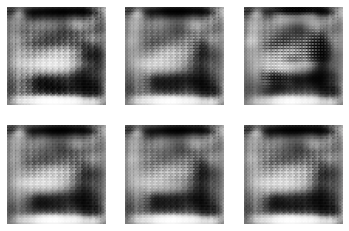

801 [D loss: 0.695750, acc.: 40.23%] [G loss: 0.695717]
802 [D loss: 0.706870, acc.: 36.72%] [G loss: 0.701524]
803 [D loss: 0.705912, acc.: 36.33%] [G loss: 0.694462]
804 [D loss: 0.705348, acc.: 35.16%] [G loss: 0.695950]
805 [D loss: 0.704853, acc.: 42.58%] [G loss: 0.694642]
806 [D loss: 0.705339, acc.: 46.09%] [G loss: 0.702991]
807 [D loss: 0.703842, acc.: 47.66%] [G loss: 0.703149]
808 [D loss: 0.699413, acc.: 48.83%] [G loss: 0.706166]
809 [D loss: 0.695673, acc.: 50.00%] [G loss: 0.713663]
810 [D loss: 0.690358, acc.: 47.66%] [G loss: 0.728862]
811 [D loss: 0.692683, acc.: 46.88%] [G loss: 0.739142]
812 [D loss: 0.683822, acc.: 48.83%] [G loss: 0.746106]
813 [D loss: 0.684781, acc.: 46.88%] [G loss: 0.751467]
814 [D loss: 0.680232, acc.: 53.91%] [G loss: 0.745989]
815 [D loss: 0.691353, acc.: 47.66%] [G loss: 0.731212]
816 [D loss: 0.689296, acc.: 51.56%] [G loss: 0.724009]
817 [D loss: 0.693496, acc.: 48.44%] [G loss: 0.717874]
818 [D loss: 0.691588, acc.: 44.53%] [G loss: 0.

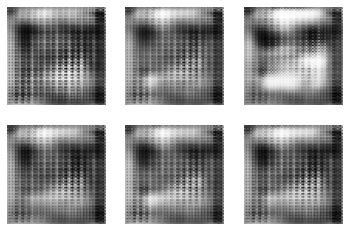

851 [D loss: 0.700959, acc.: 35.16%] [G loss: 0.638508]
852 [D loss: 0.729172, acc.: 40.23%] [G loss: 0.590831]
853 [D loss: 0.779119, acc.: 33.98%] [G loss: 0.561659]
854 [D loss: 0.773675, acc.: 31.25%] [G loss: 0.568156]
855 [D loss: 0.762420, acc.: 29.30%] [G loss: 0.605422]
856 [D loss: 0.735523, acc.: 29.30%] [G loss: 0.663953]
857 [D loss: 0.719152, acc.: 48.83%] [G loss: 0.707504]
858 [D loss: 0.714169, acc.: 45.70%] [G loss: 0.725741]
859 [D loss: 0.725537, acc.: 43.75%] [G loss: 0.724346]
860 [D loss: 0.744553, acc.: 23.44%] [G loss: 0.680400]
861 [D loss: 0.759275, acc.: 18.36%] [G loss: 0.654445]
862 [D loss: 0.755460, acc.: 18.36%] [G loss: 0.679195]
863 [D loss: 0.743090, acc.: 34.77%] [G loss: 0.723830]
864 [D loss: 0.707209, acc.: 45.31%] [G loss: 0.772473]
865 [D loss: 0.709675, acc.: 37.50%] [G loss: 0.786818]
866 [D loss: 0.693529, acc.: 56.25%] [G loss: 0.815902]
867 [D loss: 0.681726, acc.: 60.16%] [G loss: 0.839905]
868 [D loss: 0.682627, acc.: 56.25%] [G loss: 0.

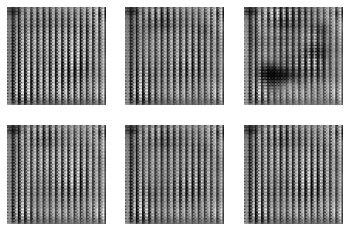

901 [D loss: 0.661442, acc.: 76.17%] [G loss: 0.765040]
902 [D loss: 0.666134, acc.: 76.56%] [G loss: 0.757656]
903 [D loss: 0.666635, acc.: 77.34%] [G loss: 0.741146]
904 [D loss: 0.671800, acc.: 70.70%] [G loss: 0.725835]
905 [D loss: 0.684150, acc.: 44.92%] [G loss: 0.706486]
906 [D loss: 0.692040, acc.: 35.94%] [G loss: 0.685322]
907 [D loss: 0.702870, acc.: 33.59%] [G loss: 0.661274]
908 [D loss: 0.710979, acc.: 31.64%] [G loss: 0.645772]
909 [D loss: 0.715018, acc.: 32.81%] [G loss: 0.636280]
910 [D loss: 0.720537, acc.: 35.16%] [G loss: 0.633847]
911 [D loss: 0.724141, acc.: 30.08%] [G loss: 0.638178]
912 [D loss: 0.714177, acc.: 32.81%] [G loss: 0.642938]
913 [D loss: 0.718194, acc.: 30.86%] [G loss: 0.639223]
914 [D loss: 0.717087, acc.: 36.33%] [G loss: 0.630691]
915 [D loss: 0.727742, acc.: 30.86%] [G loss: 0.625435]
916 [D loss: 0.731726, acc.: 30.86%] [G loss: 0.622684]
917 [D loss: 0.736893, acc.: 27.34%] [G loss: 0.626292]
918 [D loss: 0.725140, acc.: 30.86%] [G loss: 0.

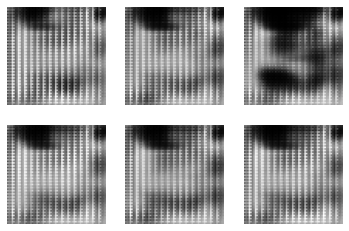

951 [D loss: 0.647860, acc.: 78.12%] [G loss: 0.789663]
952 [D loss: 0.646766, acc.: 75.00%] [G loss: 0.775409]
953 [D loss: 0.652236, acc.: 71.09%] [G loss: 0.760700]
954 [D loss: 0.652609, acc.: 68.75%] [G loss: 0.750941]
955 [D loss: 0.648979, acc.: 68.36%] [G loss: 0.743538]
956 [D loss: 0.679032, acc.: 50.78%] [G loss: 0.701971]
957 [D loss: 0.690089, acc.: 46.48%] [G loss: 0.673831]
958 [D loss: 0.740028, acc.: 35.16%] [G loss: 0.615370]
959 [D loss: 0.783425, acc.: 30.86%] [G loss: 0.580166]
960 [D loss: 0.790894, acc.: 26.95%] [G loss: 0.597872]
961 [D loss: 0.767049, acc.: 20.70%] [G loss: 0.682398]
962 [D loss: 0.701317, acc.: 45.70%] [G loss: 0.796191]
963 [D loss: 0.636577, acc.: 69.92%] [G loss: 0.949604]
964 [D loss: 0.599548, acc.: 75.39%] [G loss: 1.074890]
965 [D loss: 0.582014, acc.: 74.61%] [G loss: 1.116974]
966 [D loss: 0.594565, acc.: 77.34%] [G loss: 1.015815]
967 [D loss: 0.665041, acc.: 68.75%] [G loss: 0.767751]
968 [D loss: 0.717260, acc.: 33.59%] [G loss: 0.

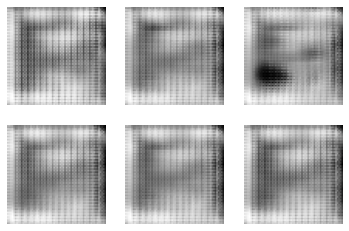

1001 [D loss: 0.738251, acc.: 29.30%] [G loss: 0.609924]
1002 [D loss: 0.822761, acc.: 29.69%] [G loss: 0.526980]
1003 [D loss: 0.903368, acc.: 25.39%] [G loss: 0.492128]
1004 [D loss: 0.873198, acc.: 22.66%] [G loss: 0.553493]
1005 [D loss: 0.786406, acc.: 17.19%] [G loss: 0.699086]
1006 [D loss: 0.682030, acc.: 61.33%] [G loss: 0.866718]
1007 [D loss: 0.620401, acc.: 71.09%] [G loss: 1.023643]
1008 [D loss: 0.581977, acc.: 79.69%] [G loss: 1.071143]
1009 [D loss: 0.619815, acc.: 72.66%] [G loss: 0.968931]
1010 [D loss: 0.649179, acc.: 80.86%] [G loss: 0.788595]
1011 [D loss: 0.725953, acc.: 33.59%] [G loss: 0.650391]
1012 [D loss: 0.743016, acc.: 35.55%] [G loss: 0.602744]
1013 [D loss: 0.756840, acc.: 33.20%] [G loss: 0.597666]
1014 [D loss: 0.732562, acc.: 35.16%] [G loss: 0.634896]
1015 [D loss: 0.723302, acc.: 34.38%] [G loss: 0.664276]
1016 [D loss: 0.699456, acc.: 57.81%] [G loss: 0.746606]
1017 [D loss: 0.682782, acc.: 49.61%] [G loss: 0.803135]
1018 [D loss: 0.680418, acc.: 5

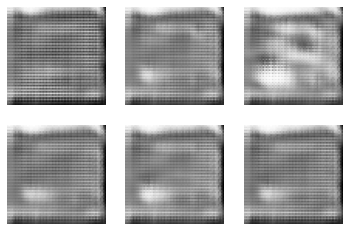

1051 [D loss: 0.615397, acc.: 73.44%] [G loss: 0.907764]
1052 [D loss: 0.599850, acc.: 78.52%] [G loss: 0.896598]
1053 [D loss: 0.606461, acc.: 76.17%] [G loss: 0.905581]
1054 [D loss: 0.595179, acc.: 80.86%] [G loss: 0.907564]
1055 [D loss: 0.588241, acc.: 80.47%] [G loss: 0.908296]
1056 [D loss: 0.569829, acc.: 86.33%] [G loss: 0.899329]
1057 [D loss: 0.566439, acc.: 84.77%] [G loss: 0.907251]
1058 [D loss: 0.569019, acc.: 84.77%] [G loss: 0.901104]
1059 [D loss: 0.552559, acc.: 87.89%] [G loss: 0.910343]
1060 [D loss: 0.549188, acc.: 91.02%] [G loss: 0.904671]
1061 [D loss: 0.545318, acc.: 89.45%] [G loss: 0.894822]
1062 [D loss: 0.535169, acc.: 94.53%] [G loss: 0.869830]
1063 [D loss: 0.571026, acc.: 88.28%] [G loss: 0.841604]
1064 [D loss: 0.563651, acc.: 91.41%] [G loss: 0.816972]
1065 [D loss: 0.585057, acc.: 83.98%] [G loss: 0.803398]
1066 [D loss: 0.590997, acc.: 77.73%] [G loss: 0.787064]
1067 [D loss: 0.619003, acc.: 63.67%] [G loss: 0.763979]
1068 [D loss: 0.622551, acc.: 5

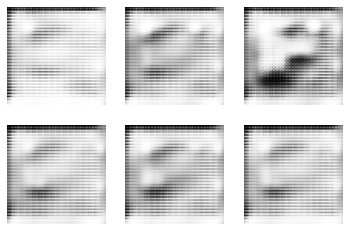

1101 [D loss: 0.684697, acc.: 69.92%] [G loss: 0.764323]
1102 [D loss: 0.692956, acc.: 62.89%] [G loss: 0.746197]
1103 [D loss: 0.685156, acc.: 58.59%] [G loss: 0.734116]
1104 [D loss: 0.690908, acc.: 58.98%] [G loss: 0.735300]
1105 [D loss: 0.690228, acc.: 57.81%] [G loss: 0.736454]
1106 [D loss: 0.684247, acc.: 62.50%] [G loss: 0.738023]
1107 [D loss: 0.683075, acc.: 66.80%] [G loss: 0.739175]
1108 [D loss: 0.678129, acc.: 74.61%] [G loss: 0.743307]
1109 [D loss: 0.679780, acc.: 72.66%] [G loss: 0.746725]
1110 [D loss: 0.678746, acc.: 74.61%] [G loss: 0.746573]
1111 [D loss: 0.676749, acc.: 73.83%] [G loss: 0.746261]
1112 [D loss: 0.679874, acc.: 69.14%] [G loss: 0.750398]
1113 [D loss: 0.676482, acc.: 72.66%] [G loss: 0.754062]
1114 [D loss: 0.674598, acc.: 73.05%] [G loss: 0.759946]
1115 [D loss: 0.677931, acc.: 74.22%] [G loss: 0.759088]
1116 [D loss: 0.671059, acc.: 75.39%] [G loss: 0.766460]
1117 [D loss: 0.678780, acc.: 73.83%] [G loss: 0.766812]
1118 [D loss: 0.675351, acc.: 7

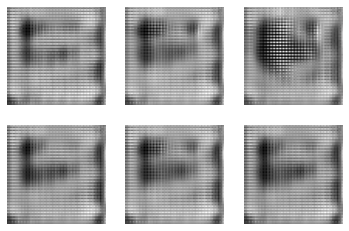

1151 [D loss: 0.711420, acc.: 28.12%] [G loss: 0.684424]
1152 [D loss: 0.711905, acc.: 28.12%] [G loss: 0.674769]
1153 [D loss: 0.738440, acc.: 25.78%] [G loss: 0.656000]
1154 [D loss: 0.751607, acc.: 22.27%] [G loss: 0.645467]
1155 [D loss: 0.762590, acc.: 24.61%] [G loss: 0.624275]
1156 [D loss: 0.786509, acc.: 19.14%] [G loss: 0.606856]
1157 [D loss: 0.799890, acc.: 13.67%] [G loss: 0.597126]
1158 [D loss: 0.814079, acc.: 12.11%] [G loss: 0.589028]
1159 [D loss: 0.796666, acc.: 14.84%] [G loss: 0.598407]
1160 [D loss: 0.786773, acc.: 17.58%] [G loss: 0.608731]
1161 [D loss: 0.790831, acc.: 12.50%] [G loss: 0.614569]
1162 [D loss: 0.772674, acc.: 14.06%] [G loss: 0.625525]
1163 [D loss: 0.761560, acc.: 12.50%] [G loss: 0.640595]
1164 [D loss: 0.757746, acc.: 13.28%] [G loss: 0.653607]
1165 [D loss: 0.745241, acc.: 15.23%] [G loss: 0.661550]
1166 [D loss: 0.735293, acc.: 29.69%] [G loss: 0.680589]
1167 [D loss: 0.726528, acc.: 39.84%] [G loss: 0.698814]
1168 [D loss: 0.716192, acc.: 4

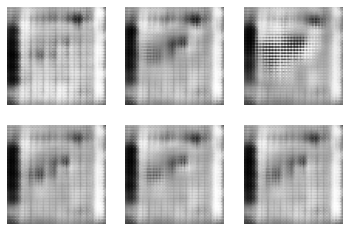

1201 [D loss: 0.783432, acc.: 25.78%] [G loss: 0.565064]
1202 [D loss: 0.801720, acc.: 25.39%] [G loss: 0.550946]
1203 [D loss: 0.799693, acc.: 22.27%] [G loss: 0.560695]
1204 [D loss: 0.793582, acc.: 23.05%] [G loss: 0.584476]
1205 [D loss: 0.762848, acc.: 25.78%] [G loss: 0.611400]
1206 [D loss: 0.743404, acc.: 29.30%] [G loss: 0.631198]
1207 [D loss: 0.734764, acc.: 24.61%] [G loss: 0.647294]
1208 [D loss: 0.725382, acc.: 29.30%] [G loss: 0.662652]
1209 [D loss: 0.713599, acc.: 29.30%] [G loss: 0.673573]
1210 [D loss: 0.698988, acc.: 30.08%] [G loss: 0.689392]
1211 [D loss: 0.692054, acc.: 35.55%] [G loss: 0.703140]
1212 [D loss: 0.688877, acc.: 47.27%] [G loss: 0.713157]
1213 [D loss: 0.677268, acc.: 71.09%] [G loss: 0.729119]
1214 [D loss: 0.672449, acc.: 81.25%] [G loss: 0.741079]
1215 [D loss: 0.665579, acc.: 83.59%] [G loss: 0.749125]
1216 [D loss: 0.659654, acc.: 82.42%] [G loss: 0.759249]
1217 [D loss: 0.653736, acc.: 85.16%] [G loss: 0.765776]
1218 [D loss: 0.655962, acc.: 8

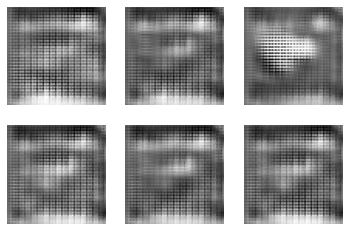

1251 [D loss: 0.673264, acc.: 71.88%] [G loss: 0.735884]
1252 [D loss: 0.675418, acc.: 69.92%] [G loss: 0.739276]
1253 [D loss: 0.666397, acc.: 72.27%] [G loss: 0.732392]
1254 [D loss: 0.672043, acc.: 72.66%] [G loss: 0.735397]
1255 [D loss: 0.669399, acc.: 70.31%] [G loss: 0.734276]
1256 [D loss: 0.668139, acc.: 70.31%] [G loss: 0.728239]
1257 [D loss: 0.667544, acc.: 66.41%] [G loss: 0.727145]
1258 [D loss: 0.666140, acc.: 70.31%] [G loss: 0.735064]
1259 [D loss: 0.672757, acc.: 63.67%] [G loss: 0.723990]
1260 [D loss: 0.674745, acc.: 68.36%] [G loss: 0.720777]
1261 [D loss: 0.668707, acc.: 63.28%] [G loss: 0.712321]
1262 [D loss: 0.680659, acc.: 55.47%] [G loss: 0.708552]
1263 [D loss: 0.681743, acc.: 48.83%] [G loss: 0.701604]
1264 [D loss: 0.690786, acc.: 41.41%] [G loss: 0.686699]
1265 [D loss: 0.713060, acc.: 31.25%] [G loss: 0.669314]
1266 [D loss: 0.715253, acc.: 28.91%] [G loss: 0.664784]
1267 [D loss: 0.731188, acc.: 26.17%] [G loss: 0.654772]
1268 [D loss: 0.720417, acc.: 2

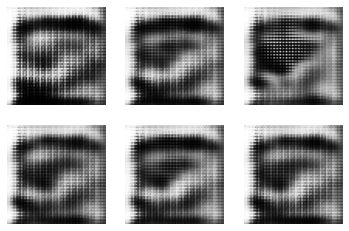

1301 [D loss: 0.826209, acc.: 26.95%] [G loss: 0.517758]
1302 [D loss: 0.832109, acc.: 23.83%] [G loss: 0.536175]
1303 [D loss: 0.804430, acc.: 23.44%] [G loss: 0.571822]
1304 [D loss: 0.772337, acc.: 20.31%] [G loss: 0.624788]
1305 [D loss: 0.740145, acc.: 18.75%] [G loss: 0.680387]
1306 [D loss: 0.721007, acc.: 21.88%] [G loss: 0.722678]
1307 [D loss: 0.707083, acc.: 41.02%] [G loss: 0.756196]
1308 [D loss: 0.682829, acc.: 66.80%] [G loss: 0.789487]
1309 [D loss: 0.671444, acc.: 66.41%] [G loss: 0.806548]
1310 [D loss: 0.669702, acc.: 66.80%] [G loss: 0.829682]
1311 [D loss: 0.664663, acc.: 69.14%] [G loss: 0.829148]
1312 [D loss: 0.667090, acc.: 66.02%] [G loss: 0.829049]
1313 [D loss: 0.684747, acc.: 60.16%] [G loss: 0.822558]
1314 [D loss: 0.677015, acc.: 68.36%] [G loss: 0.801800]
1315 [D loss: 0.681503, acc.: 67.58%] [G loss: 0.786707]
1316 [D loss: 0.689106, acc.: 58.20%] [G loss: 0.773274]
1317 [D loss: 0.695930, acc.: 45.70%] [G loss: 0.755355]
1318 [D loss: 0.693149, acc.: 4

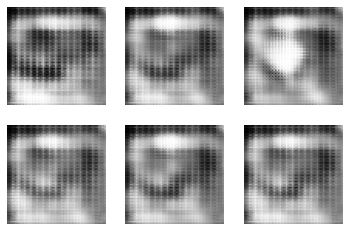

1351 [D loss: 0.704463, acc.: 42.58%] [G loss: 0.705228]
1352 [D loss: 0.700495, acc.: 48.44%] [G loss: 0.700372]
1353 [D loss: 0.696839, acc.: 50.39%] [G loss: 0.703193]
1354 [D loss: 0.703370, acc.: 40.23%] [G loss: 0.701837]
1355 [D loss: 0.697456, acc.: 45.70%] [G loss: 0.703738]
1356 [D loss: 0.700126, acc.: 44.14%] [G loss: 0.699988]
1357 [D loss: 0.703735, acc.: 39.06%] [G loss: 0.701873]
1358 [D loss: 0.702140, acc.: 43.36%] [G loss: 0.705002]
1359 [D loss: 0.696854, acc.: 49.22%] [G loss: 0.709761]
1360 [D loss: 0.698672, acc.: 50.00%] [G loss: 0.712380]
1361 [D loss: 0.689551, acc.: 56.25%] [G loss: 0.717517]
1362 [D loss: 0.688135, acc.: 54.30%] [G loss: 0.726555]
1363 [D loss: 0.687430, acc.: 55.47%] [G loss: 0.733671]
1364 [D loss: 0.685149, acc.: 56.25%] [G loss: 0.734411]
1365 [D loss: 0.684486, acc.: 56.25%] [G loss: 0.746667]
1366 [D loss: 0.683058, acc.: 61.33%] [G loss: 0.742866]
1367 [D loss: 0.679331, acc.: 64.84%] [G loss: 0.745850]
1368 [D loss: 0.679353, acc.: 6

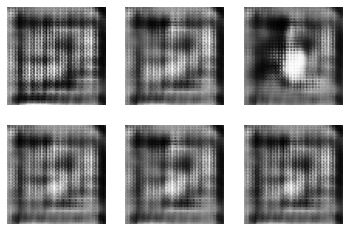

1401 [D loss: 0.672857, acc.: 57.03%] [G loss: 0.720487]
1402 [D loss: 0.693661, acc.: 34.38%] [G loss: 0.685794]
1403 [D loss: 0.701322, acc.: 32.03%] [G loss: 0.665938]
1404 [D loss: 0.698446, acc.: 37.89%] [G loss: 0.683546]
1405 [D loss: 0.699402, acc.: 47.27%] [G loss: 0.731843]
1406 [D loss: 0.654166, acc.: 57.81%] [G loss: 0.803632]
1407 [D loss: 0.623546, acc.: 77.34%] [G loss: 0.881511]
1408 [D loss: 0.597069, acc.: 75.78%] [G loss: 0.969885]
1409 [D loss: 0.582123, acc.: 76.56%] [G loss: 1.011212]
1410 [D loss: 0.591903, acc.: 74.22%] [G loss: 0.966184]
1411 [D loss: 0.606237, acc.: 77.73%] [G loss: 0.875189]
1412 [D loss: 0.653012, acc.: 76.56%] [G loss: 0.786778]
1413 [D loss: 0.669475, acc.: 55.08%] [G loss: 0.715538]
1414 [D loss: 0.709238, acc.: 26.17%] [G loss: 0.664849]
1415 [D loss: 0.716780, acc.: 28.91%] [G loss: 0.636821]
1416 [D loss: 0.748100, acc.: 26.56%] [G loss: 0.628129]
1417 [D loss: 0.722988, acc.: 28.91%] [G loss: 0.643874]
1418 [D loss: 0.736717, acc.: 2

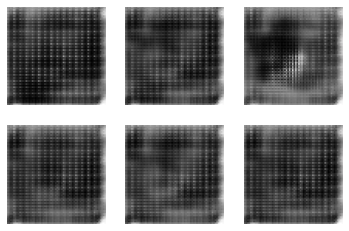

1451 [D loss: 0.693500, acc.: 58.59%] [G loss: 0.727832]
1452 [D loss: 0.690772, acc.: 64.45%] [G loss: 0.733134]
1453 [D loss: 0.681142, acc.: 66.41%] [G loss: 0.739007]
1454 [D loss: 0.685669, acc.: 62.50%] [G loss: 0.744734]
1455 [D loss: 0.683616, acc.: 65.23%] [G loss: 0.748146]
1456 [D loss: 0.679835, acc.: 67.19%] [G loss: 0.754211]
1457 [D loss: 0.682277, acc.: 63.67%] [G loss: 0.755970]
1458 [D loss: 0.679213, acc.: 62.50%] [G loss: 0.760190]
1459 [D loss: 0.670457, acc.: 67.19%] [G loss: 0.770328]
1460 [D loss: 0.671371, acc.: 67.58%] [G loss: 0.774965]
1461 [D loss: 0.669502, acc.: 69.14%] [G loss: 0.779201]
1462 [D loss: 0.664423, acc.: 67.97%] [G loss: 0.778602]
1463 [D loss: 0.664635, acc.: 67.19%] [G loss: 0.780911]
1464 [D loss: 0.670679, acc.: 63.28%] [G loss: 0.786986]
1465 [D loss: 0.667334, acc.: 67.19%] [G loss: 0.787130]
1466 [D loss: 0.667421, acc.: 64.84%] [G loss: 0.789182]
1467 [D loss: 0.662226, acc.: 70.70%] [G loss: 0.789115]
1468 [D loss: 0.669231, acc.: 6

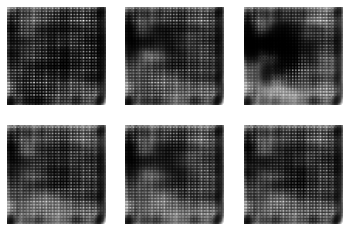

1501 [D loss: 0.696849, acc.: 56.64%] [G loss: 0.719964]
1502 [D loss: 0.693933, acc.: 50.39%] [G loss: 0.758417]
1503 [D loss: 0.653701, acc.: 55.08%] [G loss: 0.880670]
1504 [D loss: 0.646500, acc.: 60.16%] [G loss: 0.920722]
1505 [D loss: 0.667564, acc.: 59.77%] [G loss: 0.859207]
1506 [D loss: 0.718040, acc.: 41.80%] [G loss: 0.728434]
1507 [D loss: 0.730519, acc.: 28.52%] [G loss: 0.683183]
1508 [D loss: 0.755844, acc.: 18.36%] [G loss: 0.662926]
1509 [D loss: 0.750765, acc.: 18.36%] [G loss: 0.648592]
1510 [D loss: 0.749532, acc.: 19.14%] [G loss: 0.655213]
1511 [D loss: 0.737575, acc.: 25.00%] [G loss: 0.650669]
1512 [D loss: 0.736618, acc.: 20.31%] [G loss: 0.653160]
1513 [D loss: 0.736492, acc.: 20.70%] [G loss: 0.654062]
1514 [D loss: 0.730655, acc.: 19.92%] [G loss: 0.660972]
1515 [D loss: 0.727599, acc.: 22.66%] [G loss: 0.670563]
1516 [D loss: 0.724527, acc.: 19.53%] [G loss: 0.676057]
1517 [D loss: 0.714026, acc.: 21.48%] [G loss: 0.684142]
1518 [D loss: 0.709022, acc.: 2

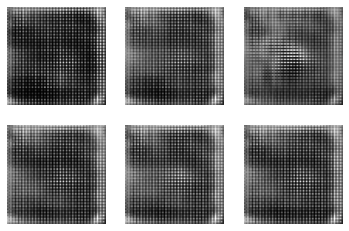

1551 [D loss: 0.708568, acc.: 27.73%] [G loss: 0.681204]
1552 [D loss: 0.700364, acc.: 28.52%] [G loss: 0.688694]
1553 [D loss: 0.702890, acc.: 24.61%] [G loss: 0.693450]
1554 [D loss: 0.686644, acc.: 29.69%] [G loss: 0.693149]
1555 [D loss: 0.709758, acc.: 23.83%] [G loss: 0.683961]
1556 [D loss: 0.711814, acc.: 24.22%] [G loss: 0.667935]
1557 [D loss: 0.731352, acc.: 20.70%] [G loss: 0.648962]
1558 [D loss: 0.740835, acc.: 21.88%] [G loss: 0.634521]
1559 [D loss: 0.738850, acc.: 24.61%] [G loss: 0.620393]
1560 [D loss: 0.756451, acc.: 21.48%] [G loss: 0.619297]
1561 [D loss: 0.741928, acc.: 26.17%] [G loss: 0.627596]
1562 [D loss: 0.738732, acc.: 26.95%] [G loss: 0.644909]
1563 [D loss: 0.725839, acc.: 21.48%] [G loss: 0.674592]
1564 [D loss: 0.705333, acc.: 23.83%] [G loss: 0.697353]
1565 [D loss: 0.702022, acc.: 25.78%] [G loss: 0.706563]
1566 [D loss: 0.701532, acc.: 26.17%] [G loss: 0.697421]
1567 [D loss: 0.707825, acc.: 26.17%] [G loss: 0.688627]
1568 [D loss: 0.708987, acc.: 2

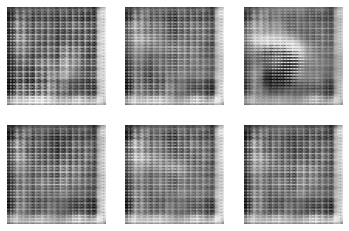

1601 [D loss: 0.731450, acc.: 26.56%] [G loss: 0.639612]
1602 [D loss: 0.751176, acc.: 24.61%] [G loss: 0.610036]
1603 [D loss: 0.771549, acc.: 28.12%] [G loss: 0.579160]
1604 [D loss: 0.785186, acc.: 28.52%] [G loss: 0.581972]
1605 [D loss: 0.758395, acc.: 26.95%] [G loss: 0.639757]
1606 [D loss: 0.717420, acc.: 25.78%] [G loss: 0.716225]
1607 [D loss: 0.680627, acc.: 62.89%] [G loss: 0.780569]
1608 [D loss: 0.657330, acc.: 77.34%] [G loss: 0.808683]
1609 [D loss: 0.668827, acc.: 67.58%] [G loss: 0.765390]
1610 [D loss: 0.682659, acc.: 58.20%] [G loss: 0.717874]
1611 [D loss: 0.690468, acc.: 41.41%] [G loss: 0.679134]
1612 [D loss: 0.728119, acc.: 30.86%] [G loss: 0.638020]
1613 [D loss: 0.753412, acc.: 26.95%] [G loss: 0.615774]
1614 [D loss: 0.748964, acc.: 30.86%] [G loss: 0.627321]
1615 [D loss: 0.734908, acc.: 37.50%] [G loss: 0.681004]
1616 [D loss: 0.696323, acc.: 53.12%] [G loss: 0.759854]
1617 [D loss: 0.653543, acc.: 51.56%] [G loss: 0.864271]
1618 [D loss: 0.631921, acc.: 6

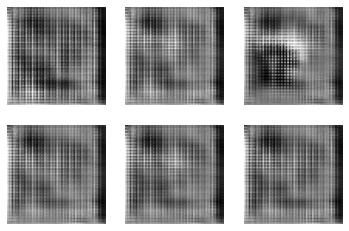

1651 [D loss: 0.667810, acc.: 74.61%] [G loss: 0.749749]
1652 [D loss: 0.678611, acc.: 69.53%] [G loss: 0.742897]
1653 [D loss: 0.689985, acc.: 35.94%] [G loss: 0.716900]
1654 [D loss: 0.722332, acc.: 22.66%] [G loss: 0.664710]
1655 [D loss: 0.754734, acc.: 23.05%] [G loss: 0.618539]
1656 [D loss: 0.767029, acc.: 23.05%] [G loss: 0.606745]
1657 [D loss: 0.764271, acc.: 23.05%] [G loss: 0.618918]
1658 [D loss: 0.745970, acc.: 23.44%] [G loss: 0.657946]
1659 [D loss: 0.706554, acc.: 28.52%] [G loss: 0.722245]
1660 [D loss: 0.675779, acc.: 74.22%] [G loss: 0.798189]
1661 [D loss: 0.631186, acc.: 79.69%] [G loss: 0.875012]
1662 [D loss: 0.609668, acc.: 78.52%] [G loss: 0.947720]
1663 [D loss: 0.603815, acc.: 77.34%] [G loss: 0.939717]
1664 [D loss: 0.623643, acc.: 78.91%] [G loss: 0.870830]
1665 [D loss: 0.648496, acc.: 86.72%] [G loss: 0.773018]
1666 [D loss: 0.669572, acc.: 78.91%] [G loss: 0.727760]
1667 [D loss: 0.680768, acc.: 49.61%] [G loss: 0.709548]
1668 [D loss: 0.685129, acc.: 3

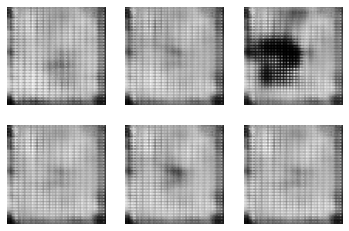

1701 [D loss: 0.624273, acc.: 80.86%] [G loss: 0.824144]
1702 [D loss: 0.615104, acc.: 82.42%] [G loss: 0.833602]
1703 [D loss: 0.609503, acc.: 82.03%] [G loss: 0.852329]
1704 [D loss: 0.605298, acc.: 81.64%] [G loss: 0.859830]
1705 [D loss: 0.594205, acc.: 84.77%] [G loss: 0.870182]
1706 [D loss: 0.590555, acc.: 85.94%] [G loss: 0.884313]
1707 [D loss: 0.589505, acc.: 84.38%] [G loss: 0.880392]
1708 [D loss: 0.587207, acc.: 85.16%] [G loss: 0.890829]
1709 [D loss: 0.582854, acc.: 87.89%] [G loss: 0.883548]
1710 [D loss: 0.581607, acc.: 87.89%] [G loss: 0.884851]
1711 [D loss: 0.586047, acc.: 89.84%] [G loss: 0.859210]
1712 [D loss: 0.595392, acc.: 90.23%] [G loss: 0.831490]
1713 [D loss: 0.618712, acc.: 84.77%] [G loss: 0.776341]
1714 [D loss: 0.673194, acc.: 42.58%] [G loss: 0.700137]
1715 [D loss: 0.706755, acc.: 36.72%] [G loss: 0.660710]
1716 [D loss: 0.698854, acc.: 37.50%] [G loss: 0.678629]
1717 [D loss: 0.679300, acc.: 45.31%] [G loss: 0.771666]
1718 [D loss: 0.610111, acc.: 8

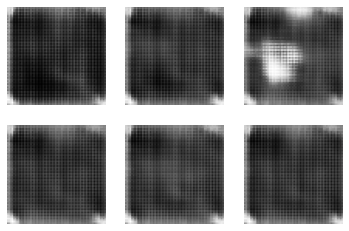

1751 [D loss: 0.866249, acc.: 24.22%] [G loss: 0.516983]
1752 [D loss: 0.872092, acc.: 29.30%] [G loss: 0.512249]
1753 [D loss: 0.852556, acc.: 24.61%] [G loss: 0.554769]
1754 [D loss: 0.811916, acc.: 19.92%] [G loss: 0.641280]
1755 [D loss: 0.745590, acc.: 44.14%] [G loss: 0.786123]
1756 [D loss: 0.669474, acc.: 47.66%] [G loss: 0.971144]
1757 [D loss: 0.631367, acc.: 62.89%] [G loss: 1.108072]
1758 [D loss: 0.614703, acc.: 64.45%] [G loss: 1.143845]
1759 [D loss: 0.619358, acc.: 59.77%] [G loss: 1.116201]
1760 [D loss: 0.702760, acc.: 58.98%] [G loss: 0.843620]
1761 [D loss: 0.781414, acc.: 9.77%] [G loss: 0.669204]
1762 [D loss: 0.778641, acc.: 10.94%] [G loss: 0.656310]
1763 [D loss: 0.750391, acc.: 15.23%] [G loss: 0.681591]
1764 [D loss: 0.729134, acc.: 19.14%] [G loss: 0.704790]
1765 [D loss: 0.704710, acc.: 51.17%] [G loss: 0.729072]
1766 [D loss: 0.700460, acc.: 64.84%] [G loss: 0.752921]
1767 [D loss: 0.687641, acc.: 67.58%] [G loss: 0.768144]
1768 [D loss: 0.668538, acc.: 70

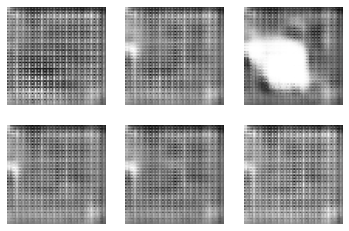

1801 [D loss: 0.673854, acc.: 67.97%] [G loss: 0.755316]
1802 [D loss: 0.678631, acc.: 49.61%] [G loss: 0.733816]
1803 [D loss: 0.707504, acc.: 31.25%] [G loss: 0.695651]
1804 [D loss: 0.746361, acc.: 23.83%] [G loss: 0.651040]
1805 [D loss: 0.793644, acc.: 23.44%] [G loss: 0.595037]
1806 [D loss: 0.829057, acc.: 23.05%] [G loss: 0.543082]
1807 [D loss: 0.869447, acc.: 17.58%] [G loss: 0.526393]
1808 [D loss: 0.848913, acc.: 24.22%] [G loss: 0.557547]
1809 [D loss: 0.775762, acc.: 28.12%] [G loss: 0.645787]
1810 [D loss: 0.709877, acc.: 29.30%] [G loss: 0.785638]
1811 [D loss: 0.611498, acc.: 83.59%] [G loss: 0.976964]
1812 [D loss: 0.557482, acc.: 84.38%] [G loss: 1.161792]
1813 [D loss: 0.522620, acc.: 87.11%] [G loss: 1.238796]
1814 [D loss: 0.518837, acc.: 91.02%] [G loss: 1.201866]
1815 [D loss: 0.540083, acc.: 89.84%] [G loss: 1.104390]
1816 [D loss: 0.593095, acc.: 85.16%] [G loss: 0.970324]
1817 [D loss: 0.638479, acc.: 75.39%] [G loss: 0.803768]
1818 [D loss: 0.695566, acc.: 3

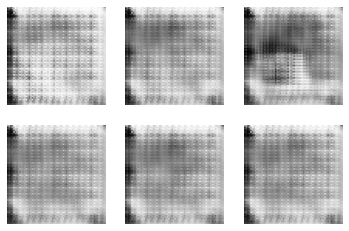

1851 [D loss: 0.661036, acc.: 67.58%] [G loss: 0.816002]
1852 [D loss: 0.678790, acc.: 54.69%] [G loss: 0.766479]
1853 [D loss: 0.690120, acc.: 38.28%] [G loss: 0.733195]
1854 [D loss: 0.697779, acc.: 30.47%] [G loss: 0.714300]
1855 [D loss: 0.717358, acc.: 26.17%] [G loss: 0.698797]
1856 [D loss: 0.723172, acc.: 29.69%] [G loss: 0.673042]
1857 [D loss: 0.731447, acc.: 32.42%] [G loss: 0.643742]
1858 [D loss: 0.765348, acc.: 24.61%] [G loss: 0.635145]
1859 [D loss: 0.760596, acc.: 22.27%] [G loss: 0.636505]
1860 [D loss: 0.754734, acc.: 23.44%] [G loss: 0.656858]
1861 [D loss: 0.747047, acc.: 18.36%] [G loss: 0.692185]
1862 [D loss: 0.720894, acc.: 44.53%] [G loss: 0.762273]
1863 [D loss: 0.677215, acc.: 52.73%] [G loss: 0.830609]
1864 [D loss: 0.652491, acc.: 66.02%] [G loss: 0.937943]
1865 [D loss: 0.623608, acc.: 66.41%] [G loss: 1.022607]
1866 [D loss: 0.614911, acc.: 64.45%] [G loss: 1.051971]
1867 [D loss: 0.608304, acc.: 64.45%] [G loss: 1.066963]
1868 [D loss: 0.612446, acc.: 6

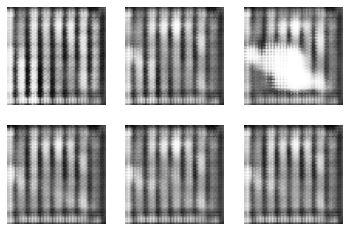

1901 [D loss: 0.691938, acc.: 39.45%] [G loss: 0.670678]
1902 [D loss: 0.711596, acc.: 32.42%] [G loss: 0.664342]
1903 [D loss: 0.707285, acc.: 34.38%] [G loss: 0.678692]
1904 [D loss: 0.714220, acc.: 32.81%] [G loss: 0.701906]
1905 [D loss: 0.707391, acc.: 32.42%] [G loss: 0.735099]
1906 [D loss: 0.688463, acc.: 40.62%] [G loss: 0.769075]
1907 [D loss: 0.692044, acc.: 53.91%] [G loss: 0.773128]
1908 [D loss: 0.697433, acc.: 51.56%] [G loss: 0.776252]
1909 [D loss: 0.696389, acc.: 55.47%] [G loss: 0.762202]
1910 [D loss: 0.692179, acc.: 53.12%] [G loss: 0.767355]
1911 [D loss: 0.702691, acc.: 51.95%] [G loss: 0.780394]
1912 [D loss: 0.693976, acc.: 51.17%] [G loss: 0.786922]
1913 [D loss: 0.688740, acc.: 50.39%] [G loss: 0.813490]
1914 [D loss: 0.682840, acc.: 50.78%] [G loss: 0.866404]
1915 [D loss: 0.665309, acc.: 49.22%] [G loss: 0.905484]
1916 [D loss: 0.634734, acc.: 67.58%] [G loss: 1.007384]
1917 [D loss: 0.619147, acc.: 67.97%] [G loss: 1.040267]
1918 [D loss: 0.599066, acc.: 7

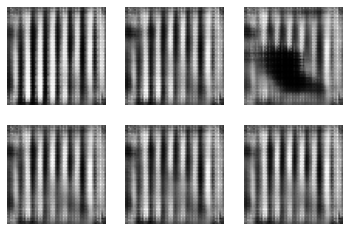

1951 [D loss: 0.781301, acc.: 28.52%] [G loss: 0.576653]
1952 [D loss: 0.788460, acc.: 30.86%] [G loss: 0.567452]
1953 [D loss: 0.773544, acc.: 29.69%] [G loss: 0.575977]
1954 [D loss: 0.768537, acc.: 28.12%] [G loss: 0.584014]
1955 [D loss: 0.763837, acc.: 30.86%] [G loss: 0.597014]
1956 [D loss: 0.762830, acc.: 26.17%] [G loss: 0.608083]
1957 [D loss: 0.757428, acc.: 28.91%] [G loss: 0.619690]
1958 [D loss: 0.739738, acc.: 30.47%] [G loss: 0.634427]
1959 [D loss: 0.734731, acc.: 29.30%] [G loss: 0.651043]
1960 [D loss: 0.720231, acc.: 30.86%] [G loss: 0.670158]
1961 [D loss: 0.720488, acc.: 25.00%] [G loss: 0.690880]
1962 [D loss: 0.715082, acc.: 44.92%] [G loss: 0.700958]
1963 [D loss: 0.701609, acc.: 51.17%] [G loss: 0.720365]
1964 [D loss: 0.695282, acc.: 50.78%] [G loss: 0.740518]
1965 [D loss: 0.696145, acc.: 50.39%] [G loss: 0.753785]
1966 [D loss: 0.671676, acc.: 69.92%] [G loss: 0.774732]
1967 [D loss: 0.675712, acc.: 72.27%] [G loss: 0.788881]
1968 [D loss: 0.658086, acc.: 7

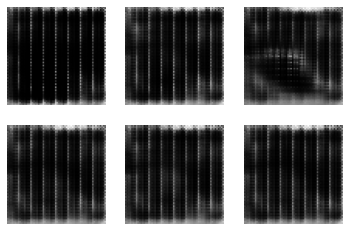

2001 [D loss: 0.944327, acc.: 15.23%] [G loss: 0.497337]
2002 [D loss: 0.879028, acc.: 11.72%] [G loss: 0.592973]
2003 [D loss: 0.792426, acc.: 8.20%] [G loss: 0.745671]
2004 [D loss: 0.716397, acc.: 31.25%] [G loss: 0.904001]
2005 [D loss: 0.642651, acc.: 56.64%] [G loss: 1.108267]
2006 [D loss: 0.595544, acc.: 54.30%] [G loss: 1.328412]
2007 [D loss: 0.549934, acc.: 57.03%] [G loss: 1.513990]
2008 [D loss: 0.533460, acc.: 58.98%] [G loss: 1.585367]
2009 [D loss: 0.559355, acc.: 60.55%] [G loss: 1.431963]
2010 [D loss: 0.614550, acc.: 63.67%] [G loss: 1.094857]
2011 [D loss: 0.674304, acc.: 64.45%] [G loss: 0.891128]
2012 [D loss: 0.713545, acc.: 66.02%] [G loss: 0.768794]
2013 [D loss: 0.724219, acc.: 47.27%] [G loss: 0.717210]
2014 [D loss: 0.730638, acc.: 21.88%] [G loss: 0.695973]
2015 [D loss: 0.722738, acc.: 23.05%] [G loss: 0.683295]
2016 [D loss: 0.720722, acc.: 22.27%] [G loss: 0.680909]
2017 [D loss: 0.705341, acc.: 27.34%] [G loss: 0.683037]
2018 [D loss: 0.707300, acc.: 27

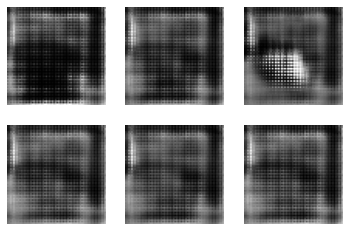

2051 [D loss: 0.743581, acc.: 31.25%] [G loss: 0.621753]
2052 [D loss: 0.741664, acc.: 28.52%] [G loss: 0.675135]
2053 [D loss: 0.690063, acc.: 45.31%] [G loss: 0.768949]
2054 [D loss: 0.651407, acc.: 66.02%] [G loss: 0.878975]
2055 [D loss: 0.622879, acc.: 74.61%] [G loss: 0.973256]
2056 [D loss: 0.595902, acc.: 74.61%] [G loss: 1.054259]
2057 [D loss: 0.607925, acc.: 72.27%] [G loss: 1.022556]
2058 [D loss: 0.640335, acc.: 70.70%] [G loss: 0.907224]
2059 [D loss: 0.672367, acc.: 69.92%] [G loss: 0.814506]
2060 [D loss: 0.674359, acc.: 72.27%] [G loss: 0.785732]
2061 [D loss: 0.678101, acc.: 71.09%] [G loss: 0.782737]
2062 [D loss: 0.652616, acc.: 75.78%] [G loss: 0.794814]
2063 [D loss: 0.643755, acc.: 78.91%] [G loss: 0.805496]
2064 [D loss: 0.636893, acc.: 78.91%] [G loss: 0.816576]
2065 [D loss: 0.633332, acc.: 78.52%] [G loss: 0.825284]
2066 [D loss: 0.621809, acc.: 86.72%] [G loss: 0.835068]
2067 [D loss: 0.613336, acc.: 83.98%] [G loss: 0.849300]
2068 [D loss: 0.611516, acc.: 8

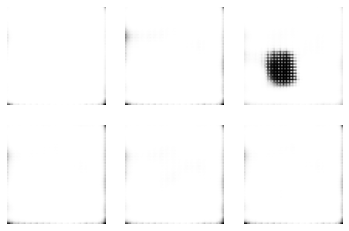

2101 [D loss: 0.415188, acc.: 80.47%] [G loss: 2.085903]
2102 [D loss: 0.373228, acc.: 85.55%] [G loss: 2.236385]
2103 [D loss: 0.361050, acc.: 83.59%] [G loss: 2.312756]
2104 [D loss: 0.320485, acc.: 89.84%] [G loss: 2.437621]
2105 [D loss: 0.300019, acc.: 92.58%] [G loss: 2.491729]
2106 [D loss: 0.266473, acc.: 95.70%] [G loss: 2.538158]
2107 [D loss: 0.253698, acc.: 96.48%] [G loss: 2.641080]
2108 [D loss: 0.232670, acc.: 97.66%] [G loss: 2.772375]
2109 [D loss: 0.220482, acc.: 96.88%] [G loss: 2.810018]
2110 [D loss: 0.191947, acc.: 97.27%] [G loss: 2.814824]
2111 [D loss: 0.164967, acc.: 99.22%] [G loss: 2.906799]
2112 [D loss: 0.161844, acc.: 98.44%] [G loss: 2.899751]
2113 [D loss: 0.137506, acc.: 99.61%] [G loss: 2.957061]
2114 [D loss: 0.144490, acc.: 98.83%] [G loss: 3.060426]
2115 [D loss: 0.126316, acc.: 98.83%] [G loss: 3.167341]
2116 [D loss: 0.096650, acc.: 99.61%] [G loss: 3.117080]
2117 [D loss: 0.100460, acc.: 99.22%] [G loss: 3.158582]
2118 [D loss: 0.109856, acc.: 9

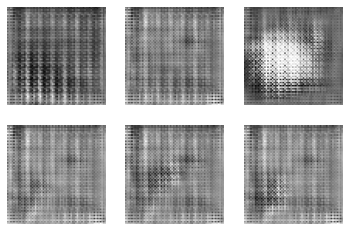

2151 [D loss: 0.805978, acc.: 34.38%] [G loss: 0.505374]
2152 [D loss: 0.800187, acc.: 35.55%] [G loss: 0.523574]
2153 [D loss: 0.773530, acc.: 33.98%] [G loss: 0.544903]
2154 [D loss: 0.768760, acc.: 33.98%] [G loss: 0.560358]
2155 [D loss: 0.744700, acc.: 35.55%] [G loss: 0.575916]
2156 [D loss: 0.738193, acc.: 37.50%] [G loss: 0.584205]
2157 [D loss: 0.717685, acc.: 37.89%] [G loss: 0.596825]
2158 [D loss: 0.713857, acc.: 37.11%] [G loss: 0.609182]
2159 [D loss: 0.705560, acc.: 41.41%] [G loss: 0.613327]
2160 [D loss: 0.714130, acc.: 36.33%] [G loss: 0.626950]
2161 [D loss: 0.707187, acc.: 37.50%] [G loss: 0.634446]
2162 [D loss: 0.705678, acc.: 35.94%] [G loss: 0.650621]
2163 [D loss: 0.691895, acc.: 38.28%] [G loss: 0.663920]
2164 [D loss: 0.696165, acc.: 38.67%] [G loss: 0.681893]
2165 [D loss: 0.680245, acc.: 44.14%] [G loss: 0.697797]
2166 [D loss: 0.670731, acc.: 59.77%] [G loss: 0.715866]
2167 [D loss: 0.664114, acc.: 67.19%] [G loss: 0.737450]
2168 [D loss: 0.660266, acc.: 6

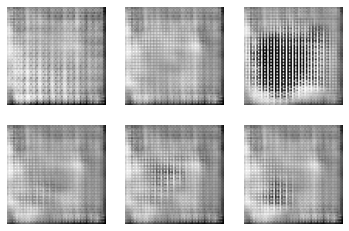

2201 [D loss: 0.660019, acc.: 58.98%] [G loss: 0.745921]
2202 [D loss: 0.653044, acc.: 53.91%] [G loss: 0.741608]
2203 [D loss: 0.671602, acc.: 44.14%] [G loss: 0.726977]
2204 [D loss: 0.669468, acc.: 43.75%] [G loss: 0.722538]
2205 [D loss: 0.671930, acc.: 41.41%] [G loss: 0.716565]
2206 [D loss: 0.684045, acc.: 40.62%] [G loss: 0.720628]
2207 [D loss: 0.681439, acc.: 39.84%] [G loss: 0.720912]
2208 [D loss: 0.662009, acc.: 51.95%] [G loss: 0.725945]
2209 [D loss: 0.699340, acc.: 45.31%] [G loss: 0.720905]
2210 [D loss: 0.697824, acc.: 50.78%] [G loss: 0.735000]
2211 [D loss: 0.686882, acc.: 53.12%] [G loss: 0.729274]
2212 [D loss: 0.680227, acc.: 46.48%] [G loss: 0.718804]
2213 [D loss: 0.722035, acc.: 37.11%] [G loss: 0.693611]
2214 [D loss: 0.728290, acc.: 33.20%] [G loss: 0.689866]
2215 [D loss: 0.729847, acc.: 37.50%] [G loss: 0.700751]
2216 [D loss: 0.736703, acc.: 41.02%] [G loss: 0.690569]
2217 [D loss: 0.752594, acc.: 35.16%] [G loss: 0.689623]
2218 [D loss: 0.749833, acc.: 3

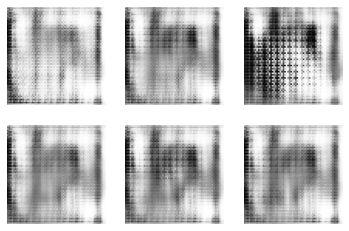

2251 [D loss: 0.607239, acc.: 80.08%] [G loss: 0.927263]
2252 [D loss: 0.598060, acc.: 80.47%] [G loss: 0.929690]
2253 [D loss: 0.624624, acc.: 79.30%] [G loss: 0.907321]
2254 [D loss: 0.615966, acc.: 82.42%] [G loss: 0.863349]
2255 [D loss: 0.640454, acc.: 82.03%] [G loss: 0.806589]
2256 [D loss: 0.646796, acc.: 78.91%] [G loss: 0.775126]
2257 [D loss: 0.678739, acc.: 70.31%] [G loss: 0.756557]
2258 [D loss: 0.666536, acc.: 70.70%] [G loss: 0.755627]
2259 [D loss: 0.655456, acc.: 77.34%] [G loss: 0.757270]
2260 [D loss: 0.634980, acc.: 82.42%] [G loss: 0.757783]
2261 [D loss: 0.649598, acc.: 80.08%] [G loss: 0.759348]
2262 [D loss: 0.668745, acc.: 71.09%] [G loss: 0.754983]
2263 [D loss: 0.663074, acc.: 60.55%] [G loss: 0.751250]
2264 [D loss: 0.671531, acc.: 60.94%] [G loss: 0.746236]
2265 [D loss: 0.659667, acc.: 62.89%] [G loss: 0.757965]
2266 [D loss: 0.680645, acc.: 51.56%] [G loss: 0.759199]
2267 [D loss: 0.666131, acc.: 57.81%] [G loss: 0.792027]
2268 [D loss: 0.653819, acc.: 6

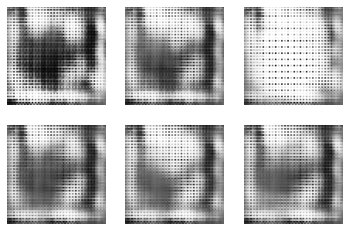

2301 [D loss: 0.699879, acc.: 41.80%] [G loss: 0.696799]
2302 [D loss: 0.708627, acc.: 38.28%] [G loss: 0.677773]
2303 [D loss: 0.717913, acc.: 40.23%] [G loss: 0.653889]
2304 [D loss: 0.720108, acc.: 39.45%] [G loss: 0.650392]
2305 [D loss: 0.737653, acc.: 35.55%] [G loss: 0.623148]
2306 [D loss: 0.742610, acc.: 33.20%] [G loss: 0.607189]
2307 [D loss: 0.747967, acc.: 34.77%] [G loss: 0.599234]
2308 [D loss: 0.739843, acc.: 34.38%] [G loss: 0.612607]
2309 [D loss: 0.750842, acc.: 29.30%] [G loss: 0.618265]
2310 [D loss: 0.741174, acc.: 29.69%] [G loss: 0.632785]
2311 [D loss: 0.729405, acc.: 31.25%] [G loss: 0.649478]
2312 [D loss: 0.710881, acc.: 30.86%] [G loss: 0.674779]
2313 [D loss: 0.720678, acc.: 24.22%] [G loss: 0.689807]
2314 [D loss: 0.709565, acc.: 30.86%] [G loss: 0.705863]
2315 [D loss: 0.692334, acc.: 37.50%] [G loss: 0.717571]
2316 [D loss: 0.687158, acc.: 56.64%] [G loss: 0.729919]
2317 [D loss: 0.680308, acc.: 68.36%] [G loss: 0.738330]
2318 [D loss: 0.671135, acc.: 7

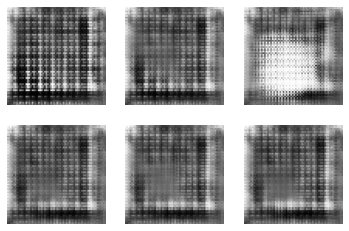

2351 [D loss: 0.622665, acc.: 80.08%] [G loss: 0.799229]
2352 [D loss: 0.631207, acc.: 77.73%] [G loss: 0.789368]
2353 [D loss: 0.645093, acc.: 73.83%] [G loss: 0.784600]
2354 [D loss: 0.654216, acc.: 73.05%] [G loss: 0.765940]
2355 [D loss: 0.644157, acc.: 66.41%] [G loss: 0.756193]
2356 [D loss: 0.661020, acc.: 60.16%] [G loss: 0.744361]
2357 [D loss: 0.677697, acc.: 46.09%] [G loss: 0.727714]
2358 [D loss: 0.696327, acc.: 38.67%] [G loss: 0.713509]
2359 [D loss: 0.669649, acc.: 48.05%] [G loss: 0.724467]
2360 [D loss: 0.676197, acc.: 44.14%] [G loss: 0.717280]
2361 [D loss: 0.674782, acc.: 40.23%] [G loss: 0.723013]
2362 [D loss: 0.687075, acc.: 35.94%] [G loss: 0.715270]
2363 [D loss: 0.685250, acc.: 36.33%] [G loss: 0.711653]
2364 [D loss: 0.682456, acc.: 35.94%] [G loss: 0.683507]
2365 [D loss: 0.721468, acc.: 27.73%] [G loss: 0.669490]
2366 [D loss: 0.707951, acc.: 35.55%] [G loss: 0.640061]
2367 [D loss: 0.763753, acc.: 29.69%] [G loss: 0.600002]
2368 [D loss: 0.793629, acc.: 2

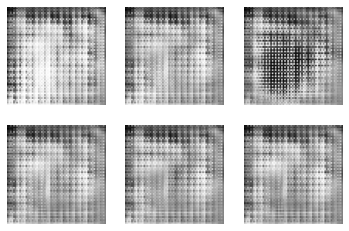

2401 [D loss: 0.699581, acc.: 40.23%] [G loss: 0.677388]
2402 [D loss: 0.715354, acc.: 39.45%] [G loss: 0.680161]
2403 [D loss: 0.702749, acc.: 51.56%] [G loss: 0.723105]
2404 [D loss: 0.692627, acc.: 53.91%] [G loss: 0.750137]
2405 [D loss: 0.679876, acc.: 54.30%] [G loss: 0.760806]
2406 [D loss: 0.670230, acc.: 58.59%] [G loss: 0.772262]
2407 [D loss: 0.677828, acc.: 55.47%] [G loss: 0.757351]
2408 [D loss: 0.665863, acc.: 60.55%] [G loss: 0.749858]
2409 [D loss: 0.689995, acc.: 48.44%] [G loss: 0.738747]
2410 [D loss: 0.680277, acc.: 54.69%] [G loss: 0.741923]
2411 [D loss: 0.685741, acc.: 53.12%] [G loss: 0.738955]
2412 [D loss: 0.677857, acc.: 55.86%] [G loss: 0.738652]
2413 [D loss: 0.678005, acc.: 49.61%] [G loss: 0.734889]
2414 [D loss: 0.696827, acc.: 44.92%] [G loss: 0.734682]
2415 [D loss: 0.694291, acc.: 44.14%] [G loss: 0.731763]
2416 [D loss: 0.671357, acc.: 53.91%] [G loss: 0.746146]
2417 [D loss: 0.688473, acc.: 46.48%] [G loss: 0.743790]
2418 [D loss: 0.654800, acc.: 6

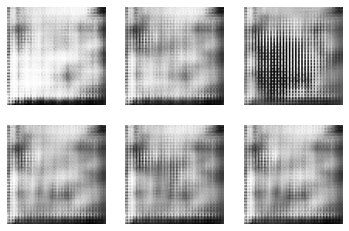

2451 [D loss: 0.621785, acc.: 83.98%] [G loss: 0.870418]
2452 [D loss: 0.613044, acc.: 85.16%] [G loss: 0.860320]
2453 [D loss: 0.626090, acc.: 85.16%] [G loss: 0.826324]
2454 [D loss: 0.627450, acc.: 88.67%] [G loss: 0.811105]
2455 [D loss: 0.632760, acc.: 83.20%] [G loss: 0.807027]
2456 [D loss: 0.626588, acc.: 87.11%] [G loss: 0.812530]
2457 [D loss: 0.620285, acc.: 87.11%] [G loss: 0.816706]
2458 [D loss: 0.632280, acc.: 81.25%] [G loss: 0.823803]
2459 [D loss: 0.624043, acc.: 83.20%] [G loss: 0.835521]
2460 [D loss: 0.621163, acc.: 83.20%] [G loss: 0.835657]
2461 [D loss: 0.627656, acc.: 80.08%] [G loss: 0.829809]
2462 [D loss: 0.645041, acc.: 76.17%] [G loss: 0.796669]
2463 [D loss: 0.661200, acc.: 73.05%] [G loss: 0.769453]
2464 [D loss: 0.682039, acc.: 44.92%] [G loss: 0.729035]
2465 [D loss: 0.702985, acc.: 29.30%] [G loss: 0.700369]
2466 [D loss: 0.721209, acc.: 22.27%] [G loss: 0.720148]
2467 [D loss: 0.671696, acc.: 47.27%] [G loss: 0.770606]
2468 [D loss: 0.665541, acc.: 7

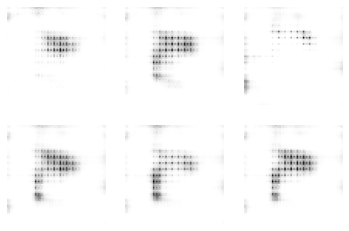

2501 [D loss: 0.314509, acc.: 89.45%] [G loss: 2.596671]
2502 [D loss: 0.292513, acc.: 92.58%] [G loss: 2.679151]
2503 [D loss: 0.265926, acc.: 91.41%] [G loss: 2.647087]
2504 [D loss: 0.253610, acc.: 95.70%] [G loss: 2.557087]
2505 [D loss: 0.228857, acc.: 96.48%] [G loss: 2.456325]
2506 [D loss: 0.218536, acc.: 97.66%] [G loss: 2.332985]
2507 [D loss: 0.228036, acc.: 97.66%] [G loss: 2.182476]
2508 [D loss: 0.275043, acc.: 94.92%] [G loss: 1.715688]
2509 [D loss: 0.347206, acc.: 98.44%] [G loss: 1.311234]
2510 [D loss: 0.507603, acc.: 51.56%] [G loss: 0.868819]
2511 [D loss: 0.786830, acc.: 44.92%] [G loss: 0.548383]
2512 [D loss: 0.889425, acc.: 41.80%] [G loss: 0.432929]
2513 [D loss: 0.953863, acc.: 35.16%] [G loss: 0.445227]
2514 [D loss: 0.887976, acc.: 35.94%] [G loss: 0.530195]
2515 [D loss: 0.822476, acc.: 33.20%] [G loss: 0.636804]
2516 [D loss: 0.774919, acc.: 32.81%] [G loss: 0.687955]
2517 [D loss: 0.798353, acc.: 29.30%] [G loss: 0.664885]
2518 [D loss: 0.835061, acc.: 2

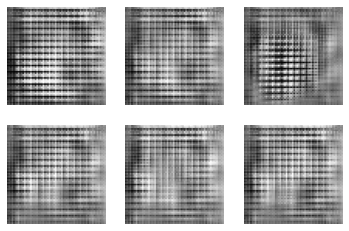

2551 [D loss: 0.644655, acc.: 60.55%] [G loss: 0.723224]
2552 [D loss: 0.662266, acc.: 48.05%] [G loss: 0.700314]
2553 [D loss: 0.701503, acc.: 34.38%] [G loss: 0.652009]
2554 [D loss: 0.755621, acc.: 33.59%] [G loss: 0.586560]
2555 [D loss: 0.821986, acc.: 29.30%] [G loss: 0.553748]
2556 [D loss: 0.848481, acc.: 28.52%] [G loss: 0.554213]
2557 [D loss: 0.803521, acc.: 26.17%] [G loss: 0.640390]
2558 [D loss: 0.735051, acc.: 44.92%] [G loss: 0.786456]
2559 [D loss: 0.667178, acc.: 49.22%] [G loss: 0.971617]
2560 [D loss: 0.625081, acc.: 58.59%] [G loss: 1.118026]
2561 [D loss: 0.579626, acc.: 69.53%] [G loss: 1.268316]
2562 [D loss: 0.561959, acc.: 68.75%] [G loss: 1.341838]
2563 [D loss: 0.550079, acc.: 67.19%] [G loss: 1.382817]
2564 [D loss: 0.575919, acc.: 66.80%] [G loss: 1.299142]
2565 [D loss: 0.584654, acc.: 71.48%] [G loss: 1.166857]
2566 [D loss: 0.597907, acc.: 70.70%] [G loss: 1.027044]
2567 [D loss: 0.608551, acc.: 73.44%] [G loss: 0.944273]
2568 [D loss: 0.636317, acc.: 7

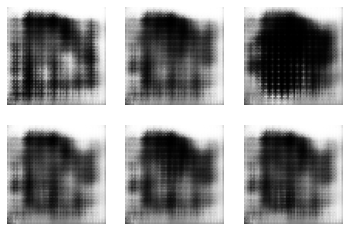

2601 [D loss: 0.894789, acc.: 14.45%] [G loss: 0.623144]
2602 [D loss: 0.857634, acc.: 16.41%] [G loss: 0.687961]
2603 [D loss: 0.801401, acc.: 15.23%] [G loss: 0.802123]
2604 [D loss: 0.739199, acc.: 59.38%] [G loss: 0.967332]
2605 [D loss: 0.672493, acc.: 61.33%] [G loss: 1.115038]
2606 [D loss: 0.624961, acc.: 65.62%] [G loss: 1.171201]
2607 [D loss: 0.644872, acc.: 67.58%] [G loss: 1.148157]
2608 [D loss: 0.682184, acc.: 63.28%] [G loss: 0.943790]
2609 [D loss: 0.733190, acc.: 50.00%] [G loss: 0.774257]
2610 [D loss: 0.766129, acc.: 28.12%] [G loss: 0.715412]
2611 [D loss: 0.761330, acc.: 24.22%] [G loss: 0.689611]
2612 [D loss: 0.774002, acc.: 23.05%] [G loss: 0.680412]
2613 [D loss: 0.760663, acc.: 24.61%] [G loss: 0.689503]
2614 [D loss: 0.759836, acc.: 18.36%] [G loss: 0.699288]
2615 [D loss: 0.759838, acc.: 19.92%] [G loss: 0.698828]
2616 [D loss: 0.735866, acc.: 29.30%] [G loss: 0.710089]
2617 [D loss: 0.745397, acc.: 32.81%] [G loss: 0.716291]
2618 [D loss: 0.718416, acc.: 4

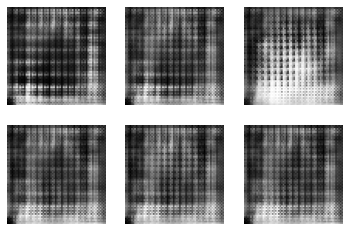

2651 [D loss: 0.661438, acc.: 65.62%] [G loss: 0.740455]
2652 [D loss: 0.675732, acc.: 57.03%] [G loss: 0.720574]
2653 [D loss: 0.692050, acc.: 42.58%] [G loss: 0.698491]
2654 [D loss: 0.716157, acc.: 33.98%] [G loss: 0.677707]
2655 [D loss: 0.734036, acc.: 28.91%] [G loss: 0.665404]
2656 [D loss: 0.745781, acc.: 31.25%] [G loss: 0.645563]
2657 [D loss: 0.762555, acc.: 27.73%] [G loss: 0.632176]
2658 [D loss: 0.745978, acc.: 26.95%] [G loss: 0.664186]
2659 [D loss: 0.733517, acc.: 25.39%] [G loss: 0.701989]
2660 [D loss: 0.705021, acc.: 32.81%] [G loss: 0.752486]
2661 [D loss: 0.698367, acc.: 57.42%] [G loss: 0.787983]
2662 [D loss: 0.694192, acc.: 64.84%] [G loss: 0.803519]
2663 [D loss: 0.701578, acc.: 50.39%] [G loss: 0.767655]
2664 [D loss: 0.728283, acc.: 23.05%] [G loss: 0.717716]
2665 [D loss: 0.739706, acc.: 26.95%] [G loss: 0.696209]
2666 [D loss: 0.749662, acc.: 23.44%] [G loss: 0.701927]
2667 [D loss: 0.758923, acc.: 25.39%] [G loss: 0.686139]
2668 [D loss: 0.765435, acc.: 2

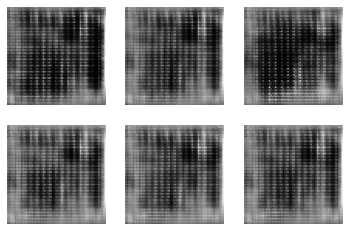

2701 [D loss: 0.648194, acc.: 73.83%] [G loss: 0.810545]
2702 [D loss: 0.624088, acc.: 78.91%] [G loss: 0.808401]
2703 [D loss: 0.636198, acc.: 78.12%] [G loss: 0.810794]
2704 [D loss: 0.620762, acc.: 83.59%] [G loss: 0.805004]
2705 [D loss: 0.631700, acc.: 76.95%] [G loss: 0.805300]
2706 [D loss: 0.609486, acc.: 81.64%] [G loss: 0.802693]
2707 [D loss: 0.632832, acc.: 80.08%] [G loss: 0.788866]
2708 [D loss: 0.611728, acc.: 83.20%] [G loss: 0.778327]
2709 [D loss: 0.632206, acc.: 75.00%] [G loss: 0.767444]
2710 [D loss: 0.642828, acc.: 62.11%] [G loss: 0.743152]
2711 [D loss: 0.657712, acc.: 49.22%] [G loss: 0.715025]
2712 [D loss: 0.669813, acc.: 39.45%] [G loss: 0.680351]
2713 [D loss: 0.696405, acc.: 35.55%] [G loss: 0.648294]
2714 [D loss: 0.726675, acc.: 37.11%] [G loss: 0.620900]
2715 [D loss: 0.746523, acc.: 36.33%] [G loss: 0.616783]
2716 [D loss: 0.767553, acc.: 28.12%] [G loss: 0.640265]
2717 [D loss: 0.734835, acc.: 26.17%] [G loss: 0.689964]
2718 [D loss: 0.720514, acc.: 2

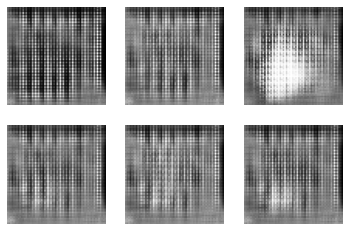

2751 [D loss: 0.790699, acc.: 21.88%] [G loss: 0.630732]
2752 [D loss: 0.785503, acc.: 23.44%] [G loss: 0.645386]
2753 [D loss: 0.761368, acc.: 27.73%] [G loss: 0.652356]
2754 [D loss: 0.773062, acc.: 22.66%] [G loss: 0.657512]
2755 [D loss: 0.760048, acc.: 26.17%] [G loss: 0.663335]
2756 [D loss: 0.749734, acc.: 21.09%] [G loss: 0.665042]
2757 [D loss: 0.742797, acc.: 24.22%] [G loss: 0.676213]
2758 [D loss: 0.740199, acc.: 25.00%] [G loss: 0.676288]
2759 [D loss: 0.741575, acc.: 25.00%] [G loss: 0.678804]
2760 [D loss: 0.743490, acc.: 23.05%] [G loss: 0.680290]
2761 [D loss: 0.729767, acc.: 27.34%] [G loss: 0.680181]
2762 [D loss: 0.734649, acc.: 25.39%] [G loss: 0.688803]
2763 [D loss: 0.719249, acc.: 35.55%] [G loss: 0.701085]
2764 [D loss: 0.718204, acc.: 39.06%] [G loss: 0.717469]
2765 [D loss: 0.697673, acc.: 43.75%] [G loss: 0.742827]
2766 [D loss: 0.685487, acc.: 53.91%] [G loss: 0.773143]
2767 [D loss: 0.661227, acc.: 70.70%] [G loss: 0.812675]
2768 [D loss: 0.667478, acc.: 6

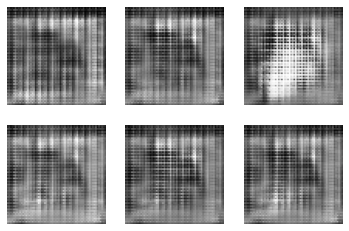

2801 [D loss: 0.647057, acc.: 75.00%] [G loss: 0.816689]
2802 [D loss: 0.638152, acc.: 75.78%] [G loss: 0.819040]
2803 [D loss: 0.635403, acc.: 75.78%] [G loss: 0.824834]
2804 [D loss: 0.624700, acc.: 75.78%] [G loss: 0.821504]
2805 [D loss: 0.630634, acc.: 76.56%] [G loss: 0.822510]
2806 [D loss: 0.619253, acc.: 79.30%] [G loss: 0.820395]
2807 [D loss: 0.618393, acc.: 79.69%] [G loss: 0.822725]
2808 [D loss: 0.620461, acc.: 81.25%] [G loss: 0.815671]
2809 [D loss: 0.618609, acc.: 79.30%] [G loss: 0.822647]
2810 [D loss: 0.611729, acc.: 76.56%] [G loss: 0.814052]
2811 [D loss: 0.616266, acc.: 78.12%] [G loss: 0.819473]
2812 [D loss: 0.617072, acc.: 76.56%] [G loss: 0.815663]
2813 [D loss: 0.615989, acc.: 77.73%] [G loss: 0.821316]
2814 [D loss: 0.626494, acc.: 80.86%] [G loss: 0.833588]
2815 [D loss: 0.600721, acc.: 79.30%] [G loss: 0.847656]
2816 [D loss: 0.599859, acc.: 79.30%] [G loss: 0.861169]
2817 [D loss: 0.584336, acc.: 84.77%] [G loss: 0.886224]
2818 [D loss: 0.574828, acc.: 8

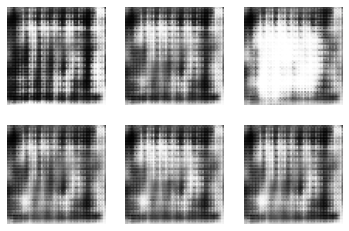

2851 [D loss: 0.715894, acc.: 32.81%] [G loss: 0.752176]
2852 [D loss: 0.726587, acc.: 27.73%] [G loss: 0.741853]
2853 [D loss: 0.714905, acc.: 36.33%] [G loss: 0.744066]
2854 [D loss: 0.706070, acc.: 37.50%] [G loss: 0.747075]
2855 [D loss: 0.694727, acc.: 46.88%] [G loss: 0.769788]
2856 [D loss: 0.682534, acc.: 63.28%] [G loss: 0.796989]
2857 [D loss: 0.666816, acc.: 70.31%] [G loss: 0.830086]
2858 [D loss: 0.647309, acc.: 78.52%] [G loss: 0.854149]
2859 [D loss: 0.624533, acc.: 79.30%] [G loss: 0.896343]
2860 [D loss: 0.624935, acc.: 76.56%] [G loss: 0.916952]
2861 [D loss: 0.606256, acc.: 79.69%] [G loss: 0.947530]
2862 [D loss: 0.594311, acc.: 78.91%] [G loss: 0.962018]
2863 [D loss: 0.580567, acc.: 83.59%] [G loss: 0.983005]
2864 [D loss: 0.562350, acc.: 86.72%] [G loss: 0.977942]
2865 [D loss: 0.569293, acc.: 86.33%] [G loss: 0.967426]
2866 [D loss: 0.582361, acc.: 83.59%] [G loss: 0.924329]
2867 [D loss: 0.592880, acc.: 84.38%] [G loss: 0.887361]
2868 [D loss: 0.616568, acc.: 8

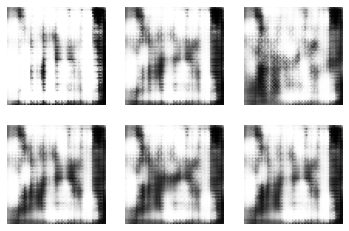

2901 [D loss: 0.572551, acc.: 89.84%] [G loss: 1.040463]
2902 [D loss: 0.564467, acc.: 88.28%] [G loss: 1.109610]
2903 [D loss: 0.541035, acc.: 91.02%] [G loss: 1.133470]
2904 [D loss: 0.529064, acc.: 91.02%] [G loss: 1.146680]
2905 [D loss: 0.545747, acc.: 93.36%] [G loss: 1.084071]
2906 [D loss: 0.566779, acc.: 89.06%] [G loss: 0.988356]
2907 [D loss: 0.632056, acc.: 61.33%] [G loss: 0.814682]
2908 [D loss: 0.729996, acc.: 42.97%] [G loss: 0.651981]
2909 [D loss: 0.844671, acc.: 42.97%] [G loss: 0.537156]
2910 [D loss: 0.866616, acc.: 36.72%] [G loss: 0.602257]
2911 [D loss: 0.759056, acc.: 34.38%] [G loss: 0.790618]
2912 [D loss: 0.668901, acc.: 58.59%] [G loss: 1.001351]
2913 [D loss: 0.662707, acc.: 67.97%] [G loss: 1.075671]
2914 [D loss: 0.642116, acc.: 72.66%] [G loss: 1.025011]
2915 [D loss: 0.651265, acc.: 68.36%] [G loss: 1.003872]
2916 [D loss: 0.636285, acc.: 75.00%] [G loss: 0.963140]
2917 [D loss: 0.651952, acc.: 74.61%] [G loss: 0.916559]
2918 [D loss: 0.662723, acc.: 7

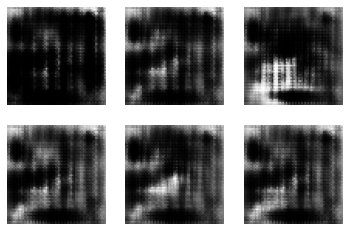

2951 [D loss: 0.741719, acc.: 37.89%] [G loss: 0.735789]
2952 [D loss: 0.684535, acc.: 50.00%] [G loss: 0.870940]
2953 [D loss: 0.632337, acc.: 63.67%] [G loss: 1.019958]
2954 [D loss: 0.587654, acc.: 74.61%] [G loss: 1.087798]
2955 [D loss: 0.602276, acc.: 70.70%] [G loss: 1.105069]
2956 [D loss: 0.603068, acc.: 67.58%] [G loss: 1.039925]
2957 [D loss: 0.615734, acc.: 75.39%] [G loss: 0.949270]
2958 [D loss: 0.641752, acc.: 73.05%] [G loss: 0.863472]
2959 [D loss: 0.646235, acc.: 76.95%] [G loss: 0.813993]
2960 [D loss: 0.678956, acc.: 73.44%] [G loss: 0.771696]
2961 [D loss: 0.680053, acc.: 59.77%] [G loss: 0.738809]
2962 [D loss: 0.674997, acc.: 52.34%] [G loss: 0.730712]
2963 [D loss: 0.689547, acc.: 45.70%] [G loss: 0.727644]
2964 [D loss: 0.690613, acc.: 53.91%] [G loss: 0.735280]
2965 [D loss: 0.672267, acc.: 64.84%] [G loss: 0.743478]
2966 [D loss: 0.675668, acc.: 70.31%] [G loss: 0.754870]
2967 [D loss: 0.654199, acc.: 72.27%] [G loss: 0.768995]
2968 [D loss: 0.642841, acc.: 7

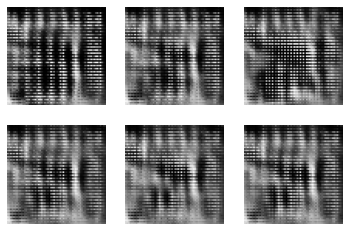

3001 [D loss: 0.752736, acc.: 40.23%] [G loss: 0.835113]
3002 [D loss: 0.787204, acc.: 27.73%] [G loss: 0.773581]
3003 [D loss: 0.802635, acc.: 20.31%] [G loss: 0.740298]
3004 [D loss: 0.737610, acc.: 32.03%] [G loss: 0.754771]
3005 [D loss: 0.748737, acc.: 28.52%] [G loss: 0.754716]
3006 [D loss: 0.736673, acc.: 32.42%] [G loss: 0.768742]
3007 [D loss: 0.714221, acc.: 41.41%] [G loss: 0.777166]
3008 [D loss: 0.740947, acc.: 41.41%] [G loss: 0.782033]
3009 [D loss: 0.729257, acc.: 36.33%] [G loss: 0.767322]
3010 [D loss: 0.708795, acc.: 42.97%] [G loss: 0.752067]
3011 [D loss: 0.713867, acc.: 41.02%] [G loss: 0.752358]
3012 [D loss: 0.700667, acc.: 42.97%] [G loss: 0.735718]
3013 [D loss: 0.699224, acc.: 45.70%] [G loss: 0.751178]
3014 [D loss: 0.685808, acc.: 50.78%] [G loss: 0.778455]
3015 [D loss: 0.655573, acc.: 66.41%] [G loss: 0.804677]
3016 [D loss: 0.660446, acc.: 72.27%] [G loss: 0.834221]
3017 [D loss: 0.644839, acc.: 76.17%] [G loss: 0.857318]
3018 [D loss: 0.612431, acc.: 8

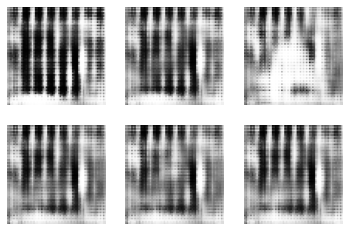

3051 [D loss: 0.743658, acc.: 30.47%] [G loss: 0.694724]
3052 [D loss: 0.730985, acc.: 33.98%] [G loss: 0.665238]
3053 [D loss: 0.718341, acc.: 33.20%] [G loss: 0.688186]
3054 [D loss: 0.720736, acc.: 31.25%] [G loss: 0.713541]
3055 [D loss: 0.700515, acc.: 33.59%] [G loss: 0.739893]
3056 [D loss: 0.713291, acc.: 34.77%] [G loss: 0.743018]
3057 [D loss: 0.694787, acc.: 45.31%] [G loss: 0.757117]
3058 [D loss: 0.697687, acc.: 44.92%] [G loss: 0.769728]
3059 [D loss: 0.698836, acc.: 50.39%] [G loss: 0.792899]
3060 [D loss: 0.651568, acc.: 63.28%] [G loss: 0.850624]
3061 [D loss: 0.638821, acc.: 74.61%] [G loss: 0.926143]
3062 [D loss: 0.628343, acc.: 73.05%] [G loss: 0.951662]
3063 [D loss: 0.649132, acc.: 68.75%] [G loss: 0.976811]
3064 [D loss: 0.635837, acc.: 73.05%] [G loss: 0.911000]
3065 [D loss: 0.655496, acc.: 73.83%] [G loss: 0.852280]
3066 [D loss: 0.704434, acc.: 56.64%] [G loss: 0.770242]
3067 [D loss: 0.723483, acc.: 36.33%] [G loss: 0.714665]
3068 [D loss: 0.733811, acc.: 3

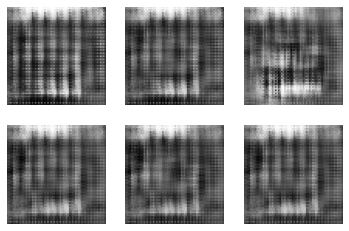

3101 [D loss: 0.669737, acc.: 73.44%] [G loss: 0.756720]
3102 [D loss: 0.670232, acc.: 71.48%] [G loss: 0.748208]
3103 [D loss: 0.657449, acc.: 76.56%] [G loss: 0.755243]
3104 [D loss: 0.655901, acc.: 75.39%] [G loss: 0.761062]
3105 [D loss: 0.666182, acc.: 75.78%] [G loss: 0.764407]
3106 [D loss: 0.652631, acc.: 78.12%] [G loss: 0.764438]
3107 [D loss: 0.661074, acc.: 75.78%] [G loss: 0.767238]
3108 [D loss: 0.665167, acc.: 74.22%] [G loss: 0.765615]
3109 [D loss: 0.650616, acc.: 75.78%] [G loss: 0.768224]
3110 [D loss: 0.662117, acc.: 74.61%] [G loss: 0.766215]
3111 [D loss: 0.651257, acc.: 76.56%] [G loss: 0.773312]
3112 [D loss: 0.664190, acc.: 74.61%] [G loss: 0.778285]
3113 [D loss: 0.631737, acc.: 79.69%] [G loss: 0.788001]
3114 [D loss: 0.649596, acc.: 73.44%] [G loss: 0.783224]
3115 [D loss: 0.640731, acc.: 75.39%] [G loss: 0.796884]
3116 [D loss: 0.631282, acc.: 80.86%] [G loss: 0.808079]
3117 [D loss: 0.615845, acc.: 79.69%] [G loss: 0.819379]
3118 [D loss: 0.629393, acc.: 7

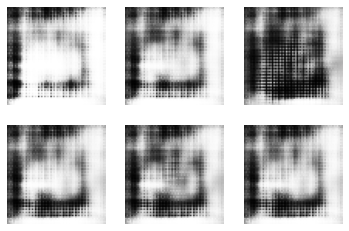

3151 [D loss: 0.508841, acc.: 87.11%] [G loss: 1.156964]
3152 [D loss: 0.548476, acc.: 84.77%] [G loss: 1.048122]
3153 [D loss: 0.593958, acc.: 77.73%] [G loss: 0.954306]
3154 [D loss: 0.638894, acc.: 64.84%] [G loss: 0.810136]
3155 [D loss: 0.696200, acc.: 38.67%] [G loss: 0.706355]
3156 [D loss: 0.746923, acc.: 37.89%] [G loss: 0.662719]
3157 [D loss: 0.715062, acc.: 35.55%] [G loss: 0.769123]
3158 [D loss: 0.653556, acc.: 64.84%] [G loss: 0.925777]
3159 [D loss: 0.614123, acc.: 69.53%] [G loss: 1.003956]
3160 [D loss: 0.610284, acc.: 82.03%] [G loss: 1.071655]
3161 [D loss: 0.641175, acc.: 71.88%] [G loss: 1.059160]
3162 [D loss: 0.665396, acc.: 66.80%] [G loss: 1.046739]
3163 [D loss: 0.663165, acc.: 70.70%] [G loss: 1.084172]
3164 [D loss: 0.629909, acc.: 77.73%] [G loss: 1.146862]
3165 [D loss: 0.596220, acc.: 84.38%] [G loss: 1.188299]
3166 [D loss: 0.629882, acc.: 76.95%] [G loss: 1.145435]
3167 [D loss: 0.664490, acc.: 76.17%] [G loss: 1.084058]
3168 [D loss: 0.629403, acc.: 8

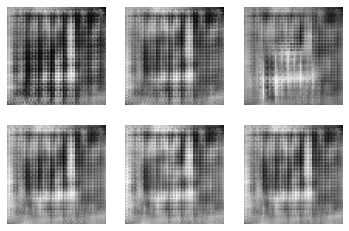

3201 [D loss: 0.710497, acc.: 40.23%] [G loss: 0.699666]
3202 [D loss: 0.719242, acc.: 36.72%] [G loss: 0.672522]
3203 [D loss: 0.788058, acc.: 26.95%] [G loss: 0.597964]
3204 [D loss: 0.801772, acc.: 25.39%] [G loss: 0.577586]
3205 [D loss: 0.789905, acc.: 21.88%] [G loss: 0.614648]
3206 [D loss: 0.736932, acc.: 26.56%] [G loss: 0.684891]
3207 [D loss: 0.683992, acc.: 48.83%] [G loss: 0.776723]
3208 [D loss: 0.638774, acc.: 73.05%] [G loss: 0.901756]
3209 [D loss: 0.576593, acc.: 78.12%] [G loss: 1.030734]
3210 [D loss: 0.543930, acc.: 77.34%] [G loss: 1.124642]
3211 [D loss: 0.529959, acc.: 80.47%] [G loss: 1.195691]
3212 [D loss: 0.520483, acc.: 81.25%] [G loss: 1.184960]
3213 [D loss: 0.541234, acc.: 82.03%] [G loss: 1.082445]
3214 [D loss: 0.590962, acc.: 79.69%] [G loss: 0.958151]
3215 [D loss: 0.624597, acc.: 78.52%] [G loss: 0.831890]
3216 [D loss: 0.650231, acc.: 66.80%] [G loss: 0.736169]
3217 [D loss: 0.679155, acc.: 32.42%] [G loss: 0.694782]
3218 [D loss: 0.697197, acc.: 2

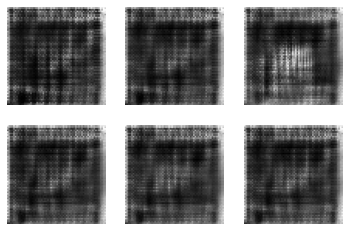

3251 [D loss: 0.872310, acc.: 22.66%] [G loss: 0.548949]
3252 [D loss: 0.790741, acc.: 27.73%] [G loss: 0.604165]
3253 [D loss: 0.768474, acc.: 23.83%] [G loss: 0.687326]
3254 [D loss: 0.707963, acc.: 41.02%] [G loss: 0.770494]
3255 [D loss: 0.704334, acc.: 48.44%] [G loss: 0.804866]
3256 [D loss: 0.689471, acc.: 49.22%] [G loss: 0.791886]
3257 [D loss: 0.733521, acc.: 40.62%] [G loss: 0.788218]
3258 [D loss: 0.728584, acc.: 33.98%] [G loss: 0.769196]
3259 [D loss: 0.734499, acc.: 30.47%] [G loss: 0.750281]
3260 [D loss: 0.745604, acc.: 23.44%] [G loss: 0.726864]
3261 [D loss: 0.745134, acc.: 29.69%] [G loss: 0.728377]
3262 [D loss: 0.762789, acc.: 28.52%] [G loss: 0.728400]
3263 [D loss: 0.750310, acc.: 30.08%] [G loss: 0.736211]
3264 [D loss: 0.733318, acc.: 42.19%] [G loss: 0.762864]
3265 [D loss: 0.724279, acc.: 55.47%] [G loss: 0.794716]
3266 [D loss: 0.694526, acc.: 67.19%] [G loss: 0.835276]
3267 [D loss: 0.675101, acc.: 67.58%] [G loss: 0.880660]
3268 [D loss: 0.663962, acc.: 7

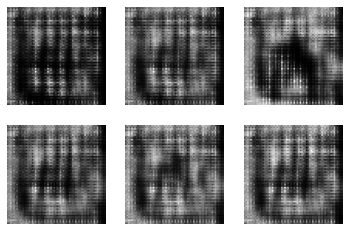

3301 [D loss: 0.713251, acc.: 57.81%] [G loss: 0.820142]
3302 [D loss: 0.685923, acc.: 69.92%] [G loss: 0.855324]
3303 [D loss: 0.693856, acc.: 66.02%] [G loss: 0.896358]
3304 [D loss: 0.660893, acc.: 69.53%] [G loss: 0.917838]
3305 [D loss: 0.658296, acc.: 74.22%] [G loss: 0.917955]
3306 [D loss: 0.647896, acc.: 72.27%] [G loss: 0.866248]
3307 [D loss: 0.669148, acc.: 65.23%] [G loss: 0.819255]
3308 [D loss: 0.720929, acc.: 51.17%] [G loss: 0.752671]
3309 [D loss: 0.720659, acc.: 27.34%] [G loss: 0.696962]
3310 [D loss: 0.746513, acc.: 26.95%] [G loss: 0.648541]
3311 [D loss: 0.766502, acc.: 24.61%] [G loss: 0.610835]
3312 [D loss: 0.766228, acc.: 25.39%] [G loss: 0.609963]
3313 [D loss: 0.773255, acc.: 23.44%] [G loss: 0.619871]
3314 [D loss: 0.756642, acc.: 26.95%] [G loss: 0.629457]
3315 [D loss: 0.753693, acc.: 29.30%] [G loss: 0.646142]
3316 [D loss: 0.735798, acc.: 38.67%] [G loss: 0.666547]
3317 [D loss: 0.713668, acc.: 49.61%] [G loss: 0.701830]
3318 [D loss: 0.710122, acc.: 5

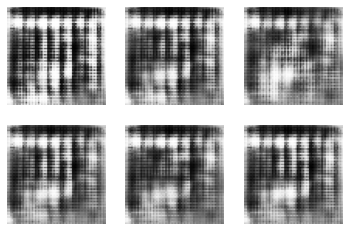

3351 [D loss: 0.625915, acc.: 79.69%] [G loss: 0.868881]
3352 [D loss: 0.602983, acc.: 78.12%] [G loss: 0.882324]
3353 [D loss: 0.618101, acc.: 79.30%] [G loss: 0.892437]
3354 [D loss: 0.609033, acc.: 81.64%] [G loss: 0.893067]
3355 [D loss: 0.585150, acc.: 83.59%] [G loss: 0.899520]
3356 [D loss: 0.611460, acc.: 80.47%] [G loss: 0.895188]
3357 [D loss: 0.618502, acc.: 76.17%] [G loss: 0.878312]
3358 [D loss: 0.606367, acc.: 82.42%] [G loss: 0.867481]
3359 [D loss: 0.598004, acc.: 87.11%] [G loss: 0.856636]
3360 [D loss: 0.606971, acc.: 83.20%] [G loss: 0.853312]
3361 [D loss: 0.614549, acc.: 84.77%] [G loss: 0.853354]
3362 [D loss: 0.605556, acc.: 85.94%] [G loss: 0.860141]
3363 [D loss: 0.599780, acc.: 86.33%] [G loss: 0.877502]
3364 [D loss: 0.612797, acc.: 83.20%] [G loss: 0.886459]
3365 [D loss: 0.602808, acc.: 83.20%] [G loss: 0.928057]
3366 [D loss: 0.604471, acc.: 84.38%] [G loss: 0.962781]
3367 [D loss: 0.573975, acc.: 88.28%] [G loss: 0.979533]
3368 [D loss: 0.591590, acc.: 8

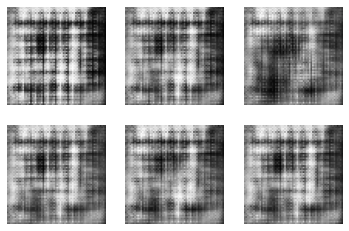

3401 [D loss: 0.678562, acc.: 57.81%] [G loss: 0.739319]
3402 [D loss: 0.677803, acc.: 58.98%] [G loss: 0.739585]
3403 [D loss: 0.672679, acc.: 58.59%] [G loss: 0.739612]
3404 [D loss: 0.663317, acc.: 65.23%] [G loss: 0.744502]
3405 [D loss: 0.664500, acc.: 65.23%] [G loss: 0.749501]
3406 [D loss: 0.665152, acc.: 60.94%] [G loss: 0.752787]
3407 [D loss: 0.645788, acc.: 66.02%] [G loss: 0.760554]
3408 [D loss: 0.657556, acc.: 63.28%] [G loss: 0.761662]
3409 [D loss: 0.653253, acc.: 65.23%] [G loss: 0.775911]
3410 [D loss: 0.645605, acc.: 72.27%] [G loss: 0.813879]
3411 [D loss: 0.642231, acc.: 72.66%] [G loss: 0.811510]
3412 [D loss: 0.645870, acc.: 76.56%] [G loss: 0.817659]
3413 [D loss: 0.632276, acc.: 79.69%] [G loss: 0.816329]
3414 [D loss: 0.636006, acc.: 76.17%] [G loss: 0.811764]
3415 [D loss: 0.627412, acc.: 84.38%] [G loss: 0.813502]
3416 [D loss: 0.635231, acc.: 80.47%] [G loss: 0.812673]
3417 [D loss: 0.631615, acc.: 80.08%] [G loss: 0.805839]
3418 [D loss: 0.631425, acc.: 8

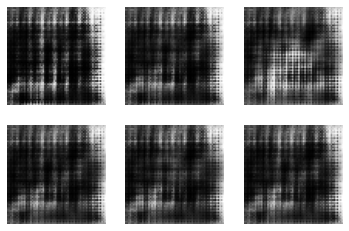

3451 [D loss: 0.698823, acc.: 45.70%] [G loss: 0.797152]
3452 [D loss: 0.723438, acc.: 47.66%] [G loss: 0.784908]
3453 [D loss: 0.708228, acc.: 53.91%] [G loss: 0.811553]
3454 [D loss: 0.713792, acc.: 53.52%] [G loss: 0.835252]
3455 [D loss: 0.705119, acc.: 51.95%] [G loss: 0.812359]
3456 [D loss: 0.714312, acc.: 51.95%] [G loss: 0.763076]
3457 [D loss: 0.723727, acc.: 43.75%] [G loss: 0.712808]
3458 [D loss: 0.720346, acc.: 34.77%] [G loss: 0.703022]
3459 [D loss: 0.740608, acc.: 28.91%] [G loss: 0.676713]
3460 [D loss: 0.746390, acc.: 27.34%] [G loss: 0.672594]
3461 [D loss: 0.742028, acc.: 29.69%] [G loss: 0.665918]
3462 [D loss: 0.733015, acc.: 27.73%] [G loss: 0.666483]
3463 [D loss: 0.723187, acc.: 29.69%] [G loss: 0.669589]
3464 [D loss: 0.724524, acc.: 26.95%] [G loss: 0.677509]
3465 [D loss: 0.730691, acc.: 26.95%] [G loss: 0.670355]
3466 [D loss: 0.712893, acc.: 30.08%] [G loss: 0.677463]
3467 [D loss: 0.717718, acc.: 28.52%] [G loss: 0.676506]
3468 [D loss: 0.714753, acc.: 2

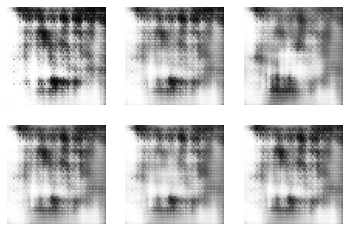

3501 [D loss: 0.673454, acc.: 65.23%] [G loss: 0.856678]
3502 [D loss: 0.651870, acc.: 72.27%] [G loss: 0.902000]
3503 [D loss: 0.640353, acc.: 75.00%] [G loss: 0.929014]
3504 [D loss: 0.626457, acc.: 80.47%] [G loss: 0.931844]
3505 [D loss: 0.629563, acc.: 79.69%] [G loss: 0.896796]
3506 [D loss: 0.634311, acc.: 80.08%] [G loss: 0.891055]
3507 [D loss: 0.636565, acc.: 79.69%] [G loss: 0.879514]
3508 [D loss: 0.642396, acc.: 79.69%] [G loss: 0.865034]
3509 [D loss: 0.660304, acc.: 71.88%] [G loss: 0.828291]
3510 [D loss: 0.666664, acc.: 68.36%] [G loss: 0.816910]
3511 [D loss: 0.670480, acc.: 53.52%] [G loss: 0.784384]
3512 [D loss: 0.703047, acc.: 37.89%] [G loss: 0.770862]
3513 [D loss: 0.704857, acc.: 38.28%] [G loss: 0.763349]
3514 [D loss: 0.700190, acc.: 42.19%] [G loss: 0.771259]
3515 [D loss: 0.699326, acc.: 50.00%] [G loss: 0.789855]
3516 [D loss: 0.707593, acc.: 43.75%] [G loss: 0.773255]
3517 [D loss: 0.714009, acc.: 40.23%] [G loss: 0.752570]
3518 [D loss: 0.745310, acc.: 2

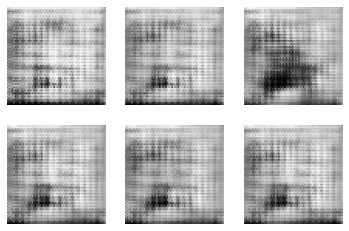

3551 [D loss: 0.583922, acc.: 83.59%] [G loss: 0.931596]
3552 [D loss: 0.591220, acc.: 80.86%] [G loss: 0.913544]
3553 [D loss: 0.609637, acc.: 79.69%] [G loss: 0.903521]
3554 [D loss: 0.621148, acc.: 79.69%] [G loss: 0.851246]
3555 [D loss: 0.650557, acc.: 61.33%] [G loss: 0.796163]
3556 [D loss: 0.728098, acc.: 28.91%] [G loss: 0.679659]
3557 [D loss: 0.777374, acc.: 33.20%] [G loss: 0.594929]
3558 [D loss: 0.831627, acc.: 29.69%] [G loss: 0.550785]
3559 [D loss: 0.826237, acc.: 27.34%] [G loss: 0.597481]
3560 [D loss: 0.773926, acc.: 25.00%] [G loss: 0.733930]
3561 [D loss: 0.701067, acc.: 51.17%] [G loss: 0.890037]
3562 [D loss: 0.647018, acc.: 70.70%] [G loss: 0.998765]
3563 [D loss: 0.619210, acc.: 74.22%] [G loss: 1.067291]
3564 [D loss: 0.594610, acc.: 75.00%] [G loss: 1.117559]
3565 [D loss: 0.572374, acc.: 80.08%] [G loss: 1.086544]
3566 [D loss: 0.638421, acc.: 76.56%] [G loss: 0.927694]
3567 [D loss: 0.657763, acc.: 77.34%] [G loss: 0.846301]
3568 [D loss: 0.664411, acc.: 7

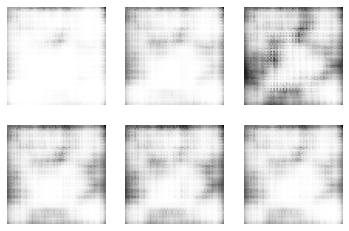

3601 [D loss: 0.623847, acc.: 70.31%] [G loss: 1.145142]
3602 [D loss: 0.519832, acc.: 78.91%] [G loss: 1.388662]
3603 [D loss: 0.488358, acc.: 78.91%] [G loss: 1.511583]
3604 [D loss: 0.466497, acc.: 80.08%] [G loss: 1.642850]
3605 [D loss: 0.446657, acc.: 81.64%] [G loss: 1.732801]
3606 [D loss: 0.433544, acc.: 84.38%] [G loss: 1.686395]
3607 [D loss: 0.458778, acc.: 89.06%] [G loss: 1.480659]
3608 [D loss: 0.512095, acc.: 89.06%] [G loss: 1.086458]
3609 [D loss: 0.582108, acc.: 86.33%] [G loss: 0.848395]
3610 [D loss: 0.612992, acc.: 51.56%] [G loss: 0.749785]
3611 [D loss: 0.660364, acc.: 42.58%] [G loss: 0.677227]
3612 [D loss: 0.715673, acc.: 42.19%] [G loss: 0.604237]
3613 [D loss: 0.835274, acc.: 34.38%] [G loss: 0.523010]
3614 [D loss: 0.895384, acc.: 35.16%] [G loss: 0.463047]
3615 [D loss: 0.972445, acc.: 30.08%] [G loss: 0.412584]
3616 [D loss: 0.939486, acc.: 33.98%] [G loss: 0.448341]
3617 [D loss: 0.883167, acc.: 27.73%] [G loss: 0.521279]
3618 [D loss: 0.807124, acc.: 3

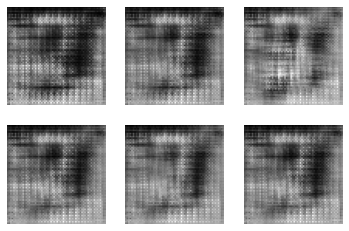

3651 [D loss: 0.662320, acc.: 71.48%] [G loss: 0.808168]
3652 [D loss: 0.672147, acc.: 69.53%] [G loss: 0.798525]
3653 [D loss: 0.671345, acc.: 66.80%] [G loss: 0.812006]
3654 [D loss: 0.675150, acc.: 66.41%] [G loss: 0.803435]
3655 [D loss: 0.655680, acc.: 69.14%] [G loss: 0.823493]
3656 [D loss: 0.664550, acc.: 70.31%] [G loss: 0.839926]
3657 [D loss: 0.674112, acc.: 67.19%] [G loss: 0.838269]
3658 [D loss: 0.644389, acc.: 73.44%] [G loss: 0.869260]
3659 [D loss: 0.652262, acc.: 69.53%] [G loss: 0.860506]
3660 [D loss: 0.639065, acc.: 71.88%] [G loss: 0.868176]
3661 [D loss: 0.647539, acc.: 70.31%] [G loss: 0.868346]
3662 [D loss: 0.637423, acc.: 71.48%] [G loss: 0.850143]
3663 [D loss: 0.638789, acc.: 69.14%] [G loss: 0.850414]
3664 [D loss: 0.651017, acc.: 69.14%] [G loss: 0.832811]
3665 [D loss: 0.651077, acc.: 71.09%] [G loss: 0.819733]
3666 [D loss: 0.655290, acc.: 64.06%] [G loss: 0.828733]
3667 [D loss: 0.667756, acc.: 64.45%] [G loss: 0.822260]
3668 [D loss: 0.630950, acc.: 6

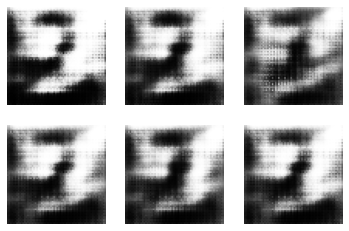

3701 [D loss: 0.661552, acc.: 62.50%] [G loss: 0.893089]
3702 [D loss: 0.653939, acc.: 60.94%] [G loss: 0.949043]
3703 [D loss: 0.617611, acc.: 77.34%] [G loss: 1.082038]
3704 [D loss: 0.571263, acc.: 75.78%] [G loss: 1.258470]
3705 [D loss: 0.529666, acc.: 78.52%] [G loss: 1.374292]
3706 [D loss: 0.490850, acc.: 82.42%] [G loss: 1.473827]
3707 [D loss: 0.448458, acc.: 88.67%] [G loss: 1.517465]
3708 [D loss: 0.474687, acc.: 83.98%] [G loss: 1.536955]
3709 [D loss: 0.440876, acc.: 87.89%] [G loss: 1.607307]
3710 [D loss: 0.448486, acc.: 85.16%] [G loss: 1.575913]
3711 [D loss: 0.444886, acc.: 89.45%] [G loss: 1.493387]
3712 [D loss: 0.487983, acc.: 85.94%] [G loss: 1.258893]
3713 [D loss: 0.616699, acc.: 70.70%] [G loss: 0.886570]
3714 [D loss: 0.677708, acc.: 45.70%] [G loss: 0.754050]
3715 [D loss: 0.709979, acc.: 41.41%] [G loss: 0.671945]
3716 [D loss: 0.739089, acc.: 35.16%] [G loss: 0.651702]
3717 [D loss: 0.731667, acc.: 32.81%] [G loss: 0.628964]
3718 [D loss: 0.724935, acc.: 3

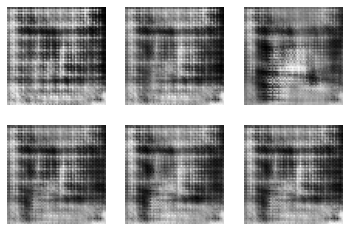

3751 [D loss: 0.734330, acc.: 39.06%] [G loss: 0.716780]
3752 [D loss: 0.734405, acc.: 30.08%] [G loss: 0.698826]
3753 [D loss: 0.728647, acc.: 30.86%] [G loss: 0.690599]
3754 [D loss: 0.742187, acc.: 24.22%] [G loss: 0.683585]
3755 [D loss: 0.736546, acc.: 24.61%] [G loss: 0.678814]
3756 [D loss: 0.743756, acc.: 23.83%] [G loss: 0.672695]
3757 [D loss: 0.751167, acc.: 21.09%] [G loss: 0.659600]
3758 [D loss: 0.753143, acc.: 19.92%] [G loss: 0.657563]
3759 [D loss: 0.735734, acc.: 25.78%] [G loss: 0.662576]
3760 [D loss: 0.746529, acc.: 18.75%] [G loss: 0.661595]
3761 [D loss: 0.735394, acc.: 26.17%] [G loss: 0.669346]
3762 [D loss: 0.728005, acc.: 26.17%] [G loss: 0.673836]
3763 [D loss: 0.730324, acc.: 31.25%] [G loss: 0.691776]
3764 [D loss: 0.716733, acc.: 40.23%] [G loss: 0.706275]
3765 [D loss: 0.706676, acc.: 48.44%] [G loss: 0.734357]
3766 [D loss: 0.692741, acc.: 51.17%] [G loss: 0.765132]
3767 [D loss: 0.677969, acc.: 60.16%] [G loss: 0.777281]
3768 [D loss: 0.641772, acc.: 7

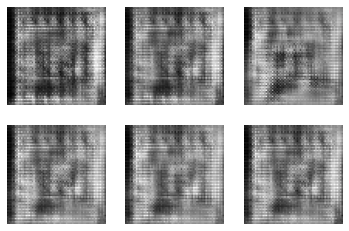

3801 [D loss: 0.638912, acc.: 75.39%] [G loss: 0.853984]
3802 [D loss: 0.657560, acc.: 72.27%] [G loss: 0.853953]
3803 [D loss: 0.650014, acc.: 69.92%] [G loss: 0.860676]
3804 [D loss: 0.652311, acc.: 70.70%] [G loss: 0.855677]
3805 [D loss: 0.628736, acc.: 75.78%] [G loss: 0.848314]
3806 [D loss: 0.640793, acc.: 73.44%] [G loss: 0.836489]
3807 [D loss: 0.625231, acc.: 76.17%] [G loss: 0.829683]
3808 [D loss: 0.625055, acc.: 79.30%] [G loss: 0.823923]
3809 [D loss: 0.627341, acc.: 80.08%] [G loss: 0.807756]
3810 [D loss: 0.632574, acc.: 79.30%] [G loss: 0.795550]
3811 [D loss: 0.630426, acc.: 79.69%] [G loss: 0.781556]
3812 [D loss: 0.640102, acc.: 67.97%] [G loss: 0.758283]
3813 [D loss: 0.651777, acc.: 50.00%] [G loss: 0.736372]
3814 [D loss: 0.664848, acc.: 46.09%] [G loss: 0.718233]
3815 [D loss: 0.665663, acc.: 45.70%] [G loss: 0.713526]
3816 [D loss: 0.693311, acc.: 37.50%] [G loss: 0.707622]
3817 [D loss: 0.670339, acc.: 43.75%] [G loss: 0.729607]
3818 [D loss: 0.664498, acc.: 4

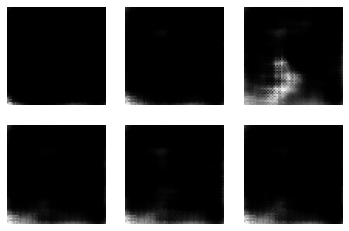

3851 [D loss: 0.419212, acc.: 83.98%] [G loss: 2.235687]
3852 [D loss: 0.366014, acc.: 90.62%] [G loss: 2.297819]
3853 [D loss: 0.354765, acc.: 91.02%] [G loss: 2.433810]
3854 [D loss: 0.348947, acc.: 89.84%] [G loss: 2.346883]
3855 [D loss: 0.331227, acc.: 89.84%] [G loss: 2.406462]
3856 [D loss: 0.304770, acc.: 93.75%] [G loss: 2.366139]
3857 [D loss: 0.277845, acc.: 94.53%] [G loss: 2.391751]
3858 [D loss: 0.254584, acc.: 97.27%] [G loss: 2.399577]
3859 [D loss: 0.251318, acc.: 96.09%] [G loss: 2.403455]
3860 [D loss: 0.274812, acc.: 96.09%] [G loss: 2.185784]
3861 [D loss: 0.285913, acc.: 96.88%] [G loss: 1.967863]
3862 [D loss: 0.417138, acc.: 84.38%] [G loss: 1.482281]
3863 [D loss: 0.643286, acc.: 59.77%] [G loss: 0.896585]
3864 [D loss: 0.945401, acc.: 41.41%] [G loss: 0.465668]
3865 [D loss: 0.931211, acc.: 36.72%] [G loss: 0.465568]
3866 [D loss: 0.889383, acc.: 34.77%] [G loss: 0.557605]
3867 [D loss: 0.827463, acc.: 30.08%] [G loss: 0.648602]
3868 [D loss: 0.766640, acc.: 3

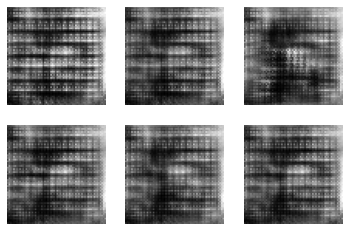

3901 [D loss: 0.628737, acc.: 72.66%] [G loss: 0.865071]
3902 [D loss: 0.626663, acc.: 73.83%] [G loss: 0.863187]
3903 [D loss: 0.646773, acc.: 71.09%] [G loss: 0.847859]
3904 [D loss: 0.634294, acc.: 69.92%] [G loss: 0.846319]
3905 [D loss: 0.631640, acc.: 70.31%] [G loss: 0.856579]
3906 [D loss: 0.657711, acc.: 64.84%] [G loss: 0.834829]
3907 [D loss: 0.654260, acc.: 67.97%] [G loss: 0.860631]
3908 [D loss: 0.620555, acc.: 71.09%] [G loss: 0.867180]
3909 [D loss: 0.616364, acc.: 73.83%] [G loss: 0.862656]
3910 [D loss: 0.619359, acc.: 72.27%] [G loss: 0.867150]
3911 [D loss: 0.631676, acc.: 69.14%] [G loss: 0.874966]
3912 [D loss: 0.642043, acc.: 66.80%] [G loss: 0.872840]
3913 [D loss: 0.595796, acc.: 73.83%] [G loss: 0.875142]
3914 [D loss: 0.640828, acc.: 68.75%] [G loss: 0.869160]
3915 [D loss: 0.627465, acc.: 69.53%] [G loss: 0.881887]
3916 [D loss: 0.635940, acc.: 67.58%] [G loss: 0.900038]
3917 [D loss: 0.599560, acc.: 78.91%] [G loss: 0.951212]
3918 [D loss: 0.599733, acc.: 7

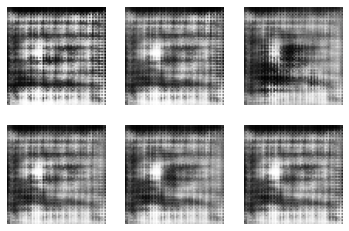

3951 [D loss: 0.776299, acc.: 28.12%] [G loss: 0.685312]
3952 [D loss: 0.741644, acc.: 29.30%] [G loss: 0.760254]
3953 [D loss: 0.712715, acc.: 50.39%] [G loss: 0.833384]
3954 [D loss: 0.647656, acc.: 78.91%] [G loss: 0.929092]
3955 [D loss: 0.651985, acc.: 75.78%] [G loss: 0.962010]
3956 [D loss: 0.608846, acc.: 79.30%] [G loss: 0.964422]
3957 [D loss: 0.651900, acc.: 74.22%] [G loss: 0.926765]
3958 [D loss: 0.671761, acc.: 70.31%] [G loss: 0.911104]
3959 [D loss: 0.652297, acc.: 73.83%] [G loss: 0.903852]
3960 [D loss: 0.660692, acc.: 76.56%] [G loss: 0.918363]
3961 [D loss: 0.668931, acc.: 69.92%] [G loss: 0.930251]
3962 [D loss: 0.661347, acc.: 70.70%] [G loss: 0.885838]
3963 [D loss: 0.670625, acc.: 66.02%] [G loss: 0.845300]
3964 [D loss: 0.692621, acc.: 57.42%] [G loss: 0.817337]
3965 [D loss: 0.713632, acc.: 47.66%] [G loss: 0.794319]
3966 [D loss: 0.715075, acc.: 46.48%] [G loss: 0.758942]
3967 [D loss: 0.718648, acc.: 39.84%] [G loss: 0.741160]
3968 [D loss: 0.738540, acc.: 3

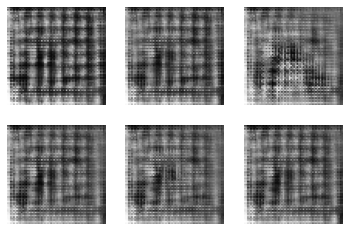

4001 [D loss: 0.756190, acc.: 30.47%] [G loss: 0.704710]
4002 [D loss: 0.739956, acc.: 26.95%] [G loss: 0.682847]
4003 [D loss: 0.762791, acc.: 23.83%] [G loss: 0.671843]
4004 [D loss: 0.749147, acc.: 26.17%] [G loss: 0.673165]
4005 [D loss: 0.757759, acc.: 23.83%] [G loss: 0.671160]
4006 [D loss: 0.740195, acc.: 28.52%] [G loss: 0.682990]
4007 [D loss: 0.725615, acc.: 30.08%] [G loss: 0.697978]
4008 [D loss: 0.726081, acc.: 28.12%] [G loss: 0.711919]
4009 [D loss: 0.697236, acc.: 38.28%] [G loss: 0.732098]
4010 [D loss: 0.712443, acc.: 42.97%] [G loss: 0.740321]
4011 [D loss: 0.690493, acc.: 64.06%] [G loss: 0.757772]
4012 [D loss: 0.698565, acc.: 64.84%] [G loss: 0.765931]
4013 [D loss: 0.692846, acc.: 73.83%] [G loss: 0.780068]
4014 [D loss: 0.682638, acc.: 73.44%] [G loss: 0.778955]
4015 [D loss: 0.675669, acc.: 76.17%] [G loss: 0.783331]
4016 [D loss: 0.673382, acc.: 76.95%] [G loss: 0.787775]
4017 [D loss: 0.679424, acc.: 75.00%] [G loss: 0.787761]
4018 [D loss: 0.678772, acc.: 7

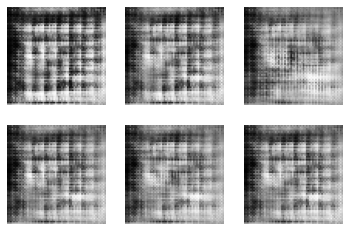

4051 [D loss: 0.673830, acc.: 55.47%] [G loss: 0.742922]
4052 [D loss: 0.658987, acc.: 56.64%] [G loss: 0.781049]
4053 [D loss: 0.700034, acc.: 50.78%] [G loss: 0.784805]
4054 [D loss: 0.694215, acc.: 53.12%] [G loss: 0.778359]
4055 [D loss: 0.680985, acc.: 50.00%] [G loss: 0.795963]
4056 [D loss: 0.702245, acc.: 52.34%] [G loss: 0.834000]
4057 [D loss: 0.679132, acc.: 56.25%] [G loss: 0.838092]
4058 [D loss: 0.658138, acc.: 63.67%] [G loss: 0.885506]
4059 [D loss: 0.636131, acc.: 68.75%] [G loss: 0.898891]
4060 [D loss: 0.639087, acc.: 69.14%] [G loss: 0.908330]
4061 [D loss: 0.620275, acc.: 76.56%] [G loss: 0.940149]
4062 [D loss: 0.610191, acc.: 76.56%] [G loss: 0.998518]
4063 [D loss: 0.585700, acc.: 76.56%] [G loss: 1.057219]
4064 [D loss: 0.562516, acc.: 83.20%] [G loss: 1.120870]
4065 [D loss: 0.525874, acc.: 82.42%] [G loss: 1.201066]
4066 [D loss: 0.491822, acc.: 85.16%] [G loss: 1.293385]
4067 [D loss: 0.484937, acc.: 86.33%] [G loss: 1.346912]
4068 [D loss: 0.436300, acc.: 9

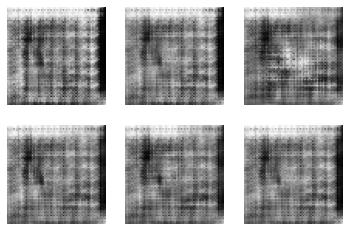

4101 [D loss: 0.628700, acc.: 81.25%] [G loss: 0.823548]
4102 [D loss: 0.628968, acc.: 78.52%] [G loss: 0.793446]
4103 [D loss: 0.641160, acc.: 46.88%] [G loss: 0.740165]
4104 [D loss: 0.698367, acc.: 32.81%] [G loss: 0.683911]
4105 [D loss: 0.748262, acc.: 31.64%] [G loss: 0.628549]
4106 [D loss: 0.779383, acc.: 30.08%] [G loss: 0.622745]
4107 [D loss: 0.759677, acc.: 33.20%] [G loss: 0.668124]
4108 [D loss: 0.735388, acc.: 51.56%] [G loss: 0.802029]
4109 [D loss: 0.667695, acc.: 49.61%] [G loss: 0.964750]
4110 [D loss: 0.601580, acc.: 67.58%] [G loss: 1.107564]
4111 [D loss: 0.584331, acc.: 72.27%] [G loss: 1.179478]
4112 [D loss: 0.577415, acc.: 76.17%] [G loss: 1.103045]
4113 [D loss: 0.612668, acc.: 71.48%] [G loss: 1.004643]
4114 [D loss: 0.631634, acc.: 75.78%] [G loss: 0.918059]
4115 [D loss: 0.657829, acc.: 73.05%] [G loss: 0.854543]
4116 [D loss: 0.670605, acc.: 72.66%] [G loss: 0.810330]
4117 [D loss: 0.679427, acc.: 70.31%] [G loss: 0.784211]
4118 [D loss: 0.650981, acc.: 6

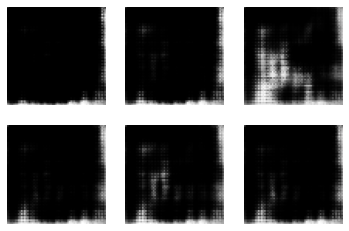

4151 [D loss: 0.656454, acc.: 69.92%] [G loss: 1.011359]
4152 [D loss: 0.587668, acc.: 80.47%] [G loss: 1.211539]
4153 [D loss: 0.528546, acc.: 84.77%] [G loss: 1.322852]
4154 [D loss: 0.488863, acc.: 87.50%] [G loss: 1.500452]
4155 [D loss: 0.445868, acc.: 88.67%] [G loss: 1.673491]
4156 [D loss: 0.389400, acc.: 93.36%] [G loss: 1.820089]
4157 [D loss: 0.361885, acc.: 94.14%] [G loss: 1.882360]
4158 [D loss: 0.324125, acc.: 95.31%] [G loss: 1.955137]
4159 [D loss: 0.296972, acc.: 96.09%] [G loss: 2.144822]
4160 [D loss: 0.256720, acc.: 97.27%] [G loss: 2.197163]
4161 [D loss: 0.235277, acc.: 98.44%] [G loss: 2.301376]
4162 [D loss: 0.219612, acc.: 98.44%] [G loss: 2.329621]
4163 [D loss: 0.197120, acc.: 98.44%] [G loss: 2.388026]
4164 [D loss: 0.182273, acc.: 99.22%] [G loss: 2.485223]
4165 [D loss: 0.165933, acc.: 99.22%] [G loss: 2.501248]
4166 [D loss: 0.159023, acc.: 99.61%] [G loss: 2.464693]
4167 [D loss: 0.156640, acc.: 98.83%] [G loss: 2.487402]
4168 [D loss: 0.143877, acc.: 9

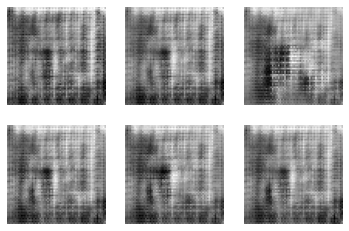

4201 [D loss: 0.704539, acc.: 49.61%] [G loss: 0.748748]
4202 [D loss: 0.725528, acc.: 41.02%] [G loss: 0.739730]
4203 [D loss: 0.724552, acc.: 33.98%] [G loss: 0.713690]
4204 [D loss: 0.741377, acc.: 31.25%] [G loss: 0.714761]
4205 [D loss: 0.755016, acc.: 24.22%] [G loss: 0.697536]
4206 [D loss: 0.763702, acc.: 24.61%] [G loss: 0.699661]
4207 [D loss: 0.758422, acc.: 25.00%] [G loss: 0.719350]
4208 [D loss: 0.756860, acc.: 26.95%] [G loss: 0.737865]
4209 [D loss: 0.724634, acc.: 44.14%] [G loss: 0.781526]
4210 [D loss: 0.702930, acc.: 57.03%] [G loss: 0.831314]
4211 [D loss: 0.677597, acc.: 62.89%] [G loss: 0.850823]
4212 [D loss: 0.659787, acc.: 65.62%] [G loss: 0.918837]
4213 [D loss: 0.627644, acc.: 73.44%] [G loss: 0.944277]
4214 [D loss: 0.638480, acc.: 69.53%] [G loss: 0.963086]
4215 [D loss: 0.638862, acc.: 69.92%] [G loss: 0.945521]
4216 [D loss: 0.632428, acc.: 72.66%] [G loss: 0.933061]
4217 [D loss: 0.623743, acc.: 75.78%] [G loss: 0.911486]
4218 [D loss: 0.642128, acc.: 7

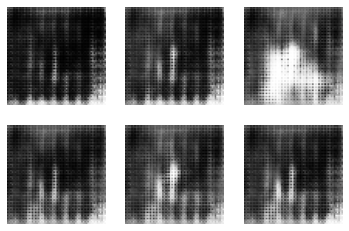

4251 [D loss: 0.865201, acc.: 26.95%] [G loss: 0.573614]
4252 [D loss: 0.882406, acc.: 21.09%] [G loss: 0.603538]
4253 [D loss: 0.794246, acc.: 22.27%] [G loss: 0.719645]
4254 [D loss: 0.736560, acc.: 46.09%] [G loss: 0.864516]
4255 [D loss: 0.695174, acc.: 53.12%] [G loss: 0.981084]
4256 [D loss: 0.659185, acc.: 66.02%] [G loss: 1.069446]
4257 [D loss: 0.653554, acc.: 62.50%] [G loss: 1.111003]
4258 [D loss: 0.645846, acc.: 64.84%] [G loss: 1.081143]
4259 [D loss: 0.660201, acc.: 65.23%] [G loss: 1.023198]
4260 [D loss: 0.686101, acc.: 63.28%] [G loss: 0.883578]
4261 [D loss: 0.730951, acc.: 43.36%] [G loss: 0.757425]
4262 [D loss: 0.748380, acc.: 25.39%] [G loss: 0.708871]
4263 [D loss: 0.745546, acc.: 26.95%] [G loss: 0.701564]
4264 [D loss: 0.759022, acc.: 22.27%] [G loss: 0.680669]
4265 [D loss: 0.749472, acc.: 26.95%] [G loss: 0.676467]
4266 [D loss: 0.739041, acc.: 24.61%] [G loss: 0.669024]
4267 [D loss: 0.742213, acc.: 25.00%] [G loss: 0.674582]
4268 [D loss: 0.717944, acc.: 2

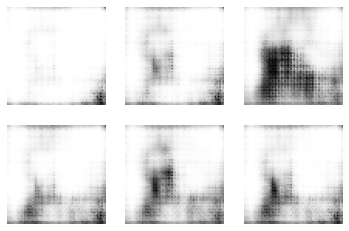

4301 [D loss: 0.456045, acc.: 79.69%] [G loss: 1.655652]
4302 [D loss: 0.447133, acc.: 83.98%] [G loss: 1.626384]
4303 [D loss: 0.438854, acc.: 82.81%] [G loss: 1.658612]
4304 [D loss: 0.474429, acc.: 85.55%] [G loss: 1.460244]
4305 [D loss: 0.474332, acc.: 86.72%] [G loss: 1.316510]
4306 [D loss: 0.521073, acc.: 85.94%] [G loss: 1.089932]
4307 [D loss: 0.604009, acc.: 70.31%] [G loss: 0.865941]
4308 [D loss: 0.647290, acc.: 55.47%] [G loss: 0.772853]
4309 [D loss: 0.718990, acc.: 41.80%] [G loss: 0.646959]
4310 [D loss: 0.802827, acc.: 35.94%] [G loss: 0.546768]
4311 [D loss: 0.865004, acc.: 31.25%] [G loss: 0.495394]
4312 [D loss: 0.864565, acc.: 36.72%] [G loss: 0.489229]
4313 [D loss: 0.883438, acc.: 32.81%] [G loss: 0.504556]
4314 [D loss: 0.841026, acc.: 32.03%] [G loss: 0.590930]
4315 [D loss: 0.762689, acc.: 30.08%] [G loss: 0.752994]
4316 [D loss: 0.679518, acc.: 51.56%] [G loss: 0.941014]
4317 [D loss: 0.605542, acc.: 74.61%] [G loss: 1.103498]
4318 [D loss: 0.561539, acc.: 7

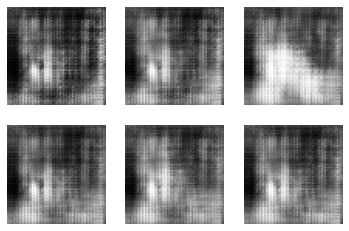

4351 [D loss: 0.718164, acc.: 30.08%] [G loss: 0.658772]
4352 [D loss: 0.726734, acc.: 26.17%] [G loss: 0.656386]
4353 [D loss: 0.741092, acc.: 25.78%] [G loss: 0.649259]
4354 [D loss: 0.765572, acc.: 26.95%] [G loss: 0.628250]
4355 [D loss: 0.783182, acc.: 22.27%] [G loss: 0.630844]
4356 [D loss: 0.799280, acc.: 21.09%] [G loss: 0.641051]
4357 [D loss: 0.796075, acc.: 23.05%] [G loss: 0.668800]
4358 [D loss: 0.769296, acc.: 37.50%] [G loss: 0.741316]
4359 [D loss: 0.765722, acc.: 37.89%] [G loss: 0.807073]
4360 [D loss: 0.697064, acc.: 41.02%] [G loss: 0.909573]
4361 [D loss: 0.658265, acc.: 65.62%] [G loss: 1.029998]
4362 [D loss: 0.604103, acc.: 69.14%] [G loss: 1.160497]
4363 [D loss: 0.571036, acc.: 69.14%] [G loss: 1.252266]
4364 [D loss: 0.532448, acc.: 72.66%] [G loss: 1.326653]
4365 [D loss: 0.523463, acc.: 71.88%] [G loss: 1.360473]
4366 [D loss: 0.506942, acc.: 78.91%] [G loss: 1.314370]
4367 [D loss: 0.511056, acc.: 80.47%] [G loss: 1.282796]
4368 [D loss: 0.520820, acc.: 8

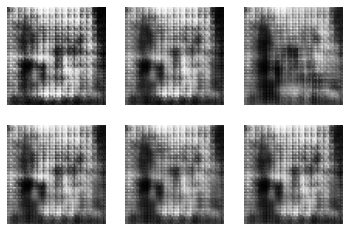

4401 [D loss: 0.810655, acc.: 20.70%] [G loss: 0.635387]
4402 [D loss: 0.867975, acc.: 22.66%] [G loss: 0.576070]
4403 [D loss: 0.913997, acc.: 16.02%] [G loss: 0.568079]
4404 [D loss: 0.898675, acc.: 13.67%] [G loss: 0.612584]
4405 [D loss: 0.820594, acc.: 14.06%] [G loss: 0.727356]
4406 [D loss: 0.731678, acc.: 36.72%] [G loss: 0.861256]
4407 [D loss: 0.696525, acc.: 64.06%] [G loss: 0.976470]
4408 [D loss: 0.651091, acc.: 65.62%] [G loss: 1.074308]
4409 [D loss: 0.642892, acc.: 63.67%] [G loss: 1.135587]
4410 [D loss: 0.622649, acc.: 67.58%] [G loss: 1.127413]
4411 [D loss: 0.613568, acc.: 68.75%] [G loss: 1.096633]
4412 [D loss: 0.633329, acc.: 71.09%] [G loss: 1.007656]
4413 [D loss: 0.676052, acc.: 64.06%] [G loss: 0.877723]
4414 [D loss: 0.701218, acc.: 49.61%] [G loss: 0.795533]
4415 [D loss: 0.688577, acc.: 52.34%] [G loss: 0.794947]
4416 [D loss: 0.695604, acc.: 50.39%] [G loss: 0.801543]
4417 [D loss: 0.682911, acc.: 55.86%] [G loss: 0.804094]
4418 [D loss: 0.681004, acc.: 5

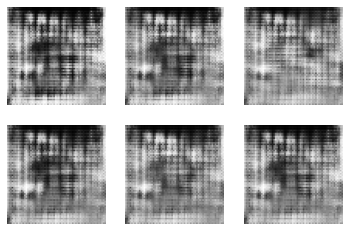

4451 [D loss: 0.734945, acc.: 35.16%] [G loss: 0.724522]
4452 [D loss: 0.749259, acc.: 26.56%] [G loss: 0.717189]
4453 [D loss: 0.722672, acc.: 35.16%] [G loss: 0.739762]
4454 [D loss: 0.740279, acc.: 32.81%] [G loss: 0.755279]
4455 [D loss: 0.683342, acc.: 46.88%] [G loss: 0.781220]
4456 [D loss: 0.705522, acc.: 53.12%] [G loss: 0.808606]
4457 [D loss: 0.682237, acc.: 68.36%] [G loss: 0.838064]
4458 [D loss: 0.675339, acc.: 69.92%] [G loss: 0.871181]
4459 [D loss: 0.650373, acc.: 69.92%] [G loss: 0.923508]
4460 [D loss: 0.616597, acc.: 76.56%] [G loss: 0.983991]
4461 [D loss: 0.610185, acc.: 75.39%] [G loss: 1.031542]
4462 [D loss: 0.581237, acc.: 79.69%] [G loss: 1.057838]
4463 [D loss: 0.564648, acc.: 80.08%] [G loss: 1.079244]
4464 [D loss: 0.555624, acc.: 80.47%] [G loss: 1.097369]
4465 [D loss: 0.556342, acc.: 85.16%] [G loss: 1.060514]
4466 [D loss: 0.558063, acc.: 88.28%] [G loss: 1.033330]
4467 [D loss: 0.579308, acc.: 85.16%] [G loss: 0.959764]
4468 [D loss: 0.603165, acc.: 7

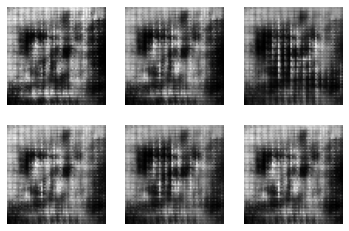

4501 [D loss: 0.660094, acc.: 71.88%] [G loss: 0.962589]
4502 [D loss: 0.656680, acc.: 71.48%] [G loss: 0.937132]
4503 [D loss: 0.664751, acc.: 71.88%] [G loss: 0.910606]
4504 [D loss: 0.672833, acc.: 73.05%] [G loss: 0.877635]
4505 [D loss: 0.697721, acc.: 73.83%] [G loss: 0.834678]
4506 [D loss: 0.680231, acc.: 74.61%] [G loss: 0.805740]
4507 [D loss: 0.697695, acc.: 70.70%] [G loss: 0.790027]
4508 [D loss: 0.673745, acc.: 64.84%] [G loss: 0.776264]
4509 [D loss: 0.710378, acc.: 50.00%] [G loss: 0.765473]
4510 [D loss: 0.705085, acc.: 48.05%] [G loss: 0.759121]
4511 [D loss: 0.696456, acc.: 50.78%] [G loss: 0.749295]
4512 [D loss: 0.696619, acc.: 48.44%] [G loss: 0.743785]
4513 [D loss: 0.695451, acc.: 49.22%] [G loss: 0.742779]
4514 [D loss: 0.689428, acc.: 53.52%] [G loss: 0.756998]
4515 [D loss: 0.686282, acc.: 51.95%] [G loss: 0.749946]
4516 [D loss: 0.678795, acc.: 50.39%] [G loss: 0.754589]
4517 [D loss: 0.673749, acc.: 54.30%] [G loss: 0.760805]
4518 [D loss: 0.657824, acc.: 6

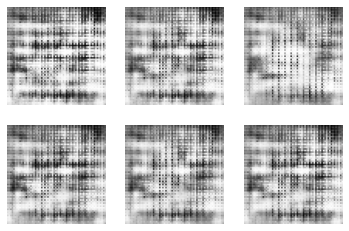

4551 [D loss: 0.733244, acc.: 28.52%] [G loss: 0.702195]
4552 [D loss: 0.725664, acc.: 29.30%] [G loss: 0.711277]
4553 [D loss: 0.713654, acc.: 30.47%] [G loss: 0.726994]
4554 [D loss: 0.715363, acc.: 32.81%] [G loss: 0.737336]
4555 [D loss: 0.723058, acc.: 31.25%] [G loss: 0.724790]
4556 [D loss: 0.746347, acc.: 26.17%] [G loss: 0.696465]
4557 [D loss: 0.756794, acc.: 27.73%] [G loss: 0.659465]
4558 [D loss: 0.788755, acc.: 24.61%] [G loss: 0.642503]
4559 [D loss: 0.783585, acc.: 23.83%] [G loss: 0.633165]
4560 [D loss: 0.802712, acc.: 22.66%] [G loss: 0.635218]
4561 [D loss: 0.792169, acc.: 22.66%] [G loss: 0.645792]
4562 [D loss: 0.790418, acc.: 17.19%] [G loss: 0.685493]
4563 [D loss: 0.765561, acc.: 17.58%] [G loss: 0.727470]
4564 [D loss: 0.733687, acc.: 32.42%] [G loss: 0.758959]
4565 [D loss: 0.732783, acc.: 41.41%] [G loss: 0.800734]
4566 [D loss: 0.715768, acc.: 56.64%] [G loss: 0.831315]
4567 [D loss: 0.721018, acc.: 60.16%] [G loss: 0.856908]
4568 [D loss: 0.671008, acc.: 6

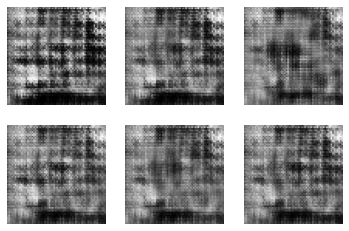

4601 [D loss: 0.712427, acc.: 39.06%] [G loss: 0.742942]
4602 [D loss: 0.699437, acc.: 41.80%] [G loss: 0.739867]
4603 [D loss: 0.702429, acc.: 34.77%] [G loss: 0.748927]
4604 [D loss: 0.703432, acc.: 43.36%] [G loss: 0.749346]
4605 [D loss: 0.717193, acc.: 46.09%] [G loss: 0.752081]
4606 [D loss: 0.692634, acc.: 61.72%] [G loss: 0.760905]
4607 [D loss: 0.707817, acc.: 59.77%] [G loss: 0.760239]
4608 [D loss: 0.682586, acc.: 71.48%] [G loss: 0.776504]
4609 [D loss: 0.651471, acc.: 74.61%] [G loss: 0.784582]
4610 [D loss: 0.654923, acc.: 72.27%] [G loss: 0.787844]
4611 [D loss: 0.661409, acc.: 69.92%] [G loss: 0.793917]
4612 [D loss: 0.663035, acc.: 75.00%] [G loss: 0.791516]
4613 [D loss: 0.652327, acc.: 72.27%] [G loss: 0.790456]
4614 [D loss: 0.636302, acc.: 74.22%] [G loss: 0.783714]
4615 [D loss: 0.637640, acc.: 76.95%] [G loss: 0.781476]
4616 [D loss: 0.665794, acc.: 72.27%] [G loss: 0.778526]
4617 [D loss: 0.635582, acc.: 75.78%] [G loss: 0.771186]
4618 [D loss: 0.630403, acc.: 7

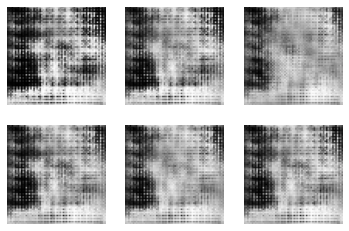

4651 [D loss: 0.681369, acc.: 49.22%] [G loss: 0.730783]
4652 [D loss: 0.744207, acc.: 33.20%] [G loss: 0.642616]
4653 [D loss: 0.737327, acc.: 37.50%] [G loss: 0.614340]
4654 [D loss: 0.732919, acc.: 35.94%] [G loss: 0.605302]
4655 [D loss: 0.749948, acc.: 32.81%] [G loss: 0.597164]
4656 [D loss: 0.750076, acc.: 35.16%] [G loss: 0.595724]
4657 [D loss: 0.733658, acc.: 37.50%] [G loss: 0.601187]
4658 [D loss: 0.745113, acc.: 32.81%] [G loss: 0.612649]
4659 [D loss: 0.743572, acc.: 32.03%] [G loss: 0.616295]
4660 [D loss: 0.733587, acc.: 32.81%] [G loss: 0.634183]
4661 [D loss: 0.715689, acc.: 33.20%] [G loss: 0.646945]
4662 [D loss: 0.705126, acc.: 35.94%] [G loss: 0.657940]
4663 [D loss: 0.711641, acc.: 32.42%] [G loss: 0.670132]
4664 [D loss: 0.704202, acc.: 32.03%] [G loss: 0.681170]
4665 [D loss: 0.698885, acc.: 32.42%] [G loss: 0.694194]
4666 [D loss: 0.684737, acc.: 44.14%] [G loss: 0.705329]
4667 [D loss: 0.679179, acc.: 50.78%] [G loss: 0.714866]
4668 [D loss: 0.681010, acc.: 5

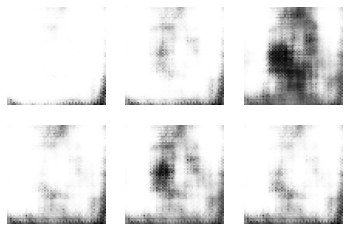

4701 [D loss: 0.519529, acc.: 73.05%] [G loss: 1.486546]
4702 [D loss: 0.475416, acc.: 78.12%] [G loss: 1.633927]
4703 [D loss: 0.423551, acc.: 84.77%] [G loss: 1.761245]
4704 [D loss: 0.421439, acc.: 81.25%] [G loss: 1.844243]
4705 [D loss: 0.414809, acc.: 85.94%] [G loss: 1.812187]
4706 [D loss: 0.390809, acc.: 90.23%] [G loss: 1.799866]
4707 [D loss: 0.389411, acc.: 89.06%] [G loss: 1.679400]
4708 [D loss: 0.411667, acc.: 91.80%] [G loss: 1.499416]
4709 [D loss: 0.474305, acc.: 91.02%] [G loss: 1.187809]
4710 [D loss: 0.644042, acc.: 60.16%] [G loss: 0.752111]
4711 [D loss: 0.817594, acc.: 44.92%] [G loss: 0.494195]
4712 [D loss: 0.859957, acc.: 43.75%] [G loss: 0.487156]
4713 [D loss: 0.789194, acc.: 39.45%] [G loss: 0.614420]
4714 [D loss: 0.691580, acc.: 46.09%] [G loss: 0.810156]
4715 [D loss: 0.674709, acc.: 66.80%] [G loss: 0.942357]
4716 [D loss: 0.674181, acc.: 64.84%] [G loss: 0.898653]
4717 [D loss: 0.703657, acc.: 54.30%] [G loss: 0.775217]
4718 [D loss: 0.722096, acc.: 3

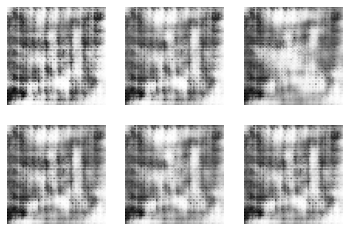

4751 [D loss: 0.623414, acc.: 74.22%] [G loss: 0.918784]
4752 [D loss: 0.641871, acc.: 73.83%] [G loss: 0.906650]
4753 [D loss: 0.647951, acc.: 73.83%] [G loss: 0.896451]
4754 [D loss: 0.646013, acc.: 73.83%] [G loss: 0.881064]
4755 [D loss: 0.645116, acc.: 76.56%] [G loss: 0.861478]
4756 [D loss: 0.638317, acc.: 77.73%] [G loss: 0.842900]
4757 [D loss: 0.660694, acc.: 75.00%] [G loss: 0.819409]
4758 [D loss: 0.674359, acc.: 73.83%] [G loss: 0.799022]
4759 [D loss: 0.688183, acc.: 60.55%] [G loss: 0.769606]
4760 [D loss: 0.715315, acc.: 36.33%] [G loss: 0.738189]
4761 [D loss: 0.735936, acc.: 23.05%] [G loss: 0.707035]
4762 [D loss: 0.723787, acc.: 26.17%] [G loss: 0.677611]
4763 [D loss: 0.734227, acc.: 27.73%] [G loss: 0.670006]
4764 [D loss: 0.751254, acc.: 25.39%] [G loss: 0.687664]
4765 [D loss: 0.734213, acc.: 27.73%] [G loss: 0.729938]
4766 [D loss: 0.703234, acc.: 48.44%] [G loss: 0.811311]
4767 [D loss: 0.641429, acc.: 69.92%] [G loss: 0.901952]
4768 [D loss: 0.625434, acc.: 7

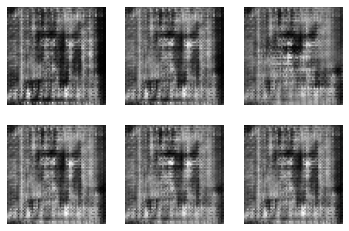

4801 [D loss: 0.696284, acc.: 54.30%] [G loss: 0.757880]
4802 [D loss: 0.720406, acc.: 46.88%] [G loss: 0.753085]
4803 [D loss: 0.709007, acc.: 48.05%] [G loss: 0.742156]
4804 [D loss: 0.725094, acc.: 42.58%] [G loss: 0.751941]
4805 [D loss: 0.717338, acc.: 47.27%] [G loss: 0.771722]
4806 [D loss: 0.688379, acc.: 51.17%] [G loss: 0.802731]
4807 [D loss: 0.701358, acc.: 51.56%] [G loss: 0.819745]
4808 [D loss: 0.658038, acc.: 69.92%] [G loss: 0.858704]
4809 [D loss: 0.642218, acc.: 70.31%] [G loss: 0.897160]
4810 [D loss: 0.641361, acc.: 70.31%] [G loss: 0.928528]
4811 [D loss: 0.607488, acc.: 73.44%] [G loss: 0.928805]
4812 [D loss: 0.633781, acc.: 71.88%] [G loss: 0.934553]
4813 [D loss: 0.633174, acc.: 77.34%] [G loss: 0.919308]
4814 [D loss: 0.629756, acc.: 73.05%] [G loss: 0.912127]
4815 [D loss: 0.603884, acc.: 80.86%] [G loss: 0.887318]
4816 [D loss: 0.631627, acc.: 80.08%] [G loss: 0.866569]
4817 [D loss: 0.653166, acc.: 75.00%] [G loss: 0.837483]
4818 [D loss: 0.690806, acc.: 6

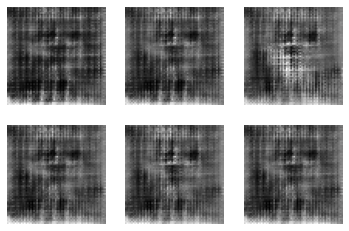

4851 [D loss: 0.772891, acc.: 28.91%] [G loss: 0.595158]
4852 [D loss: 0.785751, acc.: 28.12%] [G loss: 0.575676]
4853 [D loss: 0.826697, acc.: 23.05%] [G loss: 0.575161]
4854 [D loss: 0.813822, acc.: 21.48%] [G loss: 0.596658]
4855 [D loss: 0.807621, acc.: 18.75%] [G loss: 0.624433]
4856 [D loss: 0.752345, acc.: 39.45%] [G loss: 0.709767]
4857 [D loss: 0.708680, acc.: 49.61%] [G loss: 0.787268]
4858 [D loss: 0.668661, acc.: 47.27%] [G loss: 0.876683]
4859 [D loss: 0.631900, acc.: 71.48%] [G loss: 0.994025]
4860 [D loss: 0.588033, acc.: 74.22%] [G loss: 1.066297]
4861 [D loss: 0.567893, acc.: 78.91%] [G loss: 1.092687]
4862 [D loss: 0.554988, acc.: 83.98%] [G loss: 1.106602]
4863 [D loss: 0.541626, acc.: 85.16%] [G loss: 1.089922]
4864 [D loss: 0.551469, acc.: 87.50%] [G loss: 1.014289]
4865 [D loss: 0.592739, acc.: 85.16%] [G loss: 0.924766]
4866 [D loss: 0.607134, acc.: 88.67%] [G loss: 0.840600]
4867 [D loss: 0.631641, acc.: 78.12%] [G loss: 0.775619]
4868 [D loss: 0.649463, acc.: 5

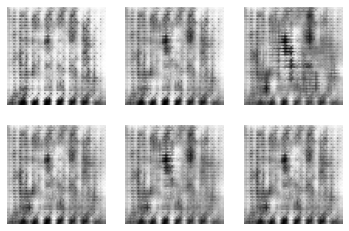

4901 [D loss: 0.668126, acc.: 64.84%] [G loss: 0.791080]
4902 [D loss: 0.670934, acc.: 69.14%] [G loss: 0.809186]
4903 [D loss: 0.654038, acc.: 72.66%] [G loss: 0.810361]
4904 [D loss: 0.643753, acc.: 75.39%] [G loss: 0.823233]
4905 [D loss: 0.647844, acc.: 73.83%] [G loss: 0.829040]
4906 [D loss: 0.643336, acc.: 75.00%] [G loss: 0.840997]
4907 [D loss: 0.617677, acc.: 81.25%] [G loss: 0.847884]
4908 [D loss: 0.629989, acc.: 76.17%] [G loss: 0.847522]
4909 [D loss: 0.640429, acc.: 74.61%] [G loss: 0.848619]
4910 [D loss: 0.636284, acc.: 75.39%] [G loss: 0.849784]
4911 [D loss: 0.611405, acc.: 82.03%] [G loss: 0.844098]
4912 [D loss: 0.639944, acc.: 75.39%] [G loss: 0.838242]
4913 [D loss: 0.631048, acc.: 79.69%] [G loss: 0.825018]
4914 [D loss: 0.633027, acc.: 78.52%] [G loss: 0.812088]
4915 [D loss: 0.646959, acc.: 79.69%] [G loss: 0.794984]
4916 [D loss: 0.655364, acc.: 74.61%] [G loss: 0.781022]
4917 [D loss: 0.680728, acc.: 68.36%] [G loss: 0.771607]
4918 [D loss: 0.667456, acc.: 6

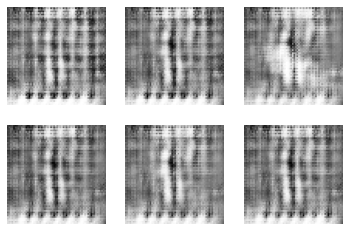

4951 [D loss: 0.630986, acc.: 76.56%] [G loss: 0.879549]
4952 [D loss: 0.618864, acc.: 80.86%] [G loss: 0.893076]
4953 [D loss: 0.604344, acc.: 83.20%] [G loss: 0.913808]
4954 [D loss: 0.608954, acc.: 81.64%] [G loss: 0.908535]
4955 [D loss: 0.623495, acc.: 78.91%] [G loss: 0.883357]
4956 [D loss: 0.613958, acc.: 81.64%] [G loss: 0.878142]
4957 [D loss: 0.629255, acc.: 83.20%] [G loss: 0.846393]
4958 [D loss: 0.628419, acc.: 82.42%] [G loss: 0.819865]
4959 [D loss: 0.638612, acc.: 83.98%] [G loss: 0.794297]
4960 [D loss: 0.642744, acc.: 75.39%] [G loss: 0.767938]
4961 [D loss: 0.662330, acc.: 57.81%] [G loss: 0.748280]
4962 [D loss: 0.655397, acc.: 62.50%] [G loss: 0.739368]
4963 [D loss: 0.656365, acc.: 57.42%] [G loss: 0.733220]
4964 [D loss: 0.669652, acc.: 61.33%] [G loss: 0.731860]
4965 [D loss: 0.683095, acc.: 55.47%] [G loss: 0.725674]
4966 [D loss: 0.682125, acc.: 52.73%] [G loss: 0.713729]
4967 [D loss: 0.700678, acc.: 47.27%] [G loss: 0.702058]
4968 [D loss: 0.710466, acc.: 3

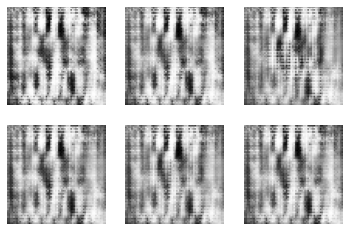

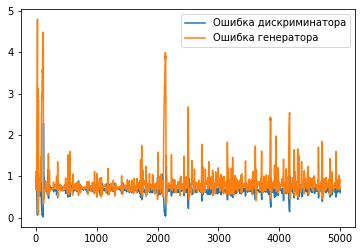

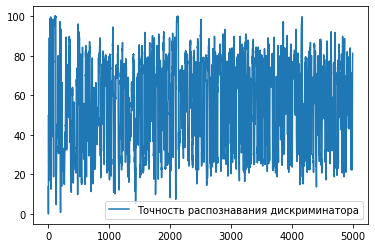

In [34]:
generator = create_generator(img_shape) # Вызываем функцию create_generator и записываем значение в переменную generator
discriminator = create_discriminator(img_shape) # Вызываем функцию create_discriminator и записываем значение в переменную discriminator
train(generator, discriminator, 5000)

0 [D loss: 0.587619, acc.: 82.42%] [G loss: 0.926160]


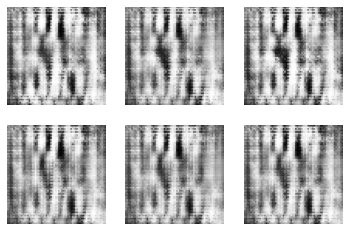

1 [D loss: 0.583408, acc.: 85.16%] [G loss: 0.933879]
2 [D loss: 0.571015, acc.: 86.33%] [G loss: 0.925329]
3 [D loss: 0.586721, acc.: 85.55%] [G loss: 0.906301]
4 [D loss: 0.593951, acc.: 85.16%] [G loss: 0.890174]
5 [D loss: 0.577180, acc.: 83.98%] [G loss: 0.875911]
6 [D loss: 0.593071, acc.: 70.31%] [G loss: 0.850712]
7 [D loss: 0.633200, acc.: 56.64%] [G loss: 0.830481]
8 [D loss: 0.635913, acc.: 62.89%] [G loss: 0.822721]
9 [D loss: 0.627547, acc.: 61.33%] [G loss: 0.804617]
10 [D loss: 0.642391, acc.: 61.72%] [G loss: 0.793381]
11 [D loss: 0.655290, acc.: 51.56%] [G loss: 0.780081]
12 [D loss: 0.678551, acc.: 51.56%] [G loss: 0.769110]
13 [D loss: 0.680974, acc.: 44.14%] [G loss: 0.760641]
14 [D loss: 0.684574, acc.: 44.53%] [G loss: 0.771071]
15 [D loss: 0.712138, acc.: 35.94%] [G loss: 0.777067]
16 [D loss: 0.712577, acc.: 36.33%] [G loss: 0.797833]
17 [D loss: 0.709881, acc.: 37.50%] [G loss: 0.840766]
18 [D loss: 0.679424, acc.: 50.39%] [G loss: 0.926184]
19 [D loss: 0.68798

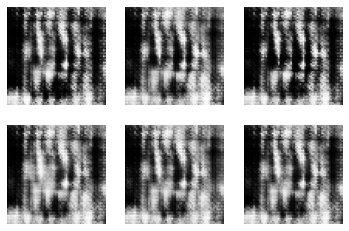

51 [D loss: 0.657907, acc.: 73.83%] [G loss: 0.853524]
52 [D loss: 0.639801, acc.: 76.95%] [G loss: 0.882116]
53 [D loss: 0.639700, acc.: 81.25%] [G loss: 0.881569]
54 [D loss: 0.627806, acc.: 85.94%] [G loss: 0.895499]
55 [D loss: 0.628870, acc.: 83.98%] [G loss: 0.893784]
56 [D loss: 0.639059, acc.: 83.59%] [G loss: 0.878565]
57 [D loss: 0.637867, acc.: 82.81%] [G loss: 0.866868]
58 [D loss: 0.637794, acc.: 83.20%] [G loss: 0.864811]
59 [D loss: 0.650661, acc.: 80.86%] [G loss: 0.841487]
60 [D loss: 0.653974, acc.: 79.69%] [G loss: 0.822649]
61 [D loss: 0.670969, acc.: 65.23%] [G loss: 0.797850]
62 [D loss: 0.680761, acc.: 53.12%] [G loss: 0.777902]
63 [D loss: 0.679443, acc.: 53.12%] [G loss: 0.765553]
64 [D loss: 0.676460, acc.: 48.83%] [G loss: 0.752815]
65 [D loss: 0.680841, acc.: 46.48%] [G loss: 0.750116]
66 [D loss: 0.689406, acc.: 44.14%] [G loss: 0.746808]
67 [D loss: 0.688803, acc.: 41.80%] [G loss: 0.744909]
68 [D loss: 0.681327, acc.: 47.27%] [G loss: 0.753671]
69 [D loss

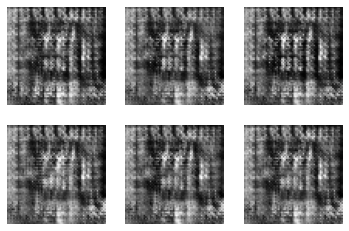

101 [D loss: 0.712561, acc.: 35.55%] [G loss: 0.742070]
102 [D loss: 0.729126, acc.: 22.66%] [G loss: 0.733955]
103 [D loss: 0.712476, acc.: 28.91%] [G loss: 0.739961]
104 [D loss: 0.697432, acc.: 37.50%] [G loss: 0.752987]
105 [D loss: 0.682516, acc.: 55.86%] [G loss: 0.767859]
106 [D loss: 0.690087, acc.: 60.55%] [G loss: 0.780068]
107 [D loss: 0.709508, acc.: 58.98%] [G loss: 0.784406]
108 [D loss: 0.694220, acc.: 60.94%] [G loss: 0.789449]
109 [D loss: 0.690230, acc.: 62.89%] [G loss: 0.791262]
110 [D loss: 0.692557, acc.: 50.00%] [G loss: 0.771554]
111 [D loss: 0.700186, acc.: 43.36%] [G loss: 0.761320]
112 [D loss: 0.726223, acc.: 25.00%] [G loss: 0.730401]
113 [D loss: 0.726144, acc.: 27.34%] [G loss: 0.710858]
114 [D loss: 0.750884, acc.: 21.48%] [G loss: 0.699127]
115 [D loss: 0.754861, acc.: 25.00%] [G loss: 0.693502]
116 [D loss: 0.781642, acc.: 22.66%] [G loss: 0.713080]
117 [D loss: 0.768648, acc.: 20.70%] [G loss: 0.780293]
118 [D loss: 0.766723, acc.: 23.83%] [G loss: 0.

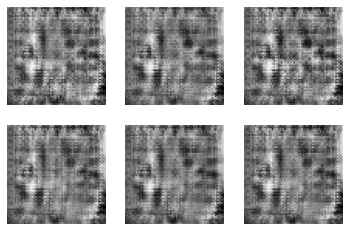

151 [D loss: 0.783095, acc.: 26.95%] [G loss: 0.602855]
152 [D loss: 0.781570, acc.: 25.78%] [G loss: 0.611606]
153 [D loss: 0.766892, acc.: 25.78%] [G loss: 0.626185]
154 [D loss: 0.753326, acc.: 26.56%] [G loss: 0.639094]
155 [D loss: 0.747339, acc.: 22.66%] [G loss: 0.648840]
156 [D loss: 0.740994, acc.: 25.39%] [G loss: 0.658675]
157 [D loss: 0.726337, acc.: 27.73%] [G loss: 0.673786]
158 [D loss: 0.719588, acc.: 27.73%] [G loss: 0.677709]
159 [D loss: 0.709592, acc.: 37.89%] [G loss: 0.693925]
160 [D loss: 0.713503, acc.: 40.62%] [G loss: 0.695892]
161 [D loss: 0.698521, acc.: 46.88%] [G loss: 0.699075]
162 [D loss: 0.691131, acc.: 53.52%] [G loss: 0.711021]
163 [D loss: 0.684473, acc.: 50.00%] [G loss: 0.718269]
164 [D loss: 0.681835, acc.: 53.91%] [G loss: 0.727966]
165 [D loss: 0.668705, acc.: 54.30%] [G loss: 0.741610]
166 [D loss: 0.673453, acc.: 52.73%] [G loss: 0.751320]
167 [D loss: 0.664612, acc.: 57.03%] [G loss: 0.751291]
168 [D loss: 0.656793, acc.: 60.16%] [G loss: 0.

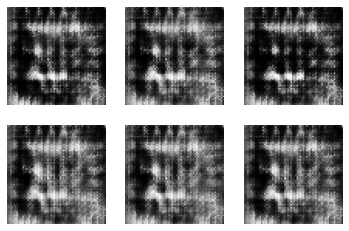

201 [D loss: 0.635185, acc.: 76.56%] [G loss: 0.864711]
202 [D loss: 0.654023, acc.: 66.80%] [G loss: 0.803812]
203 [D loss: 0.695727, acc.: 35.16%] [G loss: 0.717368]
204 [D loss: 0.742364, acc.: 26.56%] [G loss: 0.660040]
205 [D loss: 0.766398, acc.: 24.61%] [G loss: 0.618087]
206 [D loss: 0.793902, acc.: 26.17%] [G loss: 0.585882]
207 [D loss: 0.792456, acc.: 21.88%] [G loss: 0.586518]
208 [D loss: 0.764605, acc.: 27.73%] [G loss: 0.584543]
209 [D loss: 0.779844, acc.: 23.05%] [G loss: 0.602248]
210 [D loss: 0.780166, acc.: 23.83%] [G loss: 0.616597]
211 [D loss: 0.766637, acc.: 22.27%] [G loss: 0.645176]
212 [D loss: 0.758858, acc.: 19.14%] [G loss: 0.685208]
213 [D loss: 0.711894, acc.: 29.69%] [G loss: 0.733359]
214 [D loss: 0.675142, acc.: 54.69%] [G loss: 0.814048]
215 [D loss: 0.661333, acc.: 63.28%] [G loss: 0.853991]
216 [D loss: 0.631489, acc.: 73.44%] [G loss: 0.936558]
217 [D loss: 0.612883, acc.: 74.22%] [G loss: 0.972814]
218 [D loss: 0.591078, acc.: 79.69%] [G loss: 1.

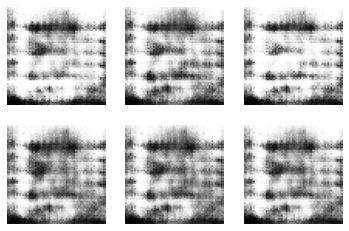

251 [D loss: 0.680488, acc.: 72.27%] [G loss: 0.840939]
252 [D loss: 0.655826, acc.: 71.09%] [G loss: 0.895890]
253 [D loss: 0.631280, acc.: 76.17%] [G loss: 0.937786]
254 [D loss: 0.594663, acc.: 80.86%] [G loss: 0.983892]
255 [D loss: 0.600052, acc.: 76.95%] [G loss: 1.019843]
256 [D loss: 0.580695, acc.: 80.86%] [G loss: 1.041098]
257 [D loss: 0.564019, acc.: 83.98%] [G loss: 1.036231]
258 [D loss: 0.569674, acc.: 81.64%] [G loss: 1.054977]
259 [D loss: 0.567737, acc.: 81.25%] [G loss: 1.032907]
260 [D loss: 0.570814, acc.: 86.33%] [G loss: 0.976949]
261 [D loss: 0.595768, acc.: 84.38%] [G loss: 0.926504]
262 [D loss: 0.601836, acc.: 86.33%] [G loss: 0.877169]
263 [D loss: 0.614846, acc.: 85.55%] [G loss: 0.830417]
264 [D loss: 0.647663, acc.: 73.83%] [G loss: 0.786554]
265 [D loss: 0.644314, acc.: 67.19%] [G loss: 0.766957]
266 [D loss: 0.670741, acc.: 53.12%] [G loss: 0.754167]
267 [D loss: 0.666946, acc.: 43.36%] [G loss: 0.736783]
268 [D loss: 0.683954, acc.: 35.55%] [G loss: 0.

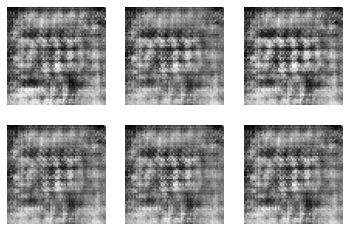

301 [D loss: 0.734007, acc.: 37.11%] [G loss: 0.696136]
302 [D loss: 0.739086, acc.: 33.20%] [G loss: 0.676337]
303 [D loss: 0.757380, acc.: 29.30%] [G loss: 0.679163]
304 [D loss: 0.769312, acc.: 22.66%] [G loss: 0.647340]
305 [D loss: 0.821627, acc.: 14.84%] [G loss: 0.615766]
306 [D loss: 0.863375, acc.: 16.80%] [G loss: 0.554416]
307 [D loss: 0.881274, acc.: 16.41%] [G loss: 0.546262]
308 [D loss: 0.884104, acc.: 13.28%] [G loss: 0.553319]
309 [D loss: 0.863928, acc.: 12.11%] [G loss: 0.600149]
310 [D loss: 0.821869, acc.: 10.16%] [G loss: 0.662763]
311 [D loss: 0.763855, acc.: 14.84%] [G loss: 0.757425]
312 [D loss: 0.705662, acc.: 60.55%] [G loss: 0.868300]
313 [D loss: 0.643430, acc.: 67.19%] [G loss: 0.983212]
314 [D loss: 0.600730, acc.: 72.66%] [G loss: 1.091197]
315 [D loss: 0.561574, acc.: 76.17%] [G loss: 1.161873]
316 [D loss: 0.544870, acc.: 80.08%] [G loss: 1.138496]
317 [D loss: 0.544747, acc.: 85.55%] [G loss: 1.119943]
318 [D loss: 0.547927, acc.: 86.33%] [G loss: 1.

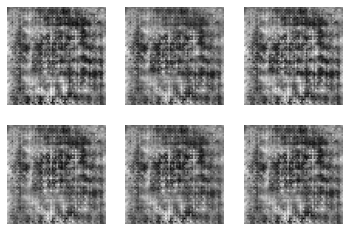

351 [D loss: 0.743017, acc.: 19.92%] [G loss: 0.674827]
352 [D loss: 0.740915, acc.: 20.70%] [G loss: 0.681261]
353 [D loss: 0.732406, acc.: 23.44%] [G loss: 0.684922]
354 [D loss: 0.739467, acc.: 17.58%] [G loss: 0.687801]
355 [D loss: 0.743037, acc.: 16.80%] [G loss: 0.689011]
356 [D loss: 0.736966, acc.: 19.53%] [G loss: 0.692602]
357 [D loss: 0.735379, acc.: 21.09%] [G loss: 0.690559]
358 [D loss: 0.727826, acc.: 24.22%] [G loss: 0.697116]
359 [D loss: 0.739174, acc.: 21.88%] [G loss: 0.701683]
360 [D loss: 0.739172, acc.: 19.14%] [G loss: 0.701650]
361 [D loss: 0.724766, acc.: 30.08%] [G loss: 0.709859]
362 [D loss: 0.740729, acc.: 23.05%] [G loss: 0.706229]
363 [D loss: 0.734238, acc.: 27.34%] [G loss: 0.704494]
364 [D loss: 0.725372, acc.: 28.12%] [G loss: 0.709883]
365 [D loss: 0.728642, acc.: 28.12%] [G loss: 0.712254]
366 [D loss: 0.717983, acc.: 35.55%] [G loss: 0.719467]
367 [D loss: 0.726078, acc.: 38.28%] [G loss: 0.719972]
368 [D loss: 0.719284, acc.: 37.50%] [G loss: 0.

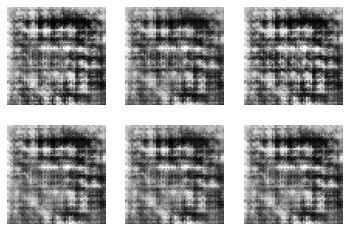

401 [D loss: 0.631263, acc.: 78.52%] [G loss: 0.792008]
402 [D loss: 0.647871, acc.: 78.52%] [G loss: 0.779747]
403 [D loss: 0.639676, acc.: 76.17%] [G loss: 0.761861]
404 [D loss: 0.659230, acc.: 55.86%] [G loss: 0.752990]
405 [D loss: 0.662825, acc.: 55.47%] [G loss: 0.747174]
406 [D loss: 0.659788, acc.: 58.20%] [G loss: 0.756415]
407 [D loss: 0.667432, acc.: 53.12%] [G loss: 0.775049]
408 [D loss: 0.660292, acc.: 50.78%] [G loss: 0.803964]
409 [D loss: 0.629970, acc.: 58.20%] [G loss: 0.840554]
410 [D loss: 0.618682, acc.: 75.78%] [G loss: 0.901720]
411 [D loss: 0.610540, acc.: 76.56%] [G loss: 0.931449]
412 [D loss: 0.606667, acc.: 76.56%] [G loss: 0.956414]
413 [D loss: 0.590308, acc.: 75.78%] [G loss: 0.996315]
414 [D loss: 0.577593, acc.: 78.12%] [G loss: 0.980950]
415 [D loss: 0.575187, acc.: 78.52%] [G loss: 1.003672]
416 [D loss: 0.587032, acc.: 78.91%] [G loss: 0.952901]
417 [D loss: 0.609524, acc.: 77.34%] [G loss: 0.920370]
418 [D loss: 0.606099, acc.: 79.30%] [G loss: 0.

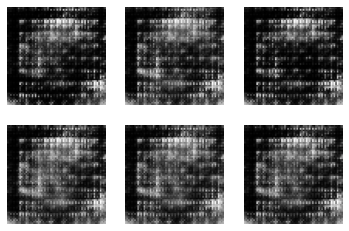

451 [D loss: 0.702754, acc.: 67.19%] [G loss: 0.921613]
452 [D loss: 0.746363, acc.: 28.12%] [G loss: 0.775824]
453 [D loss: 0.777990, acc.: 20.70%] [G loss: 0.715961]
454 [D loss: 0.805234, acc.: 19.53%] [G loss: 0.691761]
455 [D loss: 0.768054, acc.: 25.78%] [G loss: 0.677396]
456 [D loss: 0.790888, acc.: 21.48%] [G loss: 0.668078]
457 [D loss: 0.773250, acc.: 23.83%] [G loss: 0.650795]
458 [D loss: 0.769813, acc.: 25.00%] [G loss: 0.653048]
459 [D loss: 0.773104, acc.: 21.48%] [G loss: 0.668074]
460 [D loss: 0.743134, acc.: 26.17%] [G loss: 0.685661]
461 [D loss: 0.730094, acc.: 27.34%] [G loss: 0.705769]
462 [D loss: 0.710416, acc.: 28.52%] [G loss: 0.720976]
463 [D loss: 0.719842, acc.: 27.73%] [G loss: 0.727825]
464 [D loss: 0.710789, acc.: 30.08%] [G loss: 0.722140]
465 [D loss: 0.712814, acc.: 26.56%] [G loss: 0.714053]
466 [D loss: 0.724077, acc.: 26.17%] [G loss: 0.697829]
467 [D loss: 0.710575, acc.: 31.25%] [G loss: 0.688447]
468 [D loss: 0.736117, acc.: 25.00%] [G loss: 0.

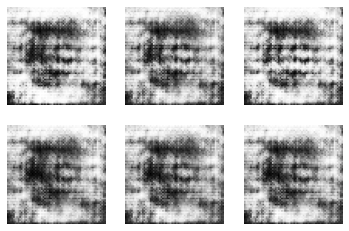

501 [D loss: 0.735525, acc.: 23.44%] [G loss: 0.715707]
502 [D loss: 0.727569, acc.: 26.56%] [G loss: 0.706670]
503 [D loss: 0.736475, acc.: 24.22%] [G loss: 0.712807]
504 [D loss: 0.722623, acc.: 26.95%] [G loss: 0.727566]
505 [D loss: 0.725039, acc.: 29.69%] [G loss: 0.735968]
506 [D loss: 0.708976, acc.: 45.31%] [G loss: 0.767926]
507 [D loss: 0.692273, acc.: 57.81%] [G loss: 0.830698]
508 [D loss: 0.659899, acc.: 68.36%] [G loss: 0.927025]
509 [D loss: 0.612834, acc.: 76.56%] [G loss: 1.036504]
510 [D loss: 0.573337, acc.: 79.69%] [G loss: 1.127154]
511 [D loss: 0.568637, acc.: 80.47%] [G loss: 1.144007]
512 [D loss: 0.576079, acc.: 76.95%] [G loss: 1.104936]
513 [D loss: 0.602850, acc.: 78.52%] [G loss: 0.998674]
514 [D loss: 0.644249, acc.: 80.86%] [G loss: 0.863644]
515 [D loss: 0.669648, acc.: 57.81%] [G loss: 0.766448]
516 [D loss: 0.712009, acc.: 39.45%] [G loss: 0.686259]
517 [D loss: 0.736328, acc.: 28.52%] [G loss: 0.645142]
518 [D loss: 0.738167, acc.: 29.30%] [G loss: 0.

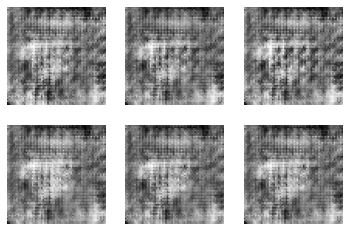

551 [D loss: 0.733769, acc.: 26.17%] [G loss: 0.650700]
552 [D loss: 0.727811, acc.: 26.95%] [G loss: 0.635194]
553 [D loss: 0.747455, acc.: 25.78%] [G loss: 0.616941]
554 [D loss: 0.759217, acc.: 27.34%] [G loss: 0.606515]
555 [D loss: 0.758719, acc.: 24.61%] [G loss: 0.612799]
556 [D loss: 0.750318, acc.: 25.78%] [G loss: 0.626288]
557 [D loss: 0.734475, acc.: 25.78%] [G loss: 0.660771]
558 [D loss: 0.718105, acc.: 20.31%] [G loss: 0.708691]
559 [D loss: 0.684547, acc.: 52.34%] [G loss: 0.760887]
560 [D loss: 0.635688, acc.: 78.52%] [G loss: 0.834311]
561 [D loss: 0.617690, acc.: 75.78%] [G loss: 0.898380]
562 [D loss: 0.596804, acc.: 77.73%] [G loss: 0.946921]
563 [D loss: 0.576203, acc.: 81.64%] [G loss: 0.979318]
564 [D loss: 0.565295, acc.: 83.20%] [G loss: 0.976653]
565 [D loss: 0.590837, acc.: 79.69%] [G loss: 0.910694]
566 [D loss: 0.602214, acc.: 83.20%] [G loss: 0.838493]
567 [D loss: 0.615560, acc.: 81.25%] [G loss: 0.796086]
568 [D loss: 0.613902, acc.: 85.16%] [G loss: 0.

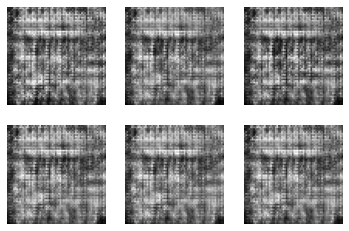

601 [D loss: 0.710304, acc.: 61.33%] [G loss: 0.745416]
602 [D loss: 0.709863, acc.: 47.66%] [G loss: 0.735066]
603 [D loss: 0.699434, acc.: 48.44%] [G loss: 0.727210]
604 [D loss: 0.739813, acc.: 34.38%] [G loss: 0.719534]
605 [D loss: 0.724490, acc.: 34.77%] [G loss: 0.711278]
606 [D loss: 0.730474, acc.: 28.12%] [G loss: 0.706117]
607 [D loss: 0.714078, acc.: 30.47%] [G loss: 0.707432]
608 [D loss: 0.727571, acc.: 26.56%] [G loss: 0.712063]
609 [D loss: 0.713122, acc.: 35.94%] [G loss: 0.714704]
610 [D loss: 0.704470, acc.: 44.53%] [G loss: 0.720224]
611 [D loss: 0.699559, acc.: 47.66%] [G loss: 0.724416]
612 [D loss: 0.688536, acc.: 58.20%] [G loss: 0.729811]
613 [D loss: 0.705428, acc.: 54.30%] [G loss: 0.729915]
614 [D loss: 0.701083, acc.: 54.30%] [G loss: 0.731633]
615 [D loss: 0.720797, acc.: 44.53%] [G loss: 0.725977]
616 [D loss: 0.712210, acc.: 46.48%] [G loss: 0.725996]
617 [D loss: 0.691037, acc.: 43.75%] [G loss: 0.723860]
618 [D loss: 0.713569, acc.: 33.20%] [G loss: 0.

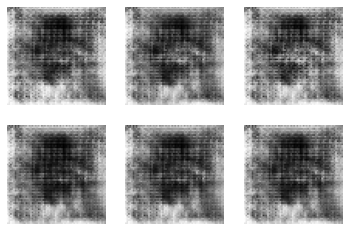

651 [D loss: 0.764448, acc.: 24.61%] [G loss: 0.640952]
652 [D loss: 0.759033, acc.: 22.27%] [G loss: 0.642065]
653 [D loss: 0.774148, acc.: 21.09%] [G loss: 0.654086]
654 [D loss: 0.771992, acc.: 17.58%] [G loss: 0.682558]
655 [D loss: 0.725820, acc.: 21.09%] [G loss: 0.717510]
656 [D loss: 0.718470, acc.: 38.67%] [G loss: 0.756348]
657 [D loss: 0.703246, acc.: 60.55%] [G loss: 0.789540]
658 [D loss: 0.698712, acc.: 65.23%] [G loss: 0.827619]
659 [D loss: 0.681658, acc.: 66.02%] [G loss: 0.855527]
660 [D loss: 0.678829, acc.: 53.91%] [G loss: 0.864368]
661 [D loss: 0.669403, acc.: 46.09%] [G loss: 0.923618]
662 [D loss: 0.658772, acc.: 47.27%] [G loss: 0.956244]
663 [D loss: 0.643486, acc.: 56.64%] [G loss: 1.015860]
664 [D loss: 0.609484, acc.: 72.66%] [G loss: 1.128143]
665 [D loss: 0.566796, acc.: 75.00%] [G loss: 1.253066]
666 [D loss: 0.543791, acc.: 71.09%] [G loss: 1.406956]
667 [D loss: 0.512913, acc.: 80.08%] [G loss: 1.498915]
668 [D loss: 0.494534, acc.: 81.25%] [G loss: 1.

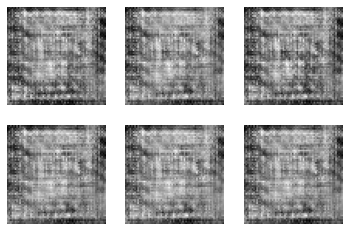

701 [D loss: 0.671004, acc.: 67.19%] [G loss: 0.779857]
702 [D loss: 0.664132, acc.: 69.14%] [G loss: 0.785262]
703 [D loss: 0.656482, acc.: 72.66%] [G loss: 0.791458]
704 [D loss: 0.649656, acc.: 74.61%] [G loss: 0.793762]
705 [D loss: 0.660927, acc.: 70.31%] [G loss: 0.798220]
706 [D loss: 0.649014, acc.: 74.22%] [G loss: 0.797393]
707 [D loss: 0.658317, acc.: 69.53%] [G loss: 0.799110]
708 [D loss: 0.668247, acc.: 68.75%] [G loss: 0.790688]
709 [D loss: 0.648759, acc.: 75.00%] [G loss: 0.786816]
710 [D loss: 0.665650, acc.: 71.48%] [G loss: 0.781870]
711 [D loss: 0.655334, acc.: 75.00%] [G loss: 0.786367]
712 [D loss: 0.670970, acc.: 69.92%] [G loss: 0.776240]
713 [D loss: 0.661893, acc.: 77.34%] [G loss: 0.779069]
714 [D loss: 0.666382, acc.: 73.05%] [G loss: 0.764653]
715 [D loss: 0.665707, acc.: 76.17%] [G loss: 0.766500]
716 [D loss: 0.666970, acc.: 73.05%] [G loss: 0.766780]
717 [D loss: 0.666609, acc.: 74.61%] [G loss: 0.765026]
718 [D loss: 0.655557, acc.: 79.30%] [G loss: 0.

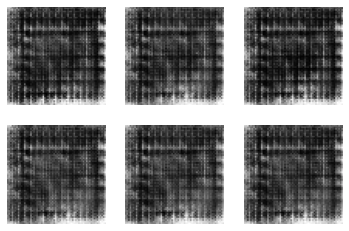

751 [D loss: 0.840225, acc.: 23.83%] [G loss: 0.537267]
752 [D loss: 0.854032, acc.: 25.00%] [G loss: 0.523046]
753 [D loss: 0.897993, acc.: 17.58%] [G loss: 0.520974]
754 [D loss: 0.854077, acc.: 22.27%] [G loss: 0.548279]
755 [D loss: 0.822119, acc.: 23.05%] [G loss: 0.611421]
756 [D loss: 0.761172, acc.: 21.48%] [G loss: 0.705411]
757 [D loss: 0.707696, acc.: 50.00%] [G loss: 0.840530]
758 [D loss: 0.650385, acc.: 68.36%] [G loss: 1.017965]
759 [D loss: 0.581661, acc.: 73.05%] [G loss: 1.185755]
760 [D loss: 0.545969, acc.: 71.48%] [G loss: 1.307457]
761 [D loss: 0.504145, acc.: 77.73%] [G loss: 1.424778]
762 [D loss: 0.532755, acc.: 70.31%] [G loss: 1.421426]
763 [D loss: 0.553744, acc.: 73.83%] [G loss: 1.264010]
764 [D loss: 0.592807, acc.: 76.17%] [G loss: 1.073443]
765 [D loss: 0.674541, acc.: 70.70%] [G loss: 0.889302]
766 [D loss: 0.691855, acc.: 71.88%] [G loss: 0.801970]
767 [D loss: 0.706814, acc.: 60.16%] [G loss: 0.753529]
768 [D loss: 0.706188, acc.: 51.17%] [G loss: 0.

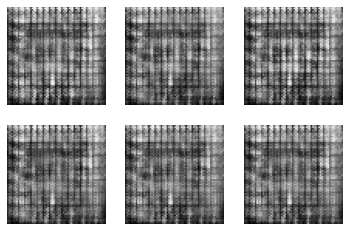

801 [D loss: 0.615033, acc.: 78.52%] [G loss: 0.843334]
802 [D loss: 0.596374, acc.: 78.91%] [G loss: 0.833168]
803 [D loss: 0.651618, acc.: 66.02%] [G loss: 0.796343]
804 [D loss: 0.665045, acc.: 40.62%] [G loss: 0.750159]
805 [D loss: 0.725494, acc.: 31.64%] [G loss: 0.676940]
806 [D loss: 0.795412, acc.: 29.69%] [G loss: 0.595447]
807 [D loss: 0.940100, acc.: 25.00%] [G loss: 0.516566]
808 [D loss: 1.064709, acc.: 19.92%] [G loss: 0.458435]
809 [D loss: 1.075803, acc.: 15.62%] [G loss: 0.482710]
810 [D loss: 1.006761, acc.: 12.50%] [G loss: 0.563988]
811 [D loss: 0.907802, acc.: 12.89%] [G loss: 0.684925]
812 [D loss: 0.775184, acc.: 34.38%] [G loss: 0.874209]
813 [D loss: 0.682096, acc.: 66.02%] [G loss: 1.072498]
814 [D loss: 0.603213, acc.: 67.97%] [G loss: 1.266328]
815 [D loss: 0.537058, acc.: 68.75%] [G loss: 1.501677]
816 [D loss: 0.464618, acc.: 78.12%] [G loss: 1.705275]
817 [D loss: 0.471110, acc.: 71.88%] [G loss: 1.910767]
818 [D loss: 0.406008, acc.: 78.52%] [G loss: 2.

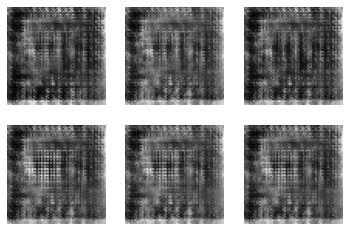

851 [D loss: 0.898149, acc.: 29.30%] [G loss: 0.515519]
852 [D loss: 0.864767, acc.: 34.38%] [G loss: 0.506642]
853 [D loss: 0.894120, acc.: 28.91%] [G loss: 0.502714]
854 [D loss: 0.915531, acc.: 26.56%] [G loss: 0.490895]
855 [D loss: 0.884272, acc.: 30.86%] [G loss: 0.505309]
856 [D loss: 0.856464, acc.: 30.47%] [G loss: 0.510696]
857 [D loss: 0.876280, acc.: 27.73%] [G loss: 0.518800]
858 [D loss: 0.839330, acc.: 30.08%] [G loss: 0.521441]
859 [D loss: 0.848432, acc.: 27.34%] [G loss: 0.533473]
860 [D loss: 0.843411, acc.: 26.95%] [G loss: 0.537579]
861 [D loss: 0.838943, acc.: 25.00%] [G loss: 0.545089]
862 [D loss: 0.813474, acc.: 27.73%] [G loss: 0.558164]
863 [D loss: 0.804796, acc.: 27.34%] [G loss: 0.565882]
864 [D loss: 0.778490, acc.: 31.64%] [G loss: 0.573636]
865 [D loss: 0.773703, acc.: 27.73%] [G loss: 0.585413]
866 [D loss: 0.757269, acc.: 30.86%] [G loss: 0.592661]
867 [D loss: 0.756413, acc.: 33.59%] [G loss: 0.602317]
868 [D loss: 0.723568, acc.: 35.94%] [G loss: 0.

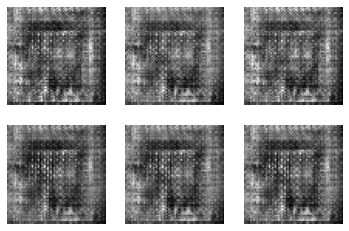

901 [D loss: 0.630067, acc.: 75.39%] [G loss: 0.860171]
902 [D loss: 0.626088, acc.: 74.22%] [G loss: 0.862026]
903 [D loss: 0.608356, acc.: 78.12%] [G loss: 0.879709]
904 [D loss: 0.623610, acc.: 73.83%] [G loss: 0.888839]
905 [D loss: 0.593999, acc.: 76.17%] [G loss: 0.900302]
906 [D loss: 0.612880, acc.: 73.83%] [G loss: 0.900209]
907 [D loss: 0.616666, acc.: 74.61%] [G loss: 0.889225]
908 [D loss: 0.598585, acc.: 76.95%] [G loss: 0.880443]
909 [D loss: 0.599203, acc.: 78.52%] [G loss: 0.862234]
910 [D loss: 0.628200, acc.: 73.83%] [G loss: 0.837933]
911 [D loss: 0.640318, acc.: 72.66%] [G loss: 0.804395]
912 [D loss: 0.676562, acc.: 50.00%] [G loss: 0.752156]
913 [D loss: 0.690583, acc.: 42.19%] [G loss: 0.722007]
914 [D loss: 0.699716, acc.: 42.58%] [G loss: 0.694761]
915 [D loss: 0.738782, acc.: 35.55%] [G loss: 0.658542]
916 [D loss: 0.737506, acc.: 36.33%] [G loss: 0.666587]
917 [D loss: 0.749934, acc.: 33.59%] [G loss: 0.657674]
918 [D loss: 0.757841, acc.: 31.25%] [G loss: 0.

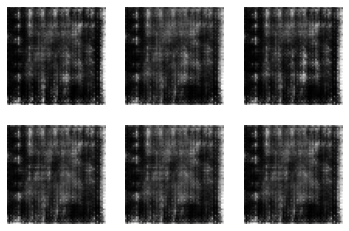

951 [D loss: 0.665567, acc.: 60.16%] [G loss: 0.851506]
952 [D loss: 0.670620, acc.: 62.89%] [G loss: 0.869635]
953 [D loss: 0.666476, acc.: 65.62%] [G loss: 0.866044]
954 [D loss: 0.661158, acc.: 73.05%] [G loss: 0.887774]
955 [D loss: 0.677829, acc.: 72.27%] [G loss: 0.885878]
956 [D loss: 0.675299, acc.: 76.95%] [G loss: 0.858712]
957 [D loss: 0.667127, acc.: 76.95%] [G loss: 0.854670]
958 [D loss: 0.685653, acc.: 76.95%] [G loss: 0.829752]
959 [D loss: 0.697546, acc.: 73.83%] [G loss: 0.808962]
960 [D loss: 0.696990, acc.: 73.05%] [G loss: 0.790562]
961 [D loss: 0.693577, acc.: 65.62%] [G loss: 0.773875]
962 [D loss: 0.717759, acc.: 58.98%] [G loss: 0.764885]
963 [D loss: 0.700690, acc.: 55.47%] [G loss: 0.755369]
964 [D loss: 0.702139, acc.: 57.42%] [G loss: 0.751507]
965 [D loss: 0.699383, acc.: 57.03%] [G loss: 0.751867]
966 [D loss: 0.709356, acc.: 53.91%] [G loss: 0.749115]
967 [D loss: 0.706199, acc.: 55.86%] [G loss: 0.749966]
968 [D loss: 0.688129, acc.: 62.11%] [G loss: 0.

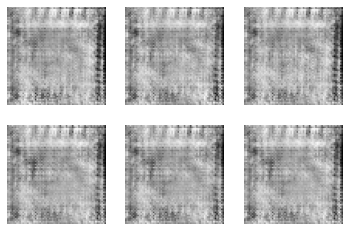

1001 [D loss: 0.596919, acc.: 80.08%] [G loss: 0.861989]
1002 [D loss: 0.598340, acc.: 81.64%] [G loss: 0.869076]
1003 [D loss: 0.588321, acc.: 84.77%] [G loss: 0.871124]
1004 [D loss: 0.581295, acc.: 86.72%] [G loss: 0.874709]
1005 [D loss: 0.577846, acc.: 83.59%] [G loss: 0.876934]
1006 [D loss: 0.579358, acc.: 85.16%] [G loss: 0.875715]
1007 [D loss: 0.598073, acc.: 80.86%] [G loss: 0.876011]
1008 [D loss: 0.579738, acc.: 86.33%] [G loss: 0.883037]
1009 [D loss: 0.586515, acc.: 82.81%] [G loss: 0.870057]
1010 [D loss: 0.588162, acc.: 85.94%] [G loss: 0.869342]
1011 [D loss: 0.577579, acc.: 83.59%] [G loss: 0.858427]
1012 [D loss: 0.584193, acc.: 83.59%] [G loss: 0.854931]
1013 [D loss: 0.599454, acc.: 81.64%] [G loss: 0.836790]
1014 [D loss: 0.606795, acc.: 78.52%] [G loss: 0.816866]
1015 [D loss: 0.651419, acc.: 63.67%] [G loss: 0.771224]
1016 [D loss: 0.646359, acc.: 51.56%] [G loss: 0.738492]
1017 [D loss: 0.714058, acc.: 26.56%] [G loss: 0.691083]
1018 [D loss: 0.718905, acc.: 3

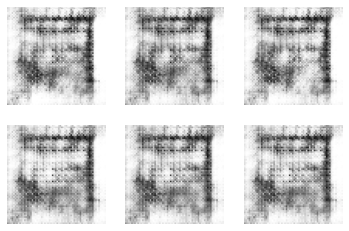

1051 [D loss: 0.815822, acc.: 17.58%] [G loss: 0.629983]
1052 [D loss: 0.751971, acc.: 20.70%] [G loss: 0.737352]
1053 [D loss: 0.698045, acc.: 44.92%] [G loss: 0.862221]
1054 [D loss: 0.628175, acc.: 70.31%] [G loss: 1.006242]
1055 [D loss: 0.588466, acc.: 71.88%] [G loss: 1.152198]
1056 [D loss: 0.557816, acc.: 74.22%] [G loss: 1.231640]
1057 [D loss: 0.538557, acc.: 73.83%] [G loss: 1.277413]
1058 [D loss: 0.545282, acc.: 77.73%] [G loss: 1.204995]
1059 [D loss: 0.583825, acc.: 76.56%] [G loss: 1.089443]
1060 [D loss: 0.597104, acc.: 82.03%] [G loss: 0.953436]
1061 [D loss: 0.649416, acc.: 73.83%] [G loss: 0.836915]
1062 [D loss: 0.659075, acc.: 70.70%] [G loss: 0.786905]
1063 [D loss: 0.674663, acc.: 66.41%] [G loss: 0.753544]
1064 [D loss: 0.665710, acc.: 67.97%] [G loss: 0.743538]
1065 [D loss: 0.687480, acc.: 61.72%] [G loss: 0.732574]
1066 [D loss: 0.683136, acc.: 62.11%] [G loss: 0.733730]
1067 [D loss: 0.673876, acc.: 65.23%] [G loss: 0.738946]
1068 [D loss: 0.678036, acc.: 6

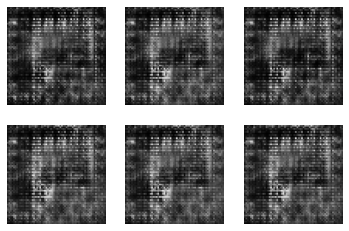

1101 [D loss: 0.721266, acc.: 60.16%] [G loss: 0.818579]
1102 [D loss: 0.715667, acc.: 51.95%] [G loss: 0.787189]
1103 [D loss: 0.727907, acc.: 55.86%] [G loss: 0.772829]
1104 [D loss: 0.723439, acc.: 51.56%] [G loss: 0.755848]
1105 [D loss: 0.741397, acc.: 28.12%] [G loss: 0.737096]
1106 [D loss: 0.731596, acc.: 26.17%] [G loss: 0.719808]
1107 [D loss: 0.756816, acc.: 18.75%] [G loss: 0.699944]
1108 [D loss: 0.773781, acc.: 19.14%] [G loss: 0.676606]
1109 [D loss: 0.777472, acc.: 18.36%] [G loss: 0.651432]
1110 [D loss: 0.792988, acc.: 21.48%] [G loss: 0.626352]
1111 [D loss: 0.802894, acc.: 19.92%] [G loss: 0.604542]
1112 [D loss: 0.819207, acc.: 21.09%] [G loss: 0.578895]
1113 [D loss: 0.842193, acc.: 20.70%] [G loss: 0.559367]
1114 [D loss: 0.852866, acc.: 16.80%] [G loss: 0.554158]
1115 [D loss: 0.859125, acc.: 19.92%] [G loss: 0.555369]
1116 [D loss: 0.832687, acc.: 19.14%] [G loss: 0.588731]
1117 [D loss: 0.822875, acc.: 12.11%] [G loss: 0.647154]
1118 [D loss: 0.749104, acc.: 2

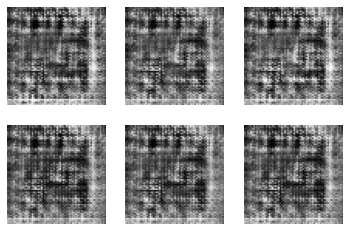

1151 [D loss: 0.661304, acc.: 80.08%] [G loss: 0.770368]
1152 [D loss: 0.670478, acc.: 75.78%] [G loss: 0.755283]
1153 [D loss: 0.677730, acc.: 63.28%] [G loss: 0.741814]
1154 [D loss: 0.678778, acc.: 53.91%] [G loss: 0.729841]
1155 [D loss: 0.682572, acc.: 41.80%] [G loss: 0.717354]
1156 [D loss: 0.683183, acc.: 41.02%] [G loss: 0.714028]
1157 [D loss: 0.697433, acc.: 33.59%] [G loss: 0.707214]
1158 [D loss: 0.701280, acc.: 31.25%] [G loss: 0.697179]
1159 [D loss: 0.697492, acc.: 29.69%] [G loss: 0.691726]
1160 [D loss: 0.700491, acc.: 28.52%] [G loss: 0.686478]
1161 [D loss: 0.708547, acc.: 27.34%] [G loss: 0.679681]
1162 [D loss: 0.700095, acc.: 31.25%] [G loss: 0.678845]
1163 [D loss: 0.714726, acc.: 25.78%] [G loss: 0.673780]
1164 [D loss: 0.715905, acc.: 25.39%] [G loss: 0.673905]
1165 [D loss: 0.716966, acc.: 26.17%] [G loss: 0.673645]
1166 [D loss: 0.713421, acc.: 29.30%] [G loss: 0.680161]
1167 [D loss: 0.710005, acc.: 30.86%] [G loss: 0.679990]
1168 [D loss: 0.723185, acc.: 2

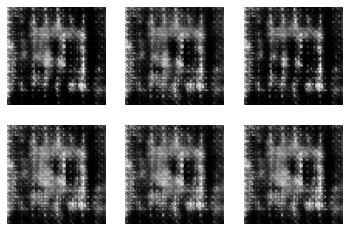

1201 [D loss: 0.628082, acc.: 75.00%] [G loss: 1.033307]
1202 [D loss: 0.630847, acc.: 75.78%] [G loss: 0.946845]
1203 [D loss: 0.675757, acc.: 71.48%] [G loss: 0.878255]
1204 [D loss: 0.640275, acc.: 79.69%] [G loss: 0.854882]
1205 [D loss: 0.687899, acc.: 65.23%] [G loss: 0.814943]
1206 [D loss: 0.683424, acc.: 66.80%] [G loss: 0.801380]
1207 [D loss: 0.690444, acc.: 52.73%] [G loss: 0.759712]
1208 [D loss: 0.694418, acc.: 39.45%] [G loss: 0.721720]
1209 [D loss: 0.720921, acc.: 30.47%] [G loss: 0.692265]
1210 [D loss: 0.726122, acc.: 29.69%] [G loss: 0.664884]
1211 [D loss: 0.752536, acc.: 28.91%] [G loss: 0.642950]
1212 [D loss: 0.761245, acc.: 26.17%] [G loss: 0.632886]
1213 [D loss: 0.735016, acc.: 32.42%] [G loss: 0.616570]
1214 [D loss: 0.757009, acc.: 30.47%] [G loss: 0.618193]
1215 [D loss: 0.737871, acc.: 33.20%] [G loss: 0.621143]
1216 [D loss: 0.752750, acc.: 28.12%] [G loss: 0.628291]
1217 [D loss: 0.741782, acc.: 26.95%] [G loss: 0.632425]
1218 [D loss: 0.746480, acc.: 2

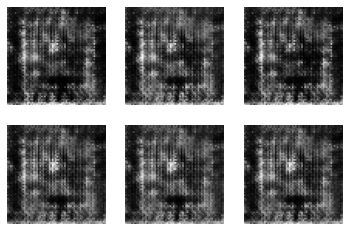

1251 [D loss: 0.793613, acc.: 24.61%] [G loss: 0.582964]
1252 [D loss: 0.804708, acc.: 20.70%] [G loss: 0.588277]
1253 [D loss: 0.796513, acc.: 20.31%] [G loss: 0.595989]
1254 [D loss: 0.797989, acc.: 21.09%] [G loss: 0.622866]
1255 [D loss: 0.758941, acc.: 19.53%] [G loss: 0.689859]
1256 [D loss: 0.721670, acc.: 35.16%] [G loss: 0.765180]
1257 [D loss: 0.687072, acc.: 61.72%] [G loss: 0.842937]
1258 [D loss: 0.644735, acc.: 71.09%] [G loss: 0.937635]
1259 [D loss: 0.615734, acc.: 71.48%] [G loss: 1.003432]
1260 [D loss: 0.596975, acc.: 73.05%] [G loss: 1.063240]
1261 [D loss: 0.587875, acc.: 70.70%] [G loss: 1.070554]
1262 [D loss: 0.585298, acc.: 75.39%] [G loss: 1.058794]
1263 [D loss: 0.626759, acc.: 70.70%] [G loss: 0.966848]
1264 [D loss: 0.622236, acc.: 79.30%] [G loss: 0.896093]
1265 [D loss: 0.647583, acc.: 78.91%] [G loss: 0.832032]
1266 [D loss: 0.663233, acc.: 79.69%] [G loss: 0.792589]
1267 [D loss: 0.688227, acc.: 69.53%] [G loss: 0.753966]
1268 [D loss: 0.692381, acc.: 4

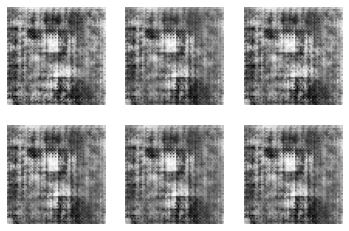

1301 [D loss: 0.664277, acc.: 64.45%] [G loss: 0.753456]
1302 [D loss: 0.674683, acc.: 67.19%] [G loss: 0.751154]
1303 [D loss: 0.664807, acc.: 73.05%] [G loss: 0.754469]
1304 [D loss: 0.658377, acc.: 76.17%] [G loss: 0.761592]
1305 [D loss: 0.665931, acc.: 78.52%] [G loss: 0.763948]
1306 [D loss: 0.654018, acc.: 80.86%] [G loss: 0.766680]
1307 [D loss: 0.658632, acc.: 80.47%] [G loss: 0.771300]
1308 [D loss: 0.654091, acc.: 81.25%] [G loss: 0.771762]
1309 [D loss: 0.661366, acc.: 79.30%] [G loss: 0.772073]
1310 [D loss: 0.668629, acc.: 75.00%] [G loss: 0.765887]
1311 [D loss: 0.671618, acc.: 75.00%] [G loss: 0.757856]
1312 [D loss: 0.670898, acc.: 70.31%] [G loss: 0.745470]
1313 [D loss: 0.668189, acc.: 51.95%] [G loss: 0.730057]
1314 [D loss: 0.690773, acc.: 39.45%] [G loss: 0.718488]
1315 [D loss: 0.684632, acc.: 35.94%] [G loss: 0.713528]
1316 [D loss: 0.693597, acc.: 39.84%] [G loss: 0.716934]
1317 [D loss: 0.676662, acc.: 47.66%] [G loss: 0.724665]
1318 [D loss: 0.680563, acc.: 4

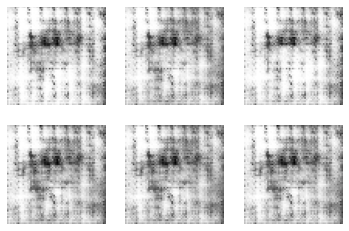

1351 [D loss: 0.664589, acc.: 57.42%] [G loss: 0.784383]
1352 [D loss: 0.657242, acc.: 61.72%] [G loss: 0.839784]
1353 [D loss: 0.643283, acc.: 69.14%] [G loss: 0.921009]
1354 [D loss: 0.590342, acc.: 77.73%] [G loss: 1.073590]
1355 [D loss: 0.538711, acc.: 77.34%] [G loss: 1.170206]
1356 [D loss: 0.532820, acc.: 77.73%] [G loss: 1.244295]
1357 [D loss: 0.548572, acc.: 75.78%] [G loss: 1.205408]
1358 [D loss: 0.546160, acc.: 77.34%] [G loss: 1.167197]
1359 [D loss: 0.561140, acc.: 77.73%] [G loss: 1.112435]
1360 [D loss: 0.562707, acc.: 78.12%] [G loss: 1.051276]
1361 [D loss: 0.567570, acc.: 82.03%] [G loss: 0.959636]
1362 [D loss: 0.611945, acc.: 80.86%] [G loss: 0.868623]
1363 [D loss: 0.628550, acc.: 57.81%] [G loss: 0.777182]
1364 [D loss: 0.713223, acc.: 29.69%] [G loss: 0.668696]
1365 [D loss: 0.776573, acc.: 27.73%] [G loss: 0.589014]
1366 [D loss: 0.809177, acc.: 36.33%] [G loss: 0.521217]
1367 [D loss: 0.880445, acc.: 29.30%] [G loss: 0.491581]
1368 [D loss: 0.886799, acc.: 3

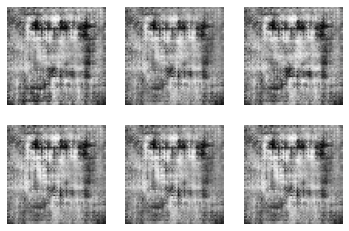

1401 [D loss: 0.700760, acc.: 29.69%] [G loss: 0.679667]
1402 [D loss: 0.690665, acc.: 33.20%] [G loss: 0.685348]
1403 [D loss: 0.664703, acc.: 37.89%] [G loss: 0.692594]
1404 [D loss: 0.684504, acc.: 34.38%] [G loss: 0.692753]
1405 [D loss: 0.685786, acc.: 34.77%] [G loss: 0.699947]
1406 [D loss: 0.690027, acc.: 35.16%] [G loss: 0.699010]
1407 [D loss: 0.672420, acc.: 43.36%] [G loss: 0.703363]
1408 [D loss: 0.683408, acc.: 39.06%] [G loss: 0.705108]
1409 [D loss: 0.687261, acc.: 41.02%] [G loss: 0.704767]
1410 [D loss: 0.681491, acc.: 38.67%] [G loss: 0.705865]
1411 [D loss: 0.676295, acc.: 47.27%] [G loss: 0.713481]
1412 [D loss: 0.678502, acc.: 39.06%] [G loss: 0.711648]
1413 [D loss: 0.672733, acc.: 48.44%] [G loss: 0.715742]
1414 [D loss: 0.675512, acc.: 46.09%] [G loss: 0.716289]
1415 [D loss: 0.670583, acc.: 48.83%] [G loss: 0.722281]
1416 [D loss: 0.680062, acc.: 44.53%] [G loss: 0.720402]
1417 [D loss: 0.676990, acc.: 55.47%] [G loss: 0.728071]
1418 [D loss: 0.661236, acc.: 6

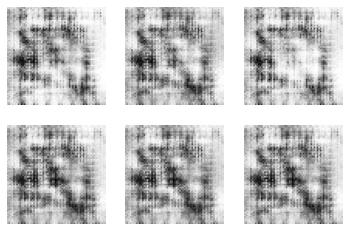

1451 [D loss: 0.643381, acc.: 76.95%] [G loss: 0.803081]
1452 [D loss: 0.649018, acc.: 71.88%] [G loss: 0.798576]
1453 [D loss: 0.673654, acc.: 62.89%] [G loss: 0.782982]
1454 [D loss: 0.668409, acc.: 58.98%] [G loss: 0.791275]
1455 [D loss: 0.663650, acc.: 61.33%] [G loss: 0.799647]
1456 [D loss: 0.641384, acc.: 76.17%] [G loss: 0.854062]
1457 [D loss: 0.647966, acc.: 76.56%] [G loss: 0.905730]
1458 [D loss: 0.619749, acc.: 75.78%] [G loss: 0.956318]
1459 [D loss: 0.610752, acc.: 76.17%] [G loss: 1.024878]
1460 [D loss: 0.610884, acc.: 74.22%] [G loss: 1.027580]
1461 [D loss: 0.603294, acc.: 79.69%] [G loss: 1.009631]
1462 [D loss: 0.591477, acc.: 80.08%] [G loss: 0.982450]
1463 [D loss: 0.622931, acc.: 76.56%] [G loss: 0.929180]
1464 [D loss: 0.613299, acc.: 82.42%] [G loss: 0.879686]
1465 [D loss: 0.624159, acc.: 79.69%] [G loss: 0.835895]
1466 [D loss: 0.661840, acc.: 78.91%] [G loss: 0.792180]
1467 [D loss: 0.682056, acc.: 42.19%] [G loss: 0.739472]
1468 [D loss: 0.699506, acc.: 3

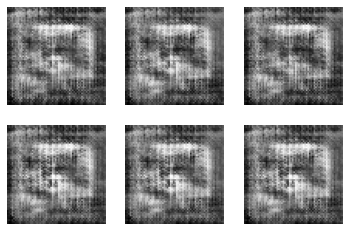

1501 [D loss: 0.673772, acc.: 73.83%] [G loss: 0.768215]
1502 [D loss: 0.665102, acc.: 72.66%] [G loss: 0.760106]
1503 [D loss: 0.665195, acc.: 75.78%] [G loss: 0.769829]
1504 [D loss: 0.669269, acc.: 78.12%] [G loss: 0.765194]
1505 [D loss: 0.660153, acc.: 78.12%] [G loss: 0.764123]
1506 [D loss: 0.660793, acc.: 76.56%] [G loss: 0.759972]
1507 [D loss: 0.662430, acc.: 75.78%] [G loss: 0.754631]
1508 [D loss: 0.653550, acc.: 75.78%] [G loss: 0.742401]
1509 [D loss: 0.660302, acc.: 71.48%] [G loss: 0.742783]
1510 [D loss: 0.660852, acc.: 70.70%] [G loss: 0.743080]
1511 [D loss: 0.663702, acc.: 70.31%] [G loss: 0.743078]
1512 [D loss: 0.670881, acc.: 64.06%] [G loss: 0.736331]
1513 [D loss: 0.665699, acc.: 65.23%] [G loss: 0.740479]
1514 [D loss: 0.670275, acc.: 62.89%] [G loss: 0.736054]
1515 [D loss: 0.670350, acc.: 57.03%] [G loss: 0.740842]
1516 [D loss: 0.661482, acc.: 64.45%] [G loss: 0.742415]
1517 [D loss: 0.663373, acc.: 61.72%] [G loss: 0.742388]
1518 [D loss: 0.671053, acc.: 6

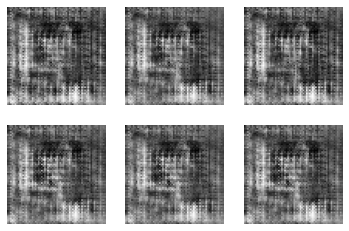

1551 [D loss: 0.714426, acc.: 20.31%] [G loss: 0.690961]
1552 [D loss: 0.702389, acc.: 26.56%] [G loss: 0.669639]
1553 [D loss: 0.710776, acc.: 27.73%] [G loss: 0.644788]
1554 [D loss: 0.752061, acc.: 22.27%] [G loss: 0.614879]
1555 [D loss: 0.786854, acc.: 24.22%] [G loss: 0.571531]
1556 [D loss: 0.828691, acc.: 17.97%] [G loss: 0.546995]
1557 [D loss: 0.844475, acc.: 20.31%] [G loss: 0.523252]
1558 [D loss: 0.879250, acc.: 17.97%] [G loss: 0.507120]
1559 [D loss: 0.901272, acc.: 11.33%] [G loss: 0.520910]
1560 [D loss: 0.899525, acc.: 15.23%] [G loss: 0.534094]
1561 [D loss: 0.890801, acc.: 14.84%] [G loss: 0.559274]
1562 [D loss: 0.873672, acc.: 12.50%] [G loss: 0.583312]
1563 [D loss: 0.879532, acc.: 12.11%] [G loss: 0.595529]
1564 [D loss: 0.832116, acc.: 8.98%] [G loss: 0.670093]
1565 [D loss: 0.779680, acc.: 21.09%] [G loss: 0.753860]
1566 [D loss: 0.720872, acc.: 37.89%] [G loss: 0.850344]
1567 [D loss: 0.660461, acc.: 61.72%] [G loss: 1.008961]
1568 [D loss: 0.595497, acc.: 64

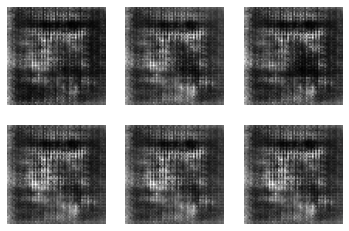

1601 [D loss: 0.722674, acc.: 47.27%] [G loss: 0.734662]
1602 [D loss: 0.749666, acc.: 30.47%] [G loss: 0.704009]
1603 [D loss: 0.745215, acc.: 26.56%] [G loss: 0.675316]
1604 [D loss: 0.748082, acc.: 30.08%] [G loss: 0.654037]
1605 [D loss: 0.745189, acc.: 28.12%] [G loss: 0.644272]
1606 [D loss: 0.755012, acc.: 28.52%] [G loss: 0.644284]
1607 [D loss: 0.756314, acc.: 29.30%] [G loss: 0.647796]
1608 [D loss: 0.747994, acc.: 29.69%] [G loss: 0.648284]
1609 [D loss: 0.735528, acc.: 29.30%] [G loss: 0.651139]
1610 [D loss: 0.744813, acc.: 25.78%] [G loss: 0.657689]
1611 [D loss: 0.750449, acc.: 26.56%] [G loss: 0.660119]
1612 [D loss: 0.743882, acc.: 25.78%] [G loss: 0.664906]
1613 [D loss: 0.732698, acc.: 28.91%] [G loss: 0.672245]
1614 [D loss: 0.740717, acc.: 25.39%] [G loss: 0.674112]
1615 [D loss: 0.720882, acc.: 28.52%] [G loss: 0.679186]
1616 [D loss: 0.730323, acc.: 27.34%] [G loss: 0.684608]
1617 [D loss: 0.716488, acc.: 30.08%] [G loss: 0.688097]
1618 [D loss: 0.722649, acc.: 2

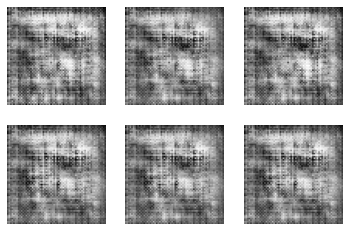

1651 [D loss: 0.650863, acc.: 75.78%] [G loss: 0.782401]
1652 [D loss: 0.646281, acc.: 76.95%] [G loss: 0.778494]
1653 [D loss: 0.640246, acc.: 80.47%] [G loss: 0.780814]
1654 [D loss: 0.637809, acc.: 79.69%] [G loss: 0.782481]
1655 [D loss: 0.641070, acc.: 78.12%] [G loss: 0.782582]
1656 [D loss: 0.631956, acc.: 82.03%] [G loss: 0.780756]
1657 [D loss: 0.630500, acc.: 83.20%] [G loss: 0.781283]
1658 [D loss: 0.640733, acc.: 81.25%] [G loss: 0.781721]
1659 [D loss: 0.628596, acc.: 82.42%] [G loss: 0.779145]
1660 [D loss: 0.608586, acc.: 89.45%] [G loss: 0.777686]
1661 [D loss: 0.619889, acc.: 84.77%] [G loss: 0.776115]
1662 [D loss: 0.622545, acc.: 82.81%] [G loss: 0.777902]
1663 [D loss: 0.625891, acc.: 83.20%] [G loss: 0.780885]
1664 [D loss: 0.620741, acc.: 83.59%] [G loss: 0.780202]
1665 [D loss: 0.621775, acc.: 83.20%] [G loss: 0.779606]
1666 [D loss: 0.620919, acc.: 83.98%] [G loss: 0.778556]
1667 [D loss: 0.636616, acc.: 81.25%] [G loss: 0.772086]
1668 [D loss: 0.624267, acc.: 8

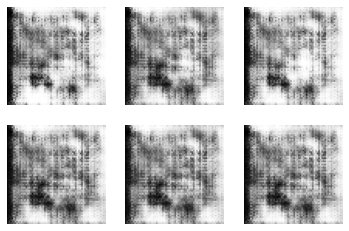

1701 [D loss: 0.604194, acc.: 75.39%] [G loss: 0.955275]
1702 [D loss: 0.583801, acc.: 78.91%] [G loss: 0.996748]
1703 [D loss: 0.570864, acc.: 79.69%] [G loss: 1.029867]
1704 [D loss: 0.547631, acc.: 82.03%] [G loss: 1.072261]
1705 [D loss: 0.536843, acc.: 80.86%] [G loss: 1.093699]
1706 [D loss: 0.528209, acc.: 82.81%] [G loss: 1.105021]
1707 [D loss: 0.532494, acc.: 82.03%] [G loss: 1.109447]
1708 [D loss: 0.533570, acc.: 82.81%] [G loss: 1.095495]
1709 [D loss: 0.522450, acc.: 89.45%] [G loss: 1.078923]
1710 [D loss: 0.544866, acc.: 85.16%] [G loss: 1.022280]
1711 [D loss: 0.536795, acc.: 85.55%] [G loss: 0.969238]
1712 [D loss: 0.573253, acc.: 85.55%] [G loss: 0.911171]
1713 [D loss: 0.577565, acc.: 87.50%] [G loss: 0.858364]
1714 [D loss: 0.609706, acc.: 60.94%] [G loss: 0.803274]
1715 [D loss: 0.643911, acc.: 57.81%] [G loss: 0.751776]
1716 [D loss: 0.691423, acc.: 36.72%] [G loss: 0.702071]
1717 [D loss: 0.704612, acc.: 35.94%] [G loss: 0.660664]
1718 [D loss: 0.715444, acc.: 3

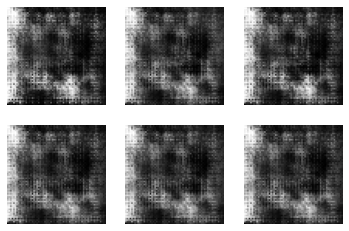

1751 [D loss: 0.679370, acc.: 76.95%] [G loss: 0.814178]
1752 [D loss: 0.698780, acc.: 64.45%] [G loss: 0.785425]
1753 [D loss: 0.702320, acc.: 41.80%] [G loss: 0.749284]
1754 [D loss: 0.712675, acc.: 33.98%] [G loss: 0.724414]
1755 [D loss: 0.707726, acc.: 32.03%] [G loss: 0.710462]
1756 [D loss: 0.708643, acc.: 34.38%] [G loss: 0.709977]
1757 [D loss: 0.710466, acc.: 33.20%] [G loss: 0.703355]
1758 [D loss: 0.709644, acc.: 33.20%] [G loss: 0.697984]
1759 [D loss: 0.704515, acc.: 36.33%] [G loss: 0.697956]
1760 [D loss: 0.721474, acc.: 31.64%] [G loss: 0.693235]
1761 [D loss: 0.713742, acc.: 33.98%] [G loss: 0.692180]
1762 [D loss: 0.714192, acc.: 32.81%] [G loss: 0.682431]
1763 [D loss: 0.707359, acc.: 31.64%] [G loss: 0.684300]
1764 [D loss: 0.718403, acc.: 27.73%] [G loss: 0.676149]
1765 [D loss: 0.705486, acc.: 28.52%] [G loss: 0.676407]
1766 [D loss: 0.723462, acc.: 27.73%] [G loss: 0.670873]
1767 [D loss: 0.719009, acc.: 29.30%] [G loss: 0.665555]
1768 [D loss: 0.730181, acc.: 2

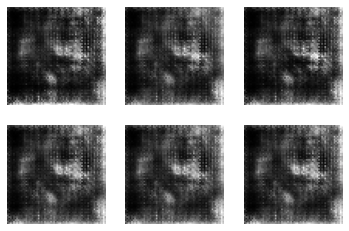

1801 [D loss: 0.669463, acc.: 66.41%] [G loss: 0.876483]
1802 [D loss: 0.664577, acc.: 68.75%] [G loss: 0.883913]
1803 [D loss: 0.653929, acc.: 69.92%] [G loss: 0.886154]
1804 [D loss: 0.661797, acc.: 69.14%] [G loss: 0.867911]
1805 [D loss: 0.684503, acc.: 67.97%] [G loss: 0.847699]
1806 [D loss: 0.667440, acc.: 70.70%] [G loss: 0.831911]
1807 [D loss: 0.679665, acc.: 66.41%] [G loss: 0.822784]
1808 [D loss: 0.687951, acc.: 70.70%] [G loss: 0.807026]
1809 [D loss: 0.686363, acc.: 72.66%] [G loss: 0.793653]
1810 [D loss: 0.690707, acc.: 70.31%] [G loss: 0.775482]
1811 [D loss: 0.692036, acc.: 69.92%] [G loss: 0.756177]
1812 [D loss: 0.690912, acc.: 63.67%] [G loss: 0.746054]
1813 [D loss: 0.691927, acc.: 52.34%] [G loss: 0.734334]
1814 [D loss: 0.697351, acc.: 53.12%] [G loss: 0.729711]
1815 [D loss: 0.694538, acc.: 47.66%] [G loss: 0.726325]
1816 [D loss: 0.686655, acc.: 58.20%] [G loss: 0.733918]
1817 [D loss: 0.693724, acc.: 49.22%] [G loss: 0.728293]
1818 [D loss: 0.683669, acc.: 5

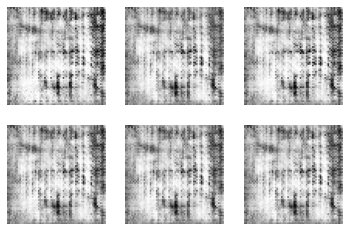

1851 [D loss: 0.623996, acc.: 80.47%] [G loss: 0.817374]
1852 [D loss: 0.612573, acc.: 85.94%] [G loss: 0.833473]
1853 [D loss: 0.577903, acc.: 86.72%] [G loss: 0.867657]
1854 [D loss: 0.588620, acc.: 84.77%] [G loss: 0.885058]
1855 [D loss: 0.576783, acc.: 87.50%] [G loss: 0.909273]
1856 [D loss: 0.570043, acc.: 83.98%] [G loss: 0.908412]
1857 [D loss: 0.569998, acc.: 85.94%] [G loss: 0.899180]
1858 [D loss: 0.563314, acc.: 84.77%] [G loss: 0.879758]
1859 [D loss: 0.583452, acc.: 84.38%] [G loss: 0.837824]
1860 [D loss: 0.594949, acc.: 77.34%] [G loss: 0.789034]
1861 [D loss: 0.661919, acc.: 37.50%] [G loss: 0.716346]
1862 [D loss: 0.696504, acc.: 34.38%] [G loss: 0.637526]
1863 [D loss: 0.780337, acc.: 35.55%] [G loss: 0.557672]
1864 [D loss: 0.841771, acc.: 34.38%] [G loss: 0.514066]
1865 [D loss: 0.908287, acc.: 30.47%] [G loss: 0.514618]
1866 [D loss: 0.887224, acc.: 25.39%] [G loss: 0.599697]
1867 [D loss: 0.789682, acc.: 36.33%] [G loss: 0.811793]
1868 [D loss: 0.725304, acc.: 4

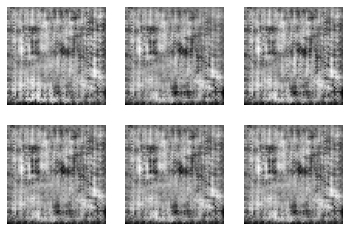

1901 [D loss: 0.646272, acc.: 44.53%] [G loss: 0.699540]
1902 [D loss: 0.640338, acc.: 52.34%] [G loss: 0.714603]
1903 [D loss: 0.632792, acc.: 64.84%] [G loss: 0.726192]
1904 [D loss: 0.615448, acc.: 85.94%] [G loss: 0.742306]
1905 [D loss: 0.615981, acc.: 92.19%] [G loss: 0.751370]
1906 [D loss: 0.613098, acc.: 92.58%] [G loss: 0.762690]
1907 [D loss: 0.607430, acc.: 92.97%] [G loss: 0.768171]
1908 [D loss: 0.608030, acc.: 93.36%] [G loss: 0.782495]
1909 [D loss: 0.593581, acc.: 96.09%] [G loss: 0.788552]
1910 [D loss: 0.596953, acc.: 91.02%] [G loss: 0.792720]
1911 [D loss: 0.598451, acc.: 91.41%] [G loss: 0.798382]
1912 [D loss: 0.600288, acc.: 92.58%] [G loss: 0.799743]
1913 [D loss: 0.609621, acc.: 86.33%] [G loss: 0.806490]
1914 [D loss: 0.592560, acc.: 89.45%] [G loss: 0.814010]
1915 [D loss: 0.602003, acc.: 86.72%] [G loss: 0.813547]
1916 [D loss: 0.604023, acc.: 89.06%] [G loss: 0.814513]
1917 [D loss: 0.603787, acc.: 88.28%] [G loss: 0.811211]
1918 [D loss: 0.611642, acc.: 8

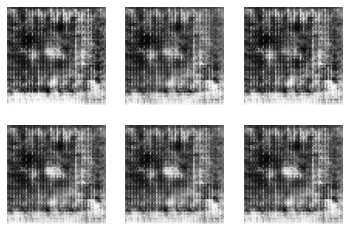

1951 [D loss: 0.650979, acc.: 63.28%] [G loss: 0.831561]
1952 [D loss: 0.658978, acc.: 62.11%] [G loss: 0.813103]
1953 [D loss: 0.658427, acc.: 62.50%] [G loss: 0.832663]
1954 [D loss: 0.651524, acc.: 62.11%] [G loss: 0.835245]
1955 [D loss: 0.634117, acc.: 64.06%] [G loss: 0.845239]
1956 [D loss: 0.635610, acc.: 67.19%] [G loss: 0.863420]
1957 [D loss: 0.631332, acc.: 67.97%] [G loss: 0.893207]
1958 [D loss: 0.636466, acc.: 69.14%] [G loss: 0.895606]
1959 [D loss: 0.651630, acc.: 69.14%] [G loss: 0.909670]
1960 [D loss: 0.631248, acc.: 70.31%] [G loss: 0.907065]
1961 [D loss: 0.640714, acc.: 71.09%] [G loss: 0.913509]
1962 [D loss: 0.639342, acc.: 72.27%] [G loss: 0.919125]
1963 [D loss: 0.640990, acc.: 73.83%] [G loss: 0.918856]
1964 [D loss: 0.633895, acc.: 79.69%] [G loss: 0.950485]
1965 [D loss: 0.611655, acc.: 81.64%] [G loss: 0.962629]
1966 [D loss: 0.617580, acc.: 80.86%] [G loss: 0.972935]
1967 [D loss: 0.627084, acc.: 80.08%] [G loss: 0.960133]
1968 [D loss: 0.629584, acc.: 8

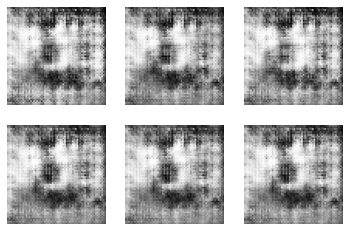

2001 [D loss: 0.725913, acc.: 50.00%] [G loss: 0.690634]
2002 [D loss: 0.746426, acc.: 52.73%] [G loss: 0.690885]
2003 [D loss: 0.731705, acc.: 49.22%] [G loss: 0.727508]
2004 [D loss: 0.702391, acc.: 56.25%] [G loss: 0.781482]
2005 [D loss: 0.705800, acc.: 48.83%] [G loss: 0.776301]
2006 [D loss: 0.691044, acc.: 53.52%] [G loss: 0.774706]
2007 [D loss: 0.696886, acc.: 52.73%] [G loss: 0.791118]
2008 [D loss: 0.686837, acc.: 51.56%] [G loss: 0.771650]
2009 [D loss: 0.694508, acc.: 51.17%] [G loss: 0.746982]
2010 [D loss: 0.704071, acc.: 51.17%] [G loss: 0.746248]
2011 [D loss: 0.710395, acc.: 41.02%] [G loss: 0.730615]
2012 [D loss: 0.723219, acc.: 30.86%] [G loss: 0.697262]
2013 [D loss: 0.733664, acc.: 30.08%] [G loss: 0.688191]
2014 [D loss: 0.746740, acc.: 26.56%] [G loss: 0.687570]
2015 [D loss: 0.711845, acc.: 31.25%] [G loss: 0.725953]
2016 [D loss: 0.709224, acc.: 50.39%] [G loss: 0.771414]
2017 [D loss: 0.701771, acc.: 48.83%] [G loss: 0.784337]
2018 [D loss: 0.687872, acc.: 5

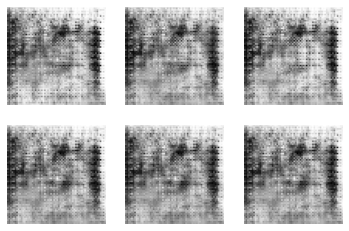

2051 [D loss: 0.650108, acc.: 75.39%] [G loss: 0.808881]
2052 [D loss: 0.654464, acc.: 74.22%] [G loss: 0.802942]
2053 [D loss: 0.650669, acc.: 74.22%] [G loss: 0.801910]
2054 [D loss: 0.650579, acc.: 76.17%] [G loss: 0.790702]
2055 [D loss: 0.665134, acc.: 72.66%] [G loss: 0.788784]
2056 [D loss: 0.650594, acc.: 77.34%] [G loss: 0.787023]
2057 [D loss: 0.669898, acc.: 72.27%] [G loss: 0.776572]
2058 [D loss: 0.668973, acc.: 71.88%] [G loss: 0.766291]
2059 [D loss: 0.664945, acc.: 67.19%] [G loss: 0.763097]
2060 [D loss: 0.672083, acc.: 57.42%] [G loss: 0.759677]
2061 [D loss: 0.683285, acc.: 48.83%] [G loss: 0.748127]
2062 [D loss: 0.697612, acc.: 39.06%] [G loss: 0.739550]
2063 [D loss: 0.682298, acc.: 39.06%] [G loss: 0.732798]
2064 [D loss: 0.696687, acc.: 28.12%] [G loss: 0.720764]
2065 [D loss: 0.707736, acc.: 25.00%] [G loss: 0.714019]
2066 [D loss: 0.709896, acc.: 25.78%] [G loss: 0.694503]
2067 [D loss: 0.726467, acc.: 25.78%] [G loss: 0.679566]
2068 [D loss: 0.744762, acc.: 2

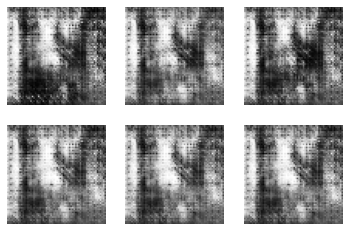

2101 [D loss: 0.588952, acc.: 88.28%] [G loss: 0.886230]
2102 [D loss: 0.635906, acc.: 82.81%] [G loss: 0.815687]
2103 [D loss: 0.638729, acc.: 79.30%] [G loss: 0.756053]
2104 [D loss: 0.661649, acc.: 42.97%] [G loss: 0.720431]
2105 [D loss: 0.678888, acc.: 35.16%] [G loss: 0.696845]
2106 [D loss: 0.684870, acc.: 35.55%] [G loss: 0.681816]
2107 [D loss: 0.695608, acc.: 35.55%] [G loss: 0.681942]
2108 [D loss: 0.705245, acc.: 32.42%] [G loss: 0.682698]
2109 [D loss: 0.706723, acc.: 32.81%] [G loss: 0.686824]
2110 [D loss: 0.701646, acc.: 31.25%] [G loss: 0.692296]
2111 [D loss: 0.694391, acc.: 32.42%] [G loss: 0.695302]
2112 [D loss: 0.704117, acc.: 28.52%] [G loss: 0.699980]
2113 [D loss: 0.719198, acc.: 27.34%] [G loss: 0.701398]
2114 [D loss: 0.705352, acc.: 28.12%] [G loss: 0.707659]
2115 [D loss: 0.714526, acc.: 27.34%] [G loss: 0.713031]
2116 [D loss: 0.707571, acc.: 26.95%] [G loss: 0.719269]
2117 [D loss: 0.708862, acc.: 25.39%] [G loss: 0.720788]
2118 [D loss: 0.705570, acc.: 2

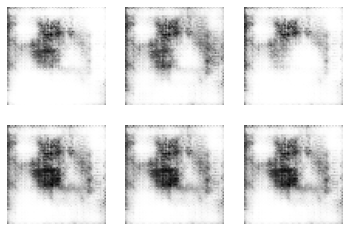

2151 [D loss: 0.684332, acc.: 64.84%] [G loss: 0.866821]
2152 [D loss: 0.658916, acc.: 68.36%] [G loss: 0.941453]
2153 [D loss: 0.631616, acc.: 70.31%] [G loss: 1.002900]
2154 [D loss: 0.604401, acc.: 71.48%] [G loss: 1.082971]
2155 [D loss: 0.558616, acc.: 78.52%] [G loss: 1.176298]
2156 [D loss: 0.544630, acc.: 76.17%] [G loss: 1.251969]
2157 [D loss: 0.506639, acc.: 81.25%] [G loss: 1.358008]
2158 [D loss: 0.480629, acc.: 83.59%] [G loss: 1.384861]
2159 [D loss: 0.473829, acc.: 87.89%] [G loss: 1.411646]
2160 [D loss: 0.437061, acc.: 91.41%] [G loss: 1.469135]
2161 [D loss: 0.436282, acc.: 90.62%] [G loss: 1.464182]
2162 [D loss: 0.433257, acc.: 89.84%] [G loss: 1.490279]
2163 [D loss: 0.432476, acc.: 91.02%] [G loss: 1.420671]
2164 [D loss: 0.433625, acc.: 94.53%] [G loss: 1.318115]
2165 [D loss: 0.471588, acc.: 90.62%] [G loss: 1.147377]
2166 [D loss: 0.564836, acc.: 78.91%] [G loss: 0.891372]
2167 [D loss: 0.674843, acc.: 47.27%] [G loss: 0.698727]
2168 [D loss: 0.757266, acc.: 4

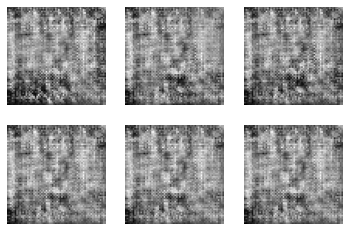

2201 [D loss: 0.697235, acc.: 41.02%] [G loss: 0.710510]
2202 [D loss: 0.689898, acc.: 46.48%] [G loss: 0.720572]
2203 [D loss: 0.688612, acc.: 44.92%] [G loss: 0.723829]
2204 [D loss: 0.683978, acc.: 55.86%] [G loss: 0.732050]
2205 [D loss: 0.678821, acc.: 58.59%] [G loss: 0.734086]
2206 [D loss: 0.671979, acc.: 68.36%] [G loss: 0.746139]
2207 [D loss: 0.668400, acc.: 72.66%] [G loss: 0.751645]
2208 [D loss: 0.673084, acc.: 70.31%] [G loss: 0.747495]
2209 [D loss: 0.667115, acc.: 74.22%] [G loss: 0.749520]
2210 [D loss: 0.664637, acc.: 72.27%] [G loss: 0.752306]
2211 [D loss: 0.671848, acc.: 68.36%] [G loss: 0.748085]
2212 [D loss: 0.668914, acc.: 67.58%] [G loss: 0.744418]
2213 [D loss: 0.684910, acc.: 56.25%] [G loss: 0.735579]
2214 [D loss: 0.686456, acc.: 44.92%] [G loss: 0.734195]
2215 [D loss: 0.682185, acc.: 46.88%] [G loss: 0.729531]
2216 [D loss: 0.690614, acc.: 39.45%] [G loss: 0.729145]
2217 [D loss: 0.707248, acc.: 34.77%] [G loss: 0.722643]
2218 [D loss: 0.708008, acc.: 3

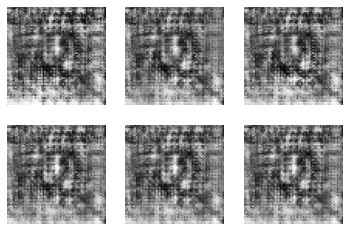

2251 [D loss: 0.683887, acc.: 47.66%] [G loss: 0.729993]
2252 [D loss: 0.671758, acc.: 58.98%] [G loss: 0.739695]
2253 [D loss: 0.673175, acc.: 53.52%] [G loss: 0.731595]
2254 [D loss: 0.688666, acc.: 52.73%] [G loss: 0.733732]
2255 [D loss: 0.699142, acc.: 45.70%] [G loss: 0.725501]
2256 [D loss: 0.698983, acc.: 49.22%] [G loss: 0.724506]
2257 [D loss: 0.732078, acc.: 43.36%] [G loss: 0.690772]
2258 [D loss: 0.729217, acc.: 44.14%] [G loss: 0.676507]
2259 [D loss: 0.749079, acc.: 27.34%] [G loss: 0.649082]
2260 [D loss: 0.775848, acc.: 19.92%] [G loss: 0.628488]
2261 [D loss: 0.783197, acc.: 23.44%] [G loss: 0.618169]
2262 [D loss: 0.792347, acc.: 18.75%] [G loss: 0.636508]
2263 [D loss: 0.786506, acc.: 18.75%] [G loss: 0.640440]
2264 [D loss: 0.775121, acc.: 18.36%] [G loss: 0.681925]
2265 [D loss: 0.769250, acc.: 16.80%] [G loss: 0.710347]
2266 [D loss: 0.743343, acc.: 17.97%] [G loss: 0.758011]
2267 [D loss: 0.708561, acc.: 42.58%] [G loss: 0.822637]
2268 [D loss: 0.676099, acc.: 6

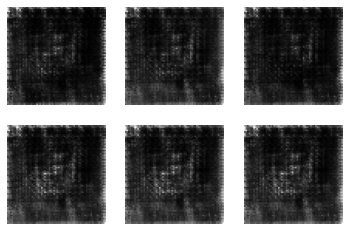

2301 [D loss: 0.628812, acc.: 66.41%] [G loss: 1.015178]
2302 [D loss: 0.620480, acc.: 68.36%] [G loss: 1.063309]
2303 [D loss: 0.612378, acc.: 71.09%] [G loss: 1.054207]
2304 [D loss: 0.638667, acc.: 72.27%] [G loss: 0.965647]
2305 [D loss: 0.643478, acc.: 80.47%] [G loss: 0.894967]
2306 [D loss: 0.685283, acc.: 75.39%] [G loss: 0.810048]
2307 [D loss: 0.689366, acc.: 63.67%] [G loss: 0.759351]
2308 [D loss: 0.723500, acc.: 39.45%] [G loss: 0.718869]
2309 [D loss: 0.727467, acc.: 27.73%] [G loss: 0.692568]
2310 [D loss: 0.722519, acc.: 30.86%] [G loss: 0.684137]
2311 [D loss: 0.732891, acc.: 30.08%] [G loss: 0.672421]
2312 [D loss: 0.758900, acc.: 21.88%] [G loss: 0.665363]
2313 [D loss: 0.740531, acc.: 30.08%] [G loss: 0.666139]
2314 [D loss: 0.743475, acc.: 21.88%] [G loss: 0.668228]
2315 [D loss: 0.724020, acc.: 26.56%] [G loss: 0.671253]
2316 [D loss: 0.735652, acc.: 25.00%] [G loss: 0.673157]
2317 [D loss: 0.755616, acc.: 19.14%] [G loss: 0.672151]
2318 [D loss: 0.746243, acc.: 1

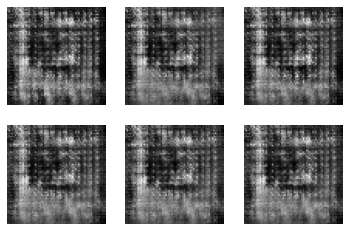

2351 [D loss: 0.661783, acc.: 63.28%] [G loss: 0.801178]
2352 [D loss: 0.668648, acc.: 59.77%] [G loss: 0.802176]
2353 [D loss: 0.658631, acc.: 63.67%] [G loss: 0.808977]
2354 [D loss: 0.650218, acc.: 67.19%] [G loss: 0.819907]
2355 [D loss: 0.652280, acc.: 64.06%] [G loss: 0.839658]
2356 [D loss: 0.629317, acc.: 71.09%] [G loss: 0.851863]
2357 [D loss: 0.612752, acc.: 75.78%] [G loss: 0.878911]
2358 [D loss: 0.636483, acc.: 71.88%] [G loss: 0.881279]
2359 [D loss: 0.635255, acc.: 69.92%] [G loss: 0.897323]
2360 [D loss: 0.619795, acc.: 72.66%] [G loss: 0.912732]
2361 [D loss: 0.599550, acc.: 76.56%] [G loss: 0.916650]
2362 [D loss: 0.604065, acc.: 77.73%] [G loss: 0.924384]
2363 [D loss: 0.604571, acc.: 78.12%] [G loss: 0.933009]
2364 [D loss: 0.620550, acc.: 73.83%] [G loss: 0.905221]
2365 [D loss: 0.626276, acc.: 73.83%] [G loss: 0.877795]
2366 [D loss: 0.617255, acc.: 78.52%] [G loss: 0.872964]
2367 [D loss: 0.605663, acc.: 81.25%] [G loss: 0.866150]
2368 [D loss: 0.610427, acc.: 8

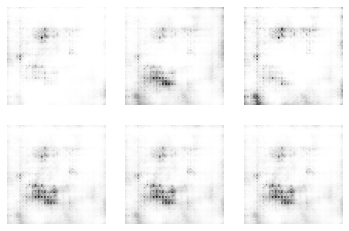

2401 [D loss: 0.304429, acc.: 96.09%] [G loss: 2.293503]
2402 [D loss: 0.313528, acc.: 94.92%] [G loss: 2.219199]
2403 [D loss: 0.335506, acc.: 92.97%] [G loss: 1.985554]
2404 [D loss: 0.370565, acc.: 94.92%] [G loss: 1.577703]
2405 [D loss: 0.473557, acc.: 92.58%] [G loss: 1.100484]
2406 [D loss: 0.556334, acc.: 67.97%] [G loss: 0.813934]
2407 [D loss: 0.642597, acc.: 51.95%] [G loss: 0.674431]
2408 [D loss: 0.686911, acc.: 44.14%] [G loss: 0.609890]
2409 [D loss: 0.709124, acc.: 43.75%] [G loss: 0.570827]
2410 [D loss: 0.742808, acc.: 39.84%] [G loss: 0.527684]
2411 [D loss: 0.763095, acc.: 39.45%] [G loss: 0.508979]
2412 [D loss: 0.812662, acc.: 35.94%] [G loss: 0.486226]
2413 [D loss: 0.832781, acc.: 33.59%] [G loss: 0.469313]
2414 [D loss: 0.825463, acc.: 37.50%] [G loss: 0.469138]
2415 [D loss: 0.833839, acc.: 34.38%] [G loss: 0.467453]
2416 [D loss: 0.863602, acc.: 30.86%] [G loss: 0.468686]
2417 [D loss: 0.840969, acc.: 30.86%] [G loss: 0.480955]
2418 [D loss: 0.852825, acc.: 2

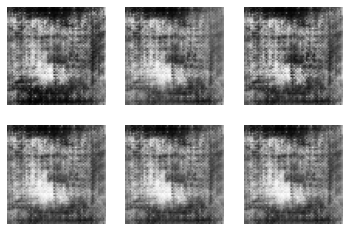

2451 [D loss: 0.700165, acc.: 39.84%] [G loss: 0.707111]
2452 [D loss: 0.688173, acc.: 48.83%] [G loss: 0.715829]
2453 [D loss: 0.689014, acc.: 58.98%] [G loss: 0.729088]
2454 [D loss: 0.674346, acc.: 71.09%] [G loss: 0.740345]
2455 [D loss: 0.678483, acc.: 67.19%] [G loss: 0.743624]
2456 [D loss: 0.671452, acc.: 69.53%] [G loss: 0.752199]
2457 [D loss: 0.671713, acc.: 67.19%] [G loss: 0.755006]
2458 [D loss: 0.672836, acc.: 69.92%] [G loss: 0.759438]
2459 [D loss: 0.660816, acc.: 76.17%] [G loss: 0.767655]
2460 [D loss: 0.660346, acc.: 74.22%] [G loss: 0.776263]
2461 [D loss: 0.661162, acc.: 76.56%] [G loss: 0.778901]
2462 [D loss: 0.659736, acc.: 75.39%] [G loss: 0.776803]
2463 [D loss: 0.652495, acc.: 75.00%] [G loss: 0.780840]
2464 [D loss: 0.653453, acc.: 78.91%] [G loss: 0.781605]
2465 [D loss: 0.652532, acc.: 77.34%] [G loss: 0.778706]
2466 [D loss: 0.654446, acc.: 82.03%] [G loss: 0.777495]
2467 [D loss: 0.659636, acc.: 76.17%] [G loss: 0.777168]
2468 [D loss: 0.661895, acc.: 7

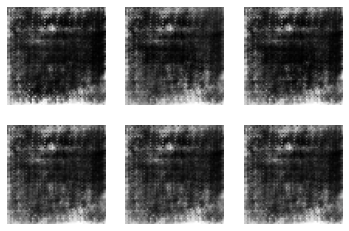

2501 [D loss: 0.748939, acc.: 23.05%] [G loss: 0.645426]
2502 [D loss: 0.733309, acc.: 25.78%] [G loss: 0.675262]
2503 [D loss: 0.710308, acc.: 42.19%] [G loss: 0.733206]
2504 [D loss: 0.701684, acc.: 45.70%] [G loss: 0.785617]
2505 [D loss: 0.673718, acc.: 62.11%] [G loss: 0.841582]
2506 [D loss: 0.652745, acc.: 67.58%] [G loss: 0.893488]
2507 [D loss: 0.634092, acc.: 72.66%] [G loss: 0.915044]
2508 [D loss: 0.647616, acc.: 67.58%] [G loss: 0.903687]
2509 [D loss: 0.643467, acc.: 73.83%] [G loss: 0.893615]
2510 [D loss: 0.660143, acc.: 62.11%] [G loss: 0.849110]
2511 [D loss: 0.676272, acc.: 55.08%] [G loss: 0.827959]
2512 [D loss: 0.682884, acc.: 61.33%] [G loss: 0.818189]
2513 [D loss: 0.688618, acc.: 53.91%] [G loss: 0.785396]
2514 [D loss: 0.713372, acc.: 48.44%] [G loss: 0.770567]
2515 [D loss: 0.687480, acc.: 58.98%] [G loss: 0.767333]
2516 [D loss: 0.697118, acc.: 51.95%] [G loss: 0.741617]
2517 [D loss: 0.719878, acc.: 44.14%] [G loss: 0.730052]
2518 [D loss: 0.708214, acc.: 4

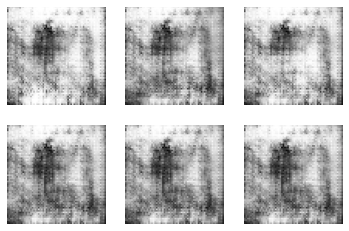

2551 [D loss: 0.781574, acc.: 21.09%] [G loss: 0.626387]
2552 [D loss: 0.772317, acc.: 22.66%] [G loss: 0.632686]
2553 [D loss: 0.790825, acc.: 22.27%] [G loss: 0.652877]
2554 [D loss: 0.761871, acc.: 23.83%] [G loss: 0.691608]
2555 [D loss: 0.733143, acc.: 33.59%] [G loss: 0.747338]
2556 [D loss: 0.700416, acc.: 41.41%] [G loss: 0.805825]
2557 [D loss: 0.676032, acc.: 48.05%] [G loss: 0.883257]
2558 [D loss: 0.639501, acc.: 69.53%] [G loss: 0.956605]
2559 [D loss: 0.594803, acc.: 77.73%] [G loss: 1.037191]
2560 [D loss: 0.593407, acc.: 70.70%] [G loss: 1.089180]
2561 [D loss: 0.560922, acc.: 75.78%] [G loss: 1.099368]
2562 [D loss: 0.557148, acc.: 81.64%] [G loss: 1.083612]
2563 [D loss: 0.570555, acc.: 81.25%] [G loss: 1.029280]
2564 [D loss: 0.572515, acc.: 86.72%] [G loss: 0.940859]
2565 [D loss: 0.605619, acc.: 78.12%] [G loss: 0.873139]
2566 [D loss: 0.670335, acc.: 43.36%] [G loss: 0.741392]
2567 [D loss: 0.697686, acc.: 37.89%] [G loss: 0.673239]
2568 [D loss: 0.755451, acc.: 3

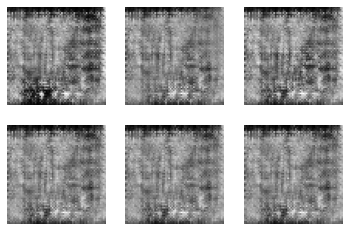

2601 [D loss: 0.663847, acc.: 80.08%] [G loss: 0.763436]
2602 [D loss: 0.657433, acc.: 79.30%] [G loss: 0.770588]
2603 [D loss: 0.650009, acc.: 79.30%] [G loss: 0.776405]
2604 [D loss: 0.633018, acc.: 82.81%] [G loss: 0.782870]
2605 [D loss: 0.639054, acc.: 82.81%] [G loss: 0.785238]
2606 [D loss: 0.651545, acc.: 77.34%] [G loss: 0.788571]
2607 [D loss: 0.644062, acc.: 80.47%] [G loss: 0.786315]
2608 [D loss: 0.626210, acc.: 85.55%] [G loss: 0.791130]
2609 [D loss: 0.648165, acc.: 80.47%] [G loss: 0.785295]
2610 [D loss: 0.656687, acc.: 75.00%] [G loss: 0.790333]
2611 [D loss: 0.648363, acc.: 79.30%] [G loss: 0.792299]
2612 [D loss: 0.663958, acc.: 70.70%] [G loss: 0.789503]
2613 [D loss: 0.651029, acc.: 79.69%] [G loss: 0.790407]
2614 [D loss: 0.642221, acc.: 78.12%] [G loss: 0.788441]
2615 [D loss: 0.653683, acc.: 76.56%] [G loss: 0.780420]
2616 [D loss: 0.664901, acc.: 71.48%] [G loss: 0.762913]
2617 [D loss: 0.654112, acc.: 74.61%] [G loss: 0.768333]
2618 [D loss: 0.687528, acc.: 5

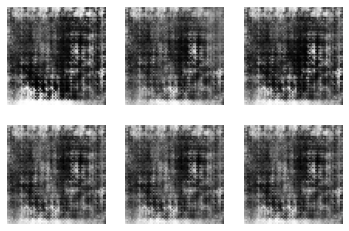

2651 [D loss: 0.746804, acc.: 24.61%] [G loss: 0.684313]
2652 [D loss: 0.749510, acc.: 20.31%] [G loss: 0.684677]
2653 [D loss: 0.745886, acc.: 23.05%] [G loss: 0.680172]
2654 [D loss: 0.745607, acc.: 21.88%] [G loss: 0.681205]
2655 [D loss: 0.737977, acc.: 21.88%] [G loss: 0.680476]
2656 [D loss: 0.753044, acc.: 16.02%] [G loss: 0.674723]
2657 [D loss: 0.744181, acc.: 23.44%] [G loss: 0.666430]
2658 [D loss: 0.743433, acc.: 22.66%] [G loss: 0.670650]
2659 [D loss: 0.732621, acc.: 26.17%] [G loss: 0.672268]
2660 [D loss: 0.730538, acc.: 25.78%] [G loss: 0.676484]
2661 [D loss: 0.745788, acc.: 19.92%] [G loss: 0.679720]
2662 [D loss: 0.731231, acc.: 30.47%] [G loss: 0.690956]
2663 [D loss: 0.744158, acc.: 25.39%] [G loss: 0.688042]
2664 [D loss: 0.737443, acc.: 26.56%] [G loss: 0.681973]
2665 [D loss: 0.714525, acc.: 33.98%] [G loss: 0.699763]
2666 [D loss: 0.722630, acc.: 30.86%] [G loss: 0.699355]
2667 [D loss: 0.720193, acc.: 33.20%] [G loss: 0.707260]
2668 [D loss: 0.716112, acc.: 3

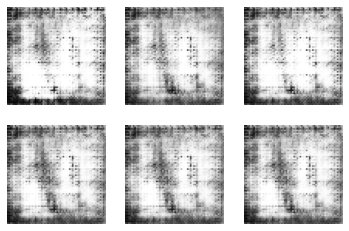

2701 [D loss: 0.623942, acc.: 82.03%] [G loss: 0.906443]
2702 [D loss: 0.606265, acc.: 80.86%] [G loss: 0.940041]
2703 [D loss: 0.602641, acc.: 81.64%] [G loss: 0.921087]
2704 [D loss: 0.618444, acc.: 85.16%] [G loss: 0.862999]
2705 [D loss: 0.636700, acc.: 79.30%] [G loss: 0.809084]
2706 [D loss: 0.650724, acc.: 70.31%] [G loss: 0.756430]
2707 [D loss: 0.686697, acc.: 39.45%] [G loss: 0.701093]
2708 [D loss: 0.703290, acc.: 33.98%] [G loss: 0.661445]
2709 [D loss: 0.717383, acc.: 34.38%] [G loss: 0.642882]
2710 [D loss: 0.728878, acc.: 34.38%] [G loss: 0.639471]
2711 [D loss: 0.737251, acc.: 31.25%] [G loss: 0.632737]
2712 [D loss: 0.730608, acc.: 32.03%] [G loss: 0.636319]
2713 [D loss: 0.738950, acc.: 28.91%] [G loss: 0.650432]
2714 [D loss: 0.722806, acc.: 29.69%] [G loss: 0.672312]
2715 [D loss: 0.712754, acc.: 28.91%] [G loss: 0.705739]
2716 [D loss: 0.698556, acc.: 40.23%] [G loss: 0.750480]
2717 [D loss: 0.663964, acc.: 67.97%] [G loss: 0.792706]
2718 [D loss: 0.649715, acc.: 7

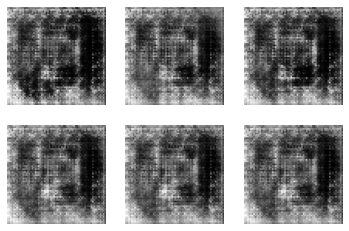

2751 [D loss: 0.699853, acc.: 54.69%] [G loss: 0.792886]
2752 [D loss: 0.681854, acc.: 60.94%] [G loss: 0.797525]
2753 [D loss: 0.698966, acc.: 60.94%] [G loss: 0.782279]
2754 [D loss: 0.714229, acc.: 55.86%] [G loss: 0.754154]
2755 [D loss: 0.702206, acc.: 55.47%] [G loss: 0.742286]
2756 [D loss: 0.706787, acc.: 45.70%] [G loss: 0.722224]
2757 [D loss: 0.733806, acc.: 22.27%] [G loss: 0.702711]
2758 [D loss: 0.737483, acc.: 21.88%] [G loss: 0.681521]
2759 [D loss: 0.733800, acc.: 25.39%] [G loss: 0.667544]
2760 [D loss: 0.762084, acc.: 18.36%] [G loss: 0.652655]
2761 [D loss: 0.763505, acc.: 19.14%] [G loss: 0.646685]
2762 [D loss: 0.764214, acc.: 18.75%] [G loss: 0.642551]
2763 [D loss: 0.744384, acc.: 23.44%] [G loss: 0.644683]
2764 [D loss: 0.753467, acc.: 17.97%] [G loss: 0.658309]
2765 [D loss: 0.742479, acc.: 16.80%] [G loss: 0.672262]
2766 [D loss: 0.735141, acc.: 21.09%] [G loss: 0.681873]
2767 [D loss: 0.726689, acc.: 18.75%] [G loss: 0.698833]
2768 [D loss: 0.716826, acc.: 3

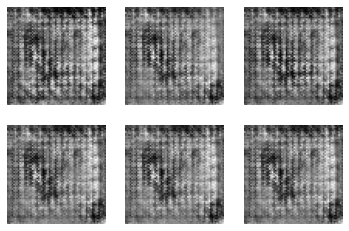

2801 [D loss: 0.731483, acc.: 28.52%] [G loss: 0.651721]
2802 [D loss: 0.704831, acc.: 33.98%] [G loss: 0.656873]
2803 [D loss: 0.722159, acc.: 30.08%] [G loss: 0.657877]
2804 [D loss: 0.720711, acc.: 30.86%] [G loss: 0.668005]
2805 [D loss: 0.723411, acc.: 30.08%] [G loss: 0.674762]
2806 [D loss: 0.698618, acc.: 38.67%] [G loss: 0.685199]
2807 [D loss: 0.697664, acc.: 38.67%] [G loss: 0.686987]
2808 [D loss: 0.705683, acc.: 35.16%] [G loss: 0.697901]
2809 [D loss: 0.693524, acc.: 42.58%] [G loss: 0.708933]
2810 [D loss: 0.698998, acc.: 44.92%] [G loss: 0.713109]
2811 [D loss: 0.681047, acc.: 48.44%] [G loss: 0.720017]
2812 [D loss: 0.692592, acc.: 46.48%] [G loss: 0.723658]
2813 [D loss: 0.689617, acc.: 46.09%] [G loss: 0.731740]
2814 [D loss: 0.691990, acc.: 43.75%] [G loss: 0.739203]
2815 [D loss: 0.673782, acc.: 54.69%] [G loss: 0.746953]
2816 [D loss: 0.667673, acc.: 64.06%] [G loss: 0.759721]
2817 [D loss: 0.663243, acc.: 72.66%] [G loss: 0.765266]
2818 [D loss: 0.663609, acc.: 7

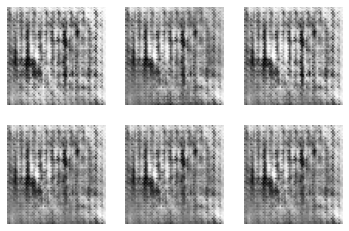

2851 [D loss: 0.678776, acc.: 40.62%] [G loss: 0.639826]
2852 [D loss: 0.741732, acc.: 36.72%] [G loss: 0.581338]
2853 [D loss: 0.789341, acc.: 34.38%] [G loss: 0.539973]
2854 [D loss: 0.832245, acc.: 31.64%] [G loss: 0.500633]
2855 [D loss: 0.854027, acc.: 32.03%] [G loss: 0.476439]
2856 [D loss: 0.911496, acc.: 27.73%] [G loss: 0.476506]
2857 [D loss: 0.890527, acc.: 28.52%] [G loss: 0.475460]
2858 [D loss: 0.927868, acc.: 23.83%] [G loss: 0.492375]
2859 [D loss: 0.884650, acc.: 22.66%] [G loss: 0.523105]
2860 [D loss: 0.848090, acc.: 18.75%] [G loss: 0.614654]
2861 [D loss: 0.808225, acc.: 19.14%] [G loss: 0.680687]
2862 [D loss: 0.721512, acc.: 48.05%] [G loss: 0.822667]
2863 [D loss: 0.672584, acc.: 44.53%] [G loss: 0.927151]
2864 [D loss: 0.624272, acc.: 67.97%] [G loss: 1.080489]
2865 [D loss: 0.606854, acc.: 70.70%] [G loss: 1.165035]
2866 [D loss: 0.562884, acc.: 75.00%] [G loss: 1.234757]
2867 [D loss: 0.558869, acc.: 74.22%] [G loss: 1.286837]
2868 [D loss: 0.562511, acc.: 7

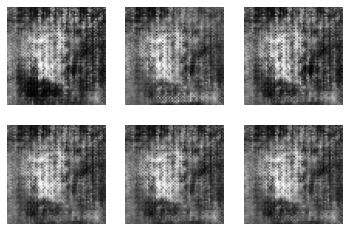

2901 [D loss: 0.660857, acc.: 77.34%] [G loss: 0.771653]
2902 [D loss: 0.671705, acc.: 66.80%] [G loss: 0.757083]
2903 [D loss: 0.658262, acc.: 69.92%] [G loss: 0.754037]
2904 [D loss: 0.674222, acc.: 63.67%] [G loss: 0.747816]
2905 [D loss: 0.676143, acc.: 62.11%] [G loss: 0.740342]
2906 [D loss: 0.677802, acc.: 58.20%] [G loss: 0.734399]
2907 [D loss: 0.674393, acc.: 57.03%] [G loss: 0.734179]
2908 [D loss: 0.668376, acc.: 62.50%] [G loss: 0.747545]
2909 [D loss: 0.674091, acc.: 63.67%] [G loss: 0.768460]
2910 [D loss: 0.654071, acc.: 72.66%] [G loss: 0.783747]
2911 [D loss: 0.633690, acc.: 78.91%] [G loss: 0.808279]
2912 [D loss: 0.641331, acc.: 73.44%] [G loss: 0.824959]
2913 [D loss: 0.637062, acc.: 71.88%] [G loss: 0.837263]
2914 [D loss: 0.613036, acc.: 73.05%] [G loss: 0.861849]
2915 [D loss: 0.631622, acc.: 73.83%] [G loss: 0.858869]
2916 [D loss: 0.627746, acc.: 74.22%] [G loss: 0.870608]
2917 [D loss: 0.619460, acc.: 76.17%] [G loss: 0.861967]
2918 [D loss: 0.618582, acc.: 7

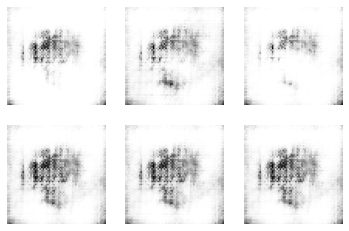

2951 [D loss: 0.726291, acc.: 36.33%] [G loss: 0.886259]
2952 [D loss: 0.650014, acc.: 69.92%] [G loss: 1.087252]
2953 [D loss: 0.573872, acc.: 73.44%] [G loss: 1.318186]
2954 [D loss: 0.511444, acc.: 77.73%] [G loss: 1.531214]
2955 [D loss: 0.456863, acc.: 78.12%] [G loss: 1.783145]
2956 [D loss: 0.432725, acc.: 80.47%] [G loss: 2.009643]
2957 [D loss: 0.403162, acc.: 83.98%] [G loss: 2.224851]
2958 [D loss: 0.361667, acc.: 89.06%] [G loss: 2.327919]
2959 [D loss: 0.347428, acc.: 88.67%] [G loss: 2.401450]
2960 [D loss: 0.335493, acc.: 90.62%] [G loss: 2.457333]
2961 [D loss: 0.336076, acc.: 92.58%] [G loss: 2.237295]
2962 [D loss: 0.324670, acc.: 94.53%] [G loss: 2.082856]
2963 [D loss: 0.373555, acc.: 92.19%] [G loss: 1.778736]
2964 [D loss: 0.435249, acc.: 92.97%] [G loss: 1.361226]
2965 [D loss: 0.569043, acc.: 72.27%] [G loss: 0.883108]
2966 [D loss: 0.759246, acc.: 44.14%] [G loss: 0.532715]
2967 [D loss: 0.821219, acc.: 40.23%] [G loss: 0.482001]
2968 [D loss: 0.814931, acc.: 3

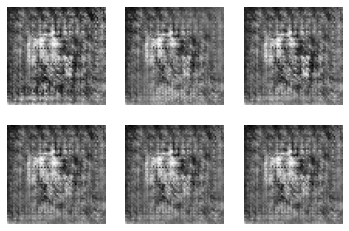

3001 [D loss: 0.715797, acc.: 26.17%] [G loss: 0.675140]
3002 [D loss: 0.710727, acc.: 29.69%] [G loss: 0.683931]
3003 [D loss: 0.705793, acc.: 31.25%] [G loss: 0.697888]
3004 [D loss: 0.713056, acc.: 33.98%] [G loss: 0.699173]
3005 [D loss: 0.697696, acc.: 50.39%] [G loss: 0.714357]
3006 [D loss: 0.694007, acc.: 56.25%] [G loss: 0.720676]
3007 [D loss: 0.684996, acc.: 57.42%] [G loss: 0.725411]
3008 [D loss: 0.689559, acc.: 57.42%] [G loss: 0.734941]
3009 [D loss: 0.686195, acc.: 60.16%] [G loss: 0.738021]
3010 [D loss: 0.675287, acc.: 64.45%] [G loss: 0.748948]
3011 [D loss: 0.673820, acc.: 64.84%] [G loss: 0.746658]
3012 [D loss: 0.674772, acc.: 64.45%] [G loss: 0.751209]
3013 [D loss: 0.678914, acc.: 61.33%] [G loss: 0.749591]
3014 [D loss: 0.672243, acc.: 65.23%] [G loss: 0.760728]
3015 [D loss: 0.675882, acc.: 62.89%] [G loss: 0.755420]
3016 [D loss: 0.664232, acc.: 66.02%] [G loss: 0.765572]
3017 [D loss: 0.658169, acc.: 67.58%] [G loss: 0.766584]
3018 [D loss: 0.654732, acc.: 6

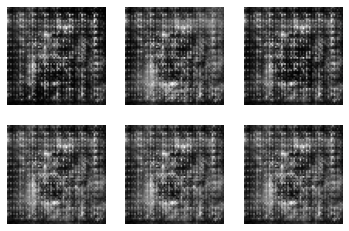

3051 [D loss: 0.766170, acc.: 49.61%] [G loss: 0.778403]
3052 [D loss: 0.773578, acc.: 39.84%] [G loss: 0.722952]
3053 [D loss: 0.736604, acc.: 36.72%] [G loss: 0.719878]
3054 [D loss: 0.775551, acc.: 23.44%] [G loss: 0.698305]
3055 [D loss: 0.747591, acc.: 24.22%] [G loss: 0.705157]
3056 [D loss: 0.747325, acc.: 22.27%] [G loss: 0.706016]
3057 [D loss: 0.726318, acc.: 32.03%] [G loss: 0.719171]
3058 [D loss: 0.741924, acc.: 32.81%] [G loss: 0.721729]
3059 [D loss: 0.726565, acc.: 44.53%] [G loss: 0.732073]
3060 [D loss: 0.696042, acc.: 58.98%] [G loss: 0.741152]
3061 [D loss: 0.714395, acc.: 57.81%] [G loss: 0.751565]
3062 [D loss: 0.702843, acc.: 58.59%] [G loss: 0.757061]
3063 [D loss: 0.702996, acc.: 62.11%] [G loss: 0.762185]
3064 [D loss: 0.663475, acc.: 61.72%] [G loss: 0.756996]
3065 [D loss: 0.682956, acc.: 59.38%] [G loss: 0.752123]
3066 [D loss: 0.691772, acc.: 55.47%] [G loss: 0.737417]
3067 [D loss: 0.684866, acc.: 47.27%] [G loss: 0.726625]
3068 [D loss: 0.688340, acc.: 2

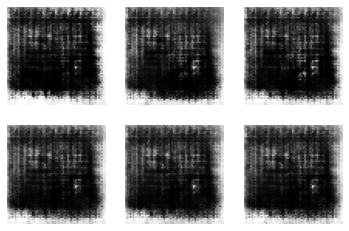

3101 [D loss: 0.735857, acc.: 38.28%] [G loss: 0.813186]
3102 [D loss: 0.710700, acc.: 57.03%] [G loss: 0.900639]
3103 [D loss: 0.654730, acc.: 71.09%] [G loss: 0.971058]
3104 [D loss: 0.634242, acc.: 66.41%] [G loss: 1.076326]
3105 [D loss: 0.604943, acc.: 69.14%] [G loss: 1.149007]
3106 [D loss: 0.602233, acc.: 68.36%] [G loss: 1.216577]
3107 [D loss: 0.569533, acc.: 74.22%] [G loss: 1.217529]
3108 [D loss: 0.579847, acc.: 71.88%] [G loss: 1.176736]
3109 [D loss: 0.621009, acc.: 75.00%] [G loss: 1.081338]
3110 [D loss: 0.640601, acc.: 72.66%] [G loss: 0.947729]
3111 [D loss: 0.678272, acc.: 68.75%] [G loss: 0.832729]
3112 [D loss: 0.700694, acc.: 46.09%] [G loss: 0.740068]
3113 [D loss: 0.741374, acc.: 32.81%] [G loss: 0.678568]
3114 [D loss: 0.756824, acc.: 27.34%] [G loss: 0.661264]
3115 [D loss: 0.752604, acc.: 28.12%] [G loss: 0.658346]
3116 [D loss: 0.742807, acc.: 30.08%] [G loss: 0.642786]
3117 [D loss: 0.732159, acc.: 32.03%] [G loss: 0.643250]
3118 [D loss: 0.730416, acc.: 2

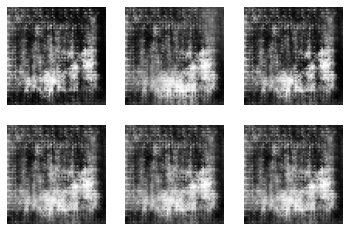

3151 [D loss: 0.650402, acc.: 81.64%] [G loss: 0.786320]
3152 [D loss: 0.654032, acc.: 79.30%] [G loss: 0.782938]
3153 [D loss: 0.657328, acc.: 81.64%] [G loss: 0.772676]
3154 [D loss: 0.670219, acc.: 75.00%] [G loss: 0.759396]
3155 [D loss: 0.672683, acc.: 72.27%] [G loss: 0.749714]
3156 [D loss: 0.668028, acc.: 62.89%] [G loss: 0.741013]
3157 [D loss: 0.687968, acc.: 43.36%] [G loss: 0.727662]
3158 [D loss: 0.686199, acc.: 35.16%] [G loss: 0.719114]
3159 [D loss: 0.682902, acc.: 38.67%] [G loss: 0.725516]
3160 [D loss: 0.681358, acc.: 44.92%] [G loss: 0.729713]
3161 [D loss: 0.703056, acc.: 35.94%] [G loss: 0.727887]
3162 [D loss: 0.699552, acc.: 33.59%] [G loss: 0.732164]
3163 [D loss: 0.683996, acc.: 46.88%] [G loss: 0.741370]
3164 [D loss: 0.686192, acc.: 48.44%] [G loss: 0.763214]
3165 [D loss: 0.693541, acc.: 44.14%] [G loss: 0.733086]
3166 [D loss: 0.683024, acc.: 50.39%] [G loss: 0.747710]
3167 [D loss: 0.684504, acc.: 46.48%] [G loss: 0.748490]
3168 [D loss: 0.682757, acc.: 5

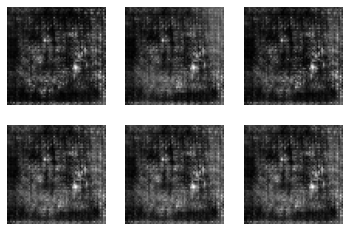

3201 [D loss: 0.592871, acc.: 77.73%] [G loss: 1.023417]
3202 [D loss: 0.614183, acc.: 77.73%] [G loss: 0.914872]
3203 [D loss: 0.656318, acc.: 78.52%] [G loss: 0.820833]
3204 [D loss: 0.684783, acc.: 69.92%] [G loss: 0.742004]
3205 [D loss: 0.705229, acc.: 33.20%] [G loss: 0.699412]
3206 [D loss: 0.711324, acc.: 30.86%] [G loss: 0.671913]
3207 [D loss: 0.720384, acc.: 28.91%] [G loss: 0.656719]
3208 [D loss: 0.734215, acc.: 28.12%] [G loss: 0.646706]
3209 [D loss: 0.736371, acc.: 28.52%] [G loss: 0.643288]
3210 [D loss: 0.732272, acc.: 27.73%] [G loss: 0.645356]
3211 [D loss: 0.731983, acc.: 26.17%] [G loss: 0.646383]
3212 [D loss: 0.718886, acc.: 27.73%] [G loss: 0.652322]
3213 [D loss: 0.719625, acc.: 25.00%] [G loss: 0.656496]
3214 [D loss: 0.713219, acc.: 25.39%] [G loss: 0.661896]
3215 [D loss: 0.715895, acc.: 21.48%] [G loss: 0.670063]
3216 [D loss: 0.703761, acc.: 26.95%] [G loss: 0.676783]
3217 [D loss: 0.714925, acc.: 24.61%] [G loss: 0.680294]
3218 [D loss: 0.695543, acc.: 2

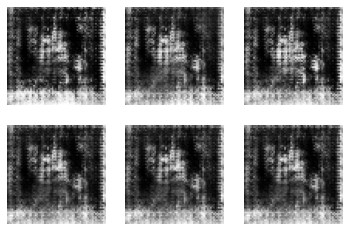

3251 [D loss: 0.781115, acc.: 28.91%] [G loss: 0.597479]
3252 [D loss: 0.802145, acc.: 27.73%] [G loss: 0.589518]
3253 [D loss: 0.787023, acc.: 28.12%] [G loss: 0.606743]
3254 [D loss: 0.769835, acc.: 26.95%] [G loss: 0.640809]
3255 [D loss: 0.755683, acc.: 32.81%] [G loss: 0.699264]
3256 [D loss: 0.710679, acc.: 46.88%] [G loss: 0.802074]
3257 [D loss: 0.667296, acc.: 67.58%] [G loss: 0.908884]
3258 [D loss: 0.620345, acc.: 72.27%] [G loss: 1.052674]
3259 [D loss: 0.577224, acc.: 80.08%] [G loss: 1.142861]
3260 [D loss: 0.584369, acc.: 74.22%] [G loss: 1.156037]
3261 [D loss: 0.582404, acc.: 76.95%] [G loss: 1.122326]
3262 [D loss: 0.632377, acc.: 75.00%] [G loss: 1.000696]
3263 [D loss: 0.671149, acc.: 75.78%] [G loss: 0.838628]
3264 [D loss: 0.713809, acc.: 34.77%] [G loss: 0.732992]
3265 [D loss: 0.758582, acc.: 17.58%] [G loss: 0.681683]
3266 [D loss: 0.750097, acc.: 26.56%] [G loss: 0.651653]
3267 [D loss: 0.767926, acc.: 23.44%] [G loss: 0.635513]
3268 [D loss: 0.765107, acc.: 2

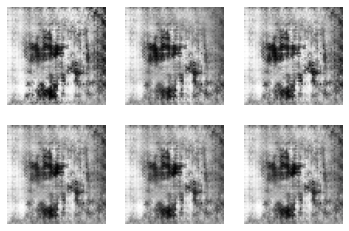

3301 [D loss: 0.647019, acc.: 79.69%] [G loss: 0.804809]
3302 [D loss: 0.651405, acc.: 73.44%] [G loss: 0.809062]
3303 [D loss: 0.637622, acc.: 76.95%] [G loss: 0.826280]
3304 [D loss: 0.637551, acc.: 75.78%] [G loss: 0.831682]
3305 [D loss: 0.637982, acc.: 75.00%] [G loss: 0.834319]
3306 [D loss: 0.631836, acc.: 76.56%] [G loss: 0.842259]
3307 [D loss: 0.625879, acc.: 79.30%] [G loss: 0.846297]
3308 [D loss: 0.614190, acc.: 85.55%] [G loss: 0.843349]
3309 [D loss: 0.624075, acc.: 80.08%] [G loss: 0.835583]
3310 [D loss: 0.618931, acc.: 81.25%] [G loss: 0.829135]
3311 [D loss: 0.625237, acc.: 79.69%] [G loss: 0.825490]
3312 [D loss: 0.630459, acc.: 82.03%] [G loss: 0.812675]
3313 [D loss: 0.627203, acc.: 83.20%] [G loss: 0.814742]
3314 [D loss: 0.642213, acc.: 79.30%] [G loss: 0.802725]
3315 [D loss: 0.640796, acc.: 81.64%] [G loss: 0.793832]
3316 [D loss: 0.642247, acc.: 79.30%] [G loss: 0.782912]
3317 [D loss: 0.650848, acc.: 75.39%] [G loss: 0.783159]
3318 [D loss: 0.648317, acc.: 7

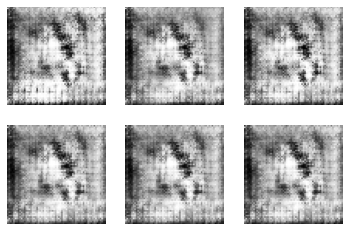

3351 [D loss: 0.772975, acc.: 35.94%] [G loss: 0.599732]
3352 [D loss: 0.749564, acc.: 33.98%] [G loss: 0.651329]
3353 [D loss: 0.727513, acc.: 33.98%] [G loss: 0.709695]
3354 [D loss: 0.695671, acc.: 60.94%] [G loss: 0.757652]
3355 [D loss: 0.680051, acc.: 61.33%] [G loss: 0.797256]
3356 [D loss: 0.651241, acc.: 71.48%] [G loss: 0.818055]
3357 [D loss: 0.663898, acc.: 72.27%] [G loss: 0.818559]
3358 [D loss: 0.672360, acc.: 71.09%] [G loss: 0.809414]
3359 [D loss: 0.658723, acc.: 66.02%] [G loss: 0.780562]
3360 [D loss: 0.665808, acc.: 60.94%] [G loss: 0.745737]
3361 [D loss: 0.690097, acc.: 38.28%] [G loss: 0.729563]
3362 [D loss: 0.705126, acc.: 32.81%] [G loss: 0.703047]
3363 [D loss: 0.716402, acc.: 30.47%] [G loss: 0.684021]
3364 [D loss: 0.711736, acc.: 34.38%] [G loss: 0.683057]
3365 [D loss: 0.702290, acc.: 33.20%] [G loss: 0.679947]
3366 [D loss: 0.716118, acc.: 31.25%] [G loss: 0.685101]
3367 [D loss: 0.696228, acc.: 35.16%] [G loss: 0.687501]
3368 [D loss: 0.711105, acc.: 2

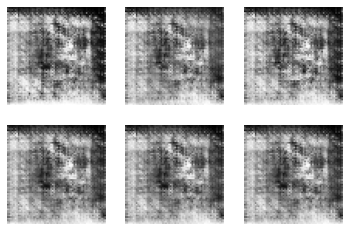

3401 [D loss: 0.715164, acc.: 37.11%] [G loss: 0.720457]
3402 [D loss: 0.715116, acc.: 39.45%] [G loss: 0.714060]
3403 [D loss: 0.719038, acc.: 30.08%] [G loss: 0.714790]
3404 [D loss: 0.719807, acc.: 29.30%] [G loss: 0.702721]
3405 [D loss: 0.723128, acc.: 24.61%] [G loss: 0.706963]
3406 [D loss: 0.719944, acc.: 28.91%] [G loss: 0.702502]
3407 [D loss: 0.714772, acc.: 33.20%] [G loss: 0.709420]
3408 [D loss: 0.719362, acc.: 28.52%] [G loss: 0.696724]
3409 [D loss: 0.724132, acc.: 22.27%] [G loss: 0.689510]
3410 [D loss: 0.731933, acc.: 18.75%] [G loss: 0.682150]
3411 [D loss: 0.737376, acc.: 25.00%] [G loss: 0.678118]
3412 [D loss: 0.745738, acc.: 21.09%] [G loss: 0.673776]
3413 [D loss: 0.757569, acc.: 19.53%] [G loss: 0.660384]
3414 [D loss: 0.754619, acc.: 21.48%] [G loss: 0.662839]
3415 [D loss: 0.744730, acc.: 25.00%] [G loss: 0.680571]
3416 [D loss: 0.736790, acc.: 18.75%] [G loss: 0.725482]
3417 [D loss: 0.710205, acc.: 40.62%] [G loss: 0.769917]
3418 [D loss: 0.694021, acc.: 5

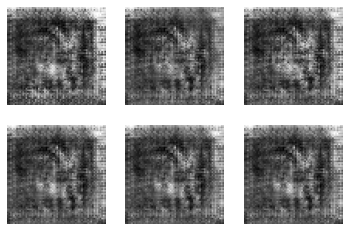

3451 [D loss: 0.737485, acc.: 24.22%] [G loss: 0.672103]
3452 [D loss: 0.722222, acc.: 29.30%] [G loss: 0.677801]
3453 [D loss: 0.728686, acc.: 25.78%] [G loss: 0.675871]
3454 [D loss: 0.716983, acc.: 24.61%] [G loss: 0.683284]
3455 [D loss: 0.706694, acc.: 30.47%] [G loss: 0.688312]
3456 [D loss: 0.708735, acc.: 29.69%] [G loss: 0.694197]
3457 [D loss: 0.711764, acc.: 25.78%] [G loss: 0.693510]
3458 [D loss: 0.712408, acc.: 32.03%] [G loss: 0.693515]
3459 [D loss: 0.720478, acc.: 28.52%] [G loss: 0.698085]
3460 [D loss: 0.702563, acc.: 33.59%] [G loss: 0.700453]
3461 [D loss: 0.694191, acc.: 38.28%] [G loss: 0.704316]
3462 [D loss: 0.711566, acc.: 34.38%] [G loss: 0.709095]
3463 [D loss: 0.704810, acc.: 35.16%] [G loss: 0.709906]
3464 [D loss: 0.697071, acc.: 36.72%] [G loss: 0.709889]
3465 [D loss: 0.696997, acc.: 37.89%] [G loss: 0.709145]
3466 [D loss: 0.682005, acc.: 44.14%] [G loss: 0.712371]
3467 [D loss: 0.694669, acc.: 35.16%] [G loss: 0.712144]
3468 [D loss: 0.697463, acc.: 3

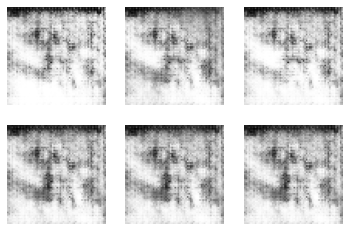

3501 [D loss: 0.524586, acc.: 83.98%] [G loss: 1.169524]
3502 [D loss: 0.539475, acc.: 82.81%] [G loss: 1.118351]
3503 [D loss: 0.547539, acc.: 85.16%] [G loss: 1.032627]
3504 [D loss: 0.576526, acc.: 85.55%] [G loss: 0.923648]
3505 [D loss: 0.616319, acc.: 85.94%] [G loss: 0.814988]
3506 [D loss: 0.638236, acc.: 76.56%] [G loss: 0.743341]
3507 [D loss: 0.669802, acc.: 41.02%] [G loss: 0.705569]
3508 [D loss: 0.664415, acc.: 38.28%] [G loss: 0.690565]
3509 [D loss: 0.676865, acc.: 36.33%] [G loss: 0.677231]
3510 [D loss: 0.698567, acc.: 33.98%] [G loss: 0.662931]
3511 [D loss: 0.701432, acc.: 31.64%] [G loss: 0.654997]
3512 [D loss: 0.722433, acc.: 33.59%] [G loss: 0.635082]
3513 [D loss: 0.727616, acc.: 32.42%] [G loss: 0.621424]
3514 [D loss: 0.755725, acc.: 30.08%] [G loss: 0.611760]
3515 [D loss: 0.764703, acc.: 25.78%] [G loss: 0.619292]
3516 [D loss: 0.761739, acc.: 27.73%] [G loss: 0.617521]
3517 [D loss: 0.737741, acc.: 37.50%] [G loss: 0.638614]
3518 [D loss: 0.752180, acc.: 5

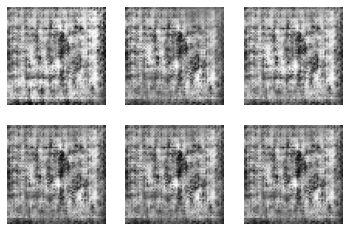

3551 [D loss: 0.689723, acc.: 45.31%] [G loss: 0.718726]
3552 [D loss: 0.698839, acc.: 36.72%] [G loss: 0.710846]
3553 [D loss: 0.694369, acc.: 41.80%] [G loss: 0.709999]
3554 [D loss: 0.691601, acc.: 44.92%] [G loss: 0.716877]
3555 [D loss: 0.702606, acc.: 42.19%] [G loss: 0.724224]
3556 [D loss: 0.682316, acc.: 50.78%] [G loss: 0.757473]
3557 [D loss: 0.686094, acc.: 43.36%] [G loss: 0.785883]
3558 [D loss: 0.665901, acc.: 68.36%] [G loss: 0.827722]
3559 [D loss: 0.635391, acc.: 77.34%] [G loss: 0.885646]
3560 [D loss: 0.610870, acc.: 76.95%] [G loss: 0.948156]
3561 [D loss: 0.598874, acc.: 72.66%] [G loss: 1.004382]
3562 [D loss: 0.583109, acc.: 74.61%] [G loss: 1.040849]
3563 [D loss: 0.573692, acc.: 76.56%] [G loss: 1.055098]
3564 [D loss: 0.563091, acc.: 80.08%] [G loss: 1.042423]
3565 [D loss: 0.564486, acc.: 80.08%] [G loss: 1.030250]
3566 [D loss: 0.582713, acc.: 78.12%] [G loss: 0.954906]
3567 [D loss: 0.600674, acc.: 78.91%] [G loss: 0.904337]
3568 [D loss: 0.593783, acc.: 8

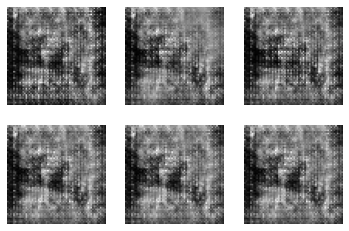

3601 [D loss: 0.736888, acc.: 26.56%] [G loss: 0.673671]
3602 [D loss: 0.711180, acc.: 38.28%] [G loss: 0.694604]
3603 [D loss: 0.712975, acc.: 50.39%] [G loss: 0.712342]
3604 [D loss: 0.711229, acc.: 48.05%] [G loss: 0.723876]
3605 [D loss: 0.701448, acc.: 50.00%] [G loss: 0.733110]
3606 [D loss: 0.699408, acc.: 52.34%] [G loss: 0.746858]
3607 [D loss: 0.690872, acc.: 57.81%] [G loss: 0.757024]
3608 [D loss: 0.682306, acc.: 73.05%] [G loss: 0.765393]
3609 [D loss: 0.666882, acc.: 72.27%] [G loss: 0.776852]
3610 [D loss: 0.667940, acc.: 73.83%] [G loss: 0.779212]
3611 [D loss: 0.646127, acc.: 78.91%] [G loss: 0.792253]
3612 [D loss: 0.653167, acc.: 73.83%] [G loss: 0.800239]
3613 [D loss: 0.636579, acc.: 76.17%] [G loss: 0.804343]
3614 [D loss: 0.630599, acc.: 77.73%] [G loss: 0.807724]
3615 [D loss: 0.637189, acc.: 74.22%] [G loss: 0.815810]
3616 [D loss: 0.614440, acc.: 81.64%] [G loss: 0.814565]
3617 [D loss: 0.611576, acc.: 80.86%] [G loss: 0.819536]
3618 [D loss: 0.637870, acc.: 7

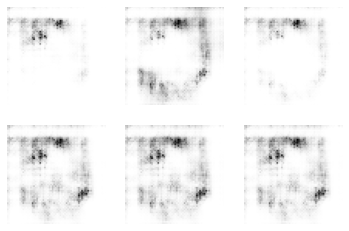

3651 [D loss: 0.396848, acc.: 84.77%] [G loss: 1.899523]
3652 [D loss: 0.378617, acc.: 87.11%] [G loss: 1.945473]
3653 [D loss: 0.364687, acc.: 88.28%] [G loss: 2.016257]
3654 [D loss: 0.369744, acc.: 90.62%] [G loss: 1.925029]
3655 [D loss: 0.374681, acc.: 91.41%] [G loss: 1.756478]
3656 [D loss: 0.374924, acc.: 94.92%] [G loss: 1.487619]
3657 [D loss: 0.454191, acc.: 93.36%] [G loss: 1.194825]
3658 [D loss: 0.507774, acc.: 89.06%] [G loss: 0.958622]
3659 [D loss: 0.597844, acc.: 59.77%] [G loss: 0.788098]
3660 [D loss: 0.705924, acc.: 42.97%] [G loss: 0.611028]
3661 [D loss: 0.759353, acc.: 38.67%] [G loss: 0.583436]
3662 [D loss: 0.796657, acc.: 38.28%] [G loss: 0.553707]
3663 [D loss: 0.819405, acc.: 35.94%] [G loss: 0.582678]
3664 [D loss: 0.790661, acc.: 34.77%] [G loss: 0.650118]
3665 [D loss: 0.753107, acc.: 32.42%] [G loss: 0.769693]
3666 [D loss: 0.694361, acc.: 55.08%] [G loss: 0.931558]
3667 [D loss: 0.626489, acc.: 77.34%] [G loss: 1.116719]
3668 [D loss: 0.587606, acc.: 7

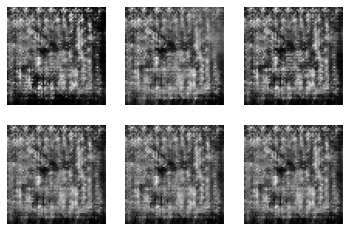

3701 [D loss: 0.631018, acc.: 78.12%] [G loss: 0.846856]
3702 [D loss: 0.628234, acc.: 78.52%] [G loss: 0.854403]
3703 [D loss: 0.631618, acc.: 80.08%] [G loss: 0.844181]
3704 [D loss: 0.637651, acc.: 78.91%] [G loss: 0.841812]
3705 [D loss: 0.633145, acc.: 80.47%] [G loss: 0.831744]
3706 [D loss: 0.644272, acc.: 78.52%] [G loss: 0.820762]
3707 [D loss: 0.651606, acc.: 78.12%] [G loss: 0.809432]
3708 [D loss: 0.645786, acc.: 81.25%] [G loss: 0.795750]
3709 [D loss: 0.656889, acc.: 79.30%] [G loss: 0.788393]
3710 [D loss: 0.657058, acc.: 78.52%] [G loss: 0.773991]
3711 [D loss: 0.674826, acc.: 71.88%] [G loss: 0.757768]
3712 [D loss: 0.670091, acc.: 60.16%] [G loss: 0.746065]
3713 [D loss: 0.665549, acc.: 55.08%] [G loss: 0.736109]
3714 [D loss: 0.694792, acc.: 43.75%] [G loss: 0.722401]
3715 [D loss: 0.685624, acc.: 46.09%] [G loss: 0.723491]
3716 [D loss: 0.686161, acc.: 41.02%] [G loss: 0.714457]
3717 [D loss: 0.700971, acc.: 39.06%] [G loss: 0.711989]
3718 [D loss: 0.693221, acc.: 3

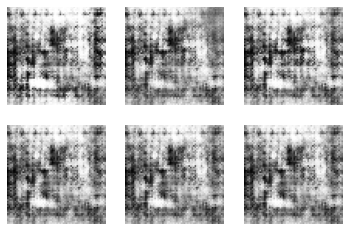

3751 [D loss: 0.562937, acc.: 92.97%] [G loss: 0.854215]
3752 [D loss: 0.613531, acc.: 80.08%] [G loss: 0.766544]
3753 [D loss: 0.647522, acc.: 42.58%] [G loss: 0.690819]
3754 [D loss: 0.697073, acc.: 38.28%] [G loss: 0.630106]
3755 [D loss: 0.730787, acc.: 38.28%] [G loss: 0.597767]
3756 [D loss: 0.752982, acc.: 36.72%] [G loss: 0.571522]
3757 [D loss: 0.788407, acc.: 34.38%] [G loss: 0.562485]
3758 [D loss: 0.788332, acc.: 32.81%] [G loss: 0.561895]
3759 [D loss: 0.787824, acc.: 28.91%] [G loss: 0.583478]
3760 [D loss: 0.775719, acc.: 29.30%] [G loss: 0.601937]
3761 [D loss: 0.789598, acc.: 25.00%] [G loss: 0.631719]
3762 [D loss: 0.752991, acc.: 26.95%] [G loss: 0.674737]
3763 [D loss: 0.726500, acc.: 30.47%] [G loss: 0.725842]
3764 [D loss: 0.713040, acc.: 48.83%] [G loss: 0.768404]
3765 [D loss: 0.689430, acc.: 54.30%] [G loss: 0.832424]
3766 [D loss: 0.662427, acc.: 68.75%] [G loss: 0.882440]
3767 [D loss: 0.641992, acc.: 74.22%] [G loss: 0.917783]
3768 [D loss: 0.630121, acc.: 7

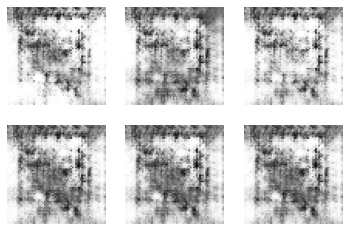

3801 [D loss: 0.648958, acc.: 67.97%] [G loss: 0.890909]
3802 [D loss: 0.634591, acc.: 73.44%] [G loss: 0.902204]
3803 [D loss: 0.630608, acc.: 71.48%] [G loss: 0.918494]
3804 [D loss: 0.631673, acc.: 75.00%] [G loss: 0.884747]
3805 [D loss: 0.639246, acc.: 75.78%] [G loss: 0.871995]
3806 [D loss: 0.637309, acc.: 76.56%] [G loss: 0.865671]
3807 [D loss: 0.637224, acc.: 77.73%] [G loss: 0.818554]
3808 [D loss: 0.661892, acc.: 67.97%] [G loss: 0.796288]
3809 [D loss: 0.665242, acc.: 58.98%] [G loss: 0.761837]
3810 [D loss: 0.691215, acc.: 46.09%] [G loss: 0.725423]
3811 [D loss: 0.672787, acc.: 59.77%] [G loss: 0.732663]
3812 [D loss: 0.682039, acc.: 57.03%] [G loss: 0.720222]
3813 [D loss: 0.704634, acc.: 50.00%] [G loss: 0.706956]
3814 [D loss: 0.690467, acc.: 50.00%] [G loss: 0.706418]
3815 [D loss: 0.702832, acc.: 46.09%] [G loss: 0.700937]
3816 [D loss: 0.699975, acc.: 37.11%] [G loss: 0.695211]
3817 [D loss: 0.706031, acc.: 37.89%] [G loss: 0.697855]
3818 [D loss: 0.703776, acc.: 3

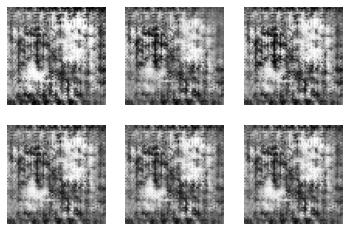

3851 [D loss: 0.714768, acc.: 32.03%] [G loss: 0.678501]
3852 [D loss: 0.717429, acc.: 25.39%] [G loss: 0.686602]
3853 [D loss: 0.718170, acc.: 25.39%] [G loss: 0.695380]
3854 [D loss: 0.705247, acc.: 28.52%] [G loss: 0.705915]
3855 [D loss: 0.699766, acc.: 37.11%] [G loss: 0.714031]
3856 [D loss: 0.703111, acc.: 45.31%] [G loss: 0.722945]
3857 [D loss: 0.694197, acc.: 52.73%] [G loss: 0.726875]
3858 [D loss: 0.695530, acc.: 56.64%] [G loss: 0.729334]
3859 [D loss: 0.690371, acc.: 60.16%] [G loss: 0.730974]
3860 [D loss: 0.696397, acc.: 59.77%] [G loss: 0.734273]
3861 [D loss: 0.689360, acc.: 62.50%] [G loss: 0.735636]
3862 [D loss: 0.694781, acc.: 59.38%] [G loss: 0.734367]
3863 [D loss: 0.691050, acc.: 61.72%] [G loss: 0.735869]
3864 [D loss: 0.688350, acc.: 64.06%] [G loss: 0.740237]
3865 [D loss: 0.682357, acc.: 62.50%] [G loss: 0.741257]
3866 [D loss: 0.685570, acc.: 62.50%] [G loss: 0.744271]
3867 [D loss: 0.696445, acc.: 56.25%] [G loss: 0.742408]
3868 [D loss: 0.689103, acc.: 6

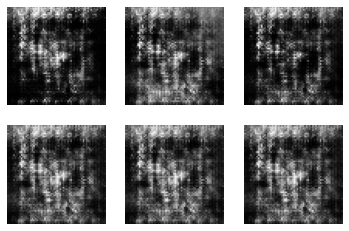

3901 [D loss: 0.650269, acc.: 72.66%] [G loss: 0.824989]
3902 [D loss: 0.640159, acc.: 73.83%] [G loss: 0.838581]
3903 [D loss: 0.639062, acc.: 75.00%] [G loss: 0.862752]
3904 [D loss: 0.627158, acc.: 76.56%] [G loss: 0.864292]
3905 [D loss: 0.625103, acc.: 77.34%] [G loss: 0.864830]
3906 [D loss: 0.628586, acc.: 74.22%] [G loss: 0.853462]
3907 [D loss: 0.640207, acc.: 77.34%] [G loss: 0.808551]
3908 [D loss: 0.673377, acc.: 47.66%] [G loss: 0.745709]
3909 [D loss: 0.692627, acc.: 40.23%] [G loss: 0.683709]
3910 [D loss: 0.715794, acc.: 30.86%] [G loss: 0.647919]
3911 [D loss: 0.748986, acc.: 27.34%] [G loss: 0.625996]
3912 [D loss: 0.771867, acc.: 25.39%] [G loss: 0.606834]
3913 [D loss: 0.764713, acc.: 26.17%] [G loss: 0.596957]
3914 [D loss: 0.782795, acc.: 29.30%] [G loss: 0.589358]
3915 [D loss: 0.772069, acc.: 26.56%] [G loss: 0.606745]
3916 [D loss: 0.771768, acc.: 22.27%] [G loss: 0.621991]
3917 [D loss: 0.750883, acc.: 26.56%] [G loss: 0.650728]
3918 [D loss: 0.786504, acc.: 1

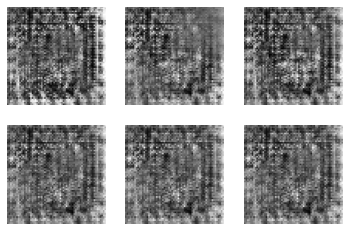

3951 [D loss: 0.813240, acc.: 17.58%] [G loss: 0.601440]
3952 [D loss: 0.796591, acc.: 18.36%] [G loss: 0.607649]
3953 [D loss: 0.817239, acc.: 13.67%] [G loss: 0.610732]
3954 [D loss: 0.789116, acc.: 16.02%] [G loss: 0.616458]
3955 [D loss: 0.791353, acc.: 16.80%] [G loss: 0.631976]
3956 [D loss: 0.784802, acc.: 13.67%] [G loss: 0.637155]
3957 [D loss: 0.787079, acc.: 14.84%] [G loss: 0.641438]
3958 [D loss: 0.768584, acc.: 17.58%] [G loss: 0.646673]
3959 [D loss: 0.774917, acc.: 9.77%] [G loss: 0.652686]
3960 [D loss: 0.766185, acc.: 12.50%] [G loss: 0.663920]
3961 [D loss: 0.761593, acc.: 17.58%] [G loss: 0.670527]
3962 [D loss: 0.753595, acc.: 17.58%] [G loss: 0.674185]
3963 [D loss: 0.750151, acc.: 16.02%] [G loss: 0.679681]
3964 [D loss: 0.739604, acc.: 23.83%] [G loss: 0.691347]
3965 [D loss: 0.736446, acc.: 24.22%] [G loss: 0.699563]
3966 [D loss: 0.742531, acc.: 21.48%] [G loss: 0.703032]
3967 [D loss: 0.727293, acc.: 33.59%] [G loss: 0.719724]
3968 [D loss: 0.718433, acc.: 33

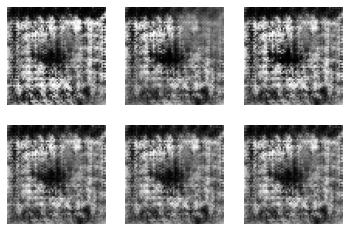

4001 [D loss: 0.708310, acc.: 27.34%] [G loss: 0.671242]
4002 [D loss: 0.729676, acc.: 25.78%] [G loss: 0.661859]
4003 [D loss: 0.714266, acc.: 28.91%] [G loss: 0.648524]
4004 [D loss: 0.731293, acc.: 28.12%] [G loss: 0.639841]
4005 [D loss: 0.760033, acc.: 19.92%] [G loss: 0.626332]
4006 [D loss: 0.764255, acc.: 24.61%] [G loss: 0.609126]
4007 [D loss: 0.787057, acc.: 26.56%] [G loss: 0.590487]
4008 [D loss: 0.819481, acc.: 16.80%] [G loss: 0.576959]
4009 [D loss: 0.835153, acc.: 21.48%] [G loss: 0.548180]
4010 [D loss: 0.821574, acc.: 19.14%] [G loss: 0.605333]
4011 [D loss: 0.779110, acc.: 19.92%] [G loss: 0.690772]
4012 [D loss: 0.728334, acc.: 36.33%] [G loss: 0.792952]
4013 [D loss: 0.662633, acc.: 47.27%] [G loss: 0.941806]
4014 [D loss: 0.603569, acc.: 66.41%] [G loss: 1.117757]
4015 [D loss: 0.551823, acc.: 69.92%] [G loss: 1.306629]
4016 [D loss: 0.498744, acc.: 73.44%] [G loss: 1.527591]
4017 [D loss: 0.479789, acc.: 79.30%] [G loss: 1.611881]
4018 [D loss: 0.465415, acc.: 8

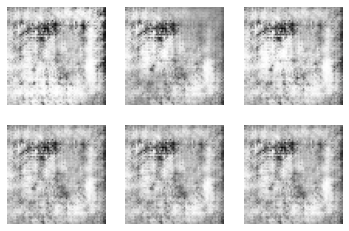

4051 [D loss: 0.657784, acc.: 79.69%] [G loss: 0.781285]
4052 [D loss: 0.650199, acc.: 82.42%] [G loss: 0.794755]
4053 [D loss: 0.650691, acc.: 80.47%] [G loss: 0.793830]
4054 [D loss: 0.652558, acc.: 79.30%] [G loss: 0.794267]
4055 [D loss: 0.636722, acc.: 85.55%] [G loss: 0.793072]
4056 [D loss: 0.654499, acc.: 82.03%] [G loss: 0.784276]
4057 [D loss: 0.650936, acc.: 82.03%] [G loss: 0.778249]
4058 [D loss: 0.642653, acc.: 84.77%] [G loss: 0.770813]
4059 [D loss: 0.655999, acc.: 81.25%] [G loss: 0.764631]
4060 [D loss: 0.661125, acc.: 77.34%] [G loss: 0.748706]
4061 [D loss: 0.676077, acc.: 67.97%] [G loss: 0.734967]
4062 [D loss: 0.678592, acc.: 47.27%] [G loss: 0.719052]
4063 [D loss: 0.688710, acc.: 31.25%] [G loss: 0.707654]
4064 [D loss: 0.695211, acc.: 28.52%] [G loss: 0.701455]
4065 [D loss: 0.702763, acc.: 29.30%] [G loss: 0.692078]
4066 [D loss: 0.700282, acc.: 27.34%] [G loss: 0.685745]
4067 [D loss: 0.715075, acc.: 24.22%] [G loss: 0.680883]
4068 [D loss: 0.720906, acc.: 2

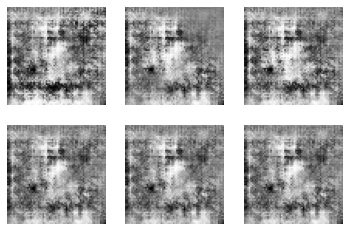

4101 [D loss: 0.675576, acc.: 50.78%] [G loss: 0.714260]
4102 [D loss: 0.663107, acc.: 61.72%] [G loss: 0.729269]
4103 [D loss: 0.665222, acc.: 64.45%] [G loss: 0.739172]
4104 [D loss: 0.665332, acc.: 74.61%] [G loss: 0.743069]
4105 [D loss: 0.650596, acc.: 79.30%] [G loss: 0.749432]
4106 [D loss: 0.651413, acc.: 81.25%] [G loss: 0.758747]
4107 [D loss: 0.649499, acc.: 81.64%] [G loss: 0.763469]
4108 [D loss: 0.652322, acc.: 80.86%] [G loss: 0.763449]
4109 [D loss: 0.651169, acc.: 78.91%] [G loss: 0.758917]
4110 [D loss: 0.645211, acc.: 80.08%] [G loss: 0.758669]
4111 [D loss: 0.649837, acc.: 73.83%] [G loss: 0.752512]
4112 [D loss: 0.649550, acc.: 76.56%] [G loss: 0.753333]
4113 [D loss: 0.650636, acc.: 69.14%] [G loss: 0.744179]
4114 [D loss: 0.651325, acc.: 63.67%] [G loss: 0.730415]
4115 [D loss: 0.667048, acc.: 51.17%] [G loss: 0.722906]
4116 [D loss: 0.661161, acc.: 49.22%] [G loss: 0.713366]
4117 [D loss: 0.677544, acc.: 46.88%] [G loss: 0.709996]
4118 [D loss: 0.687846, acc.: 4

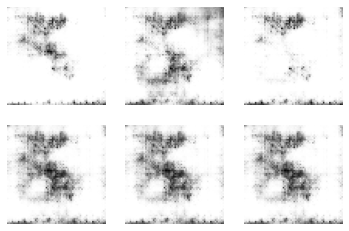

4151 [D loss: 0.621024, acc.: 72.27%] [G loss: 1.021531]
4152 [D loss: 0.582803, acc.: 77.73%] [G loss: 1.128048]
4153 [D loss: 0.542781, acc.: 83.59%] [G loss: 1.247524]
4154 [D loss: 0.508463, acc.: 83.98%] [G loss: 1.373388]
4155 [D loss: 0.485510, acc.: 86.33%] [G loss: 1.422888]
4156 [D loss: 0.469175, acc.: 92.58%] [G loss: 1.444681]
4157 [D loss: 0.497023, acc.: 92.19%] [G loss: 1.362857]
4158 [D loss: 0.522905, acc.: 91.02%] [G loss: 1.166450]
4159 [D loss: 0.587644, acc.: 82.81%] [G loss: 0.991484]
4160 [D loss: 0.641166, acc.: 55.47%] [G loss: 0.813005]
4161 [D loss: 0.672665, acc.: 55.86%] [G loss: 0.741855]
4162 [D loss: 0.711511, acc.: 45.70%] [G loss: 0.663836]
4163 [D loss: 0.758274, acc.: 37.50%] [G loss: 0.613541]
4164 [D loss: 0.778281, acc.: 33.98%] [G loss: 0.592763]
4165 [D loss: 0.775081, acc.: 33.98%] [G loss: 0.603726]
4166 [D loss: 0.758207, acc.: 33.59%] [G loss: 0.600905]
4167 [D loss: 0.760177, acc.: 29.30%] [G loss: 0.613074]
4168 [D loss: 0.730380, acc.: 3

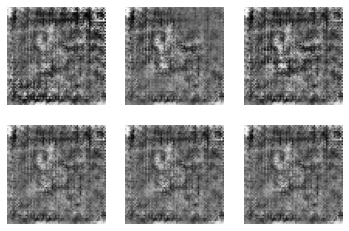

4201 [D loss: 0.651268, acc.: 78.91%] [G loss: 0.760818]
4202 [D loss: 0.648639, acc.: 77.73%] [G loss: 0.770146]
4203 [D loss: 0.645990, acc.: 76.56%] [G loss: 0.771379]
4204 [D loss: 0.648994, acc.: 74.61%] [G loss: 0.773484]
4205 [D loss: 0.646286, acc.: 76.56%] [G loss: 0.781767]
4206 [D loss: 0.635255, acc.: 78.12%] [G loss: 0.776636]
4207 [D loss: 0.646637, acc.: 77.34%] [G loss: 0.774002]
4208 [D loss: 0.658788, acc.: 69.92%] [G loss: 0.774850]
4209 [D loss: 0.644178, acc.: 76.95%] [G loss: 0.767393]
4210 [D loss: 0.651753, acc.: 72.27%] [G loss: 0.769701]
4211 [D loss: 0.654217, acc.: 72.27%] [G loss: 0.761873]
4212 [D loss: 0.646667, acc.: 74.61%] [G loss: 0.761068]
4213 [D loss: 0.655339, acc.: 72.27%] [G loss: 0.757414]
4214 [D loss: 0.645387, acc.: 71.09%] [G loss: 0.761114]
4215 [D loss: 0.660887, acc.: 67.58%] [G loss: 0.745988]
4216 [D loss: 0.657697, acc.: 71.09%] [G loss: 0.748189]
4217 [D loss: 0.669037, acc.: 62.50%] [G loss: 0.729256]
4218 [D loss: 0.664892, acc.: 5

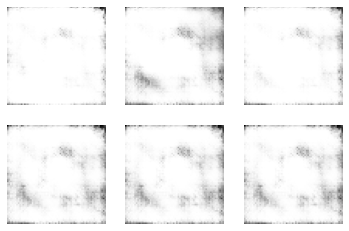

4251 [D loss: 0.617005, acc.: 70.31%] [G loss: 1.124412]
4252 [D loss: 0.571908, acc.: 69.92%] [G loss: 1.281282]
4253 [D loss: 0.513235, acc.: 76.95%] [G loss: 1.443746]
4254 [D loss: 0.489461, acc.: 80.08%] [G loss: 1.558741]
4255 [D loss: 0.455786, acc.: 87.89%] [G loss: 1.606027]
4256 [D loss: 0.457092, acc.: 88.28%] [G loss: 1.626176]
4257 [D loss: 0.465513, acc.: 91.80%] [G loss: 1.478424]
4258 [D loss: 0.473303, acc.: 93.36%] [G loss: 1.322168]
4259 [D loss: 0.537903, acc.: 88.28%] [G loss: 1.099915]
4260 [D loss: 0.584711, acc.: 85.94%] [G loss: 0.864652]
4261 [D loss: 0.650160, acc.: 48.44%] [G loss: 0.750293]
4262 [D loss: 0.691415, acc.: 42.97%] [G loss: 0.654855]
4263 [D loss: 0.723585, acc.: 41.02%] [G loss: 0.589745]
4264 [D loss: 0.757062, acc.: 38.28%] [G loss: 0.570887]
4265 [D loss: 0.747863, acc.: 40.23%] [G loss: 0.556442]
4266 [D loss: 0.787385, acc.: 33.98%] [G loss: 0.555601]
4267 [D loss: 0.780315, acc.: 33.20%] [G loss: 0.559204]
4268 [D loss: 0.780022, acc.: 3

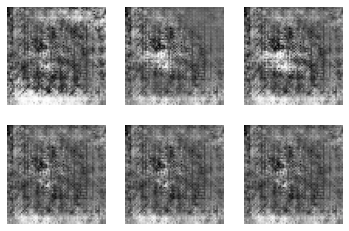

4301 [D loss: 0.745800, acc.: 22.66%] [G loss: 0.650819]
4302 [D loss: 0.754528, acc.: 17.58%] [G loss: 0.661816]
4303 [D loss: 0.741359, acc.: 20.70%] [G loss: 0.667596]
4304 [D loss: 0.744569, acc.: 18.75%] [G loss: 0.673650]
4305 [D loss: 0.749417, acc.: 13.28%] [G loss: 0.685703]
4306 [D loss: 0.743199, acc.: 19.53%] [G loss: 0.683035]
4307 [D loss: 0.732846, acc.: 32.42%] [G loss: 0.706311]
4308 [D loss: 0.726519, acc.: 36.72%] [G loss: 0.714160]
4309 [D loss: 0.724343, acc.: 39.06%] [G loss: 0.725367]
4310 [D loss: 0.714127, acc.: 44.14%] [G loss: 0.736313]
4311 [D loss: 0.724963, acc.: 42.19%] [G loss: 0.752516]
4312 [D loss: 0.705887, acc.: 46.88%] [G loss: 0.756443]
4313 [D loss: 0.693420, acc.: 54.69%] [G loss: 0.779282]
4314 [D loss: 0.687798, acc.: 58.20%] [G loss: 0.791949]
4315 [D loss: 0.689556, acc.: 53.12%] [G loss: 0.786036]
4316 [D loss: 0.689249, acc.: 55.08%] [G loss: 0.787965]
4317 [D loss: 0.684429, acc.: 57.03%] [G loss: 0.801496]
4318 [D loss: 0.679067, acc.: 5

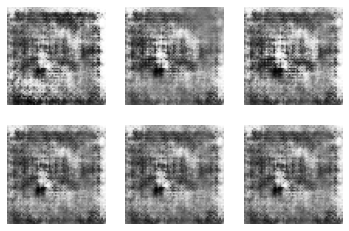

4351 [D loss: 0.640629, acc.: 75.00%] [G loss: 0.800882]
4352 [D loss: 0.651111, acc.: 74.61%] [G loss: 0.778602]
4353 [D loss: 0.640036, acc.: 72.27%] [G loss: 0.769232]
4354 [D loss: 0.684612, acc.: 50.00%] [G loss: 0.732057]
4355 [D loss: 0.706743, acc.: 33.98%] [G loss: 0.703764]
4356 [D loss: 0.701412, acc.: 36.33%] [G loss: 0.692404]
4357 [D loss: 0.707604, acc.: 35.16%] [G loss: 0.676981]
4358 [D loss: 0.749365, acc.: 28.52%] [G loss: 0.639164]
4359 [D loss: 0.764320, acc.: 25.39%] [G loss: 0.631374]
4360 [D loss: 0.764663, acc.: 26.17%] [G loss: 0.620939]
4361 [D loss: 0.762648, acc.: 25.39%] [G loss: 0.634100]
4362 [D loss: 0.782256, acc.: 21.88%] [G loss: 0.636849]
4363 [D loss: 0.786560, acc.: 17.58%] [G loss: 0.653246]
4364 [D loss: 0.777871, acc.: 19.14%] [G loss: 0.648930]
4365 [D loss: 0.783913, acc.: 18.75%] [G loss: 0.663583]
4366 [D loss: 0.775365, acc.: 33.20%] [G loss: 0.682555]
4367 [D loss: 0.743800, acc.: 46.88%] [G loss: 0.739061]
4368 [D loss: 0.740332, acc.: 4

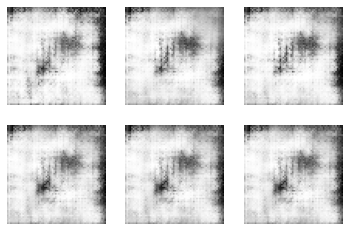

4401 [D loss: 0.626974, acc.: 87.50%] [G loss: 0.865098]
4402 [D loss: 0.607170, acc.: 89.06%] [G loss: 0.925837]
4403 [D loss: 0.587225, acc.: 88.67%] [G loss: 0.974457]
4404 [D loss: 0.578219, acc.: 92.58%] [G loss: 0.969355]
4405 [D loss: 0.590266, acc.: 91.41%] [G loss: 0.936504]
4406 [D loss: 0.605136, acc.: 91.80%] [G loss: 0.858127]
4407 [D loss: 0.630404, acc.: 91.80%] [G loss: 0.776659]
4408 [D loss: 0.657256, acc.: 52.34%] [G loss: 0.722447]
4409 [D loss: 0.674003, acc.: 44.14%] [G loss: 0.699304]
4410 [D loss: 0.676833, acc.: 39.84%] [G loss: 0.684299]
4411 [D loss: 0.679597, acc.: 37.89%] [G loss: 0.680266]
4412 [D loss: 0.692922, acc.: 35.55%] [G loss: 0.681144]
4413 [D loss: 0.689980, acc.: 34.77%] [G loss: 0.680388]
4414 [D loss: 0.681768, acc.: 34.77%] [G loss: 0.683707]
4415 [D loss: 0.683024, acc.: 37.11%] [G loss: 0.687868]
4416 [D loss: 0.685512, acc.: 34.77%] [G loss: 0.687793]
4417 [D loss: 0.690692, acc.: 30.47%] [G loss: 0.689492]
4418 [D loss: 0.693207, acc.: 3

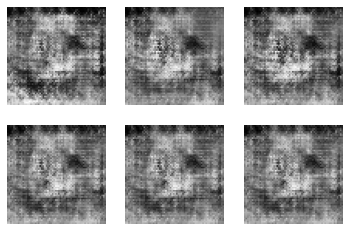

4451 [D loss: 0.686466, acc.: 55.47%] [G loss: 0.718956]
4452 [D loss: 0.682831, acc.: 62.11%] [G loss: 0.725126]
4453 [D loss: 0.678961, acc.: 62.50%] [G loss: 0.728800]
4454 [D loss: 0.685451, acc.: 58.98%] [G loss: 0.727190]
4455 [D loss: 0.669170, acc.: 62.50%] [G loss: 0.732861]
4456 [D loss: 0.669040, acc.: 64.45%] [G loss: 0.743245]
4457 [D loss: 0.659555, acc.: 70.31%] [G loss: 0.752386]
4458 [D loss: 0.664284, acc.: 64.84%] [G loss: 0.747100]
4459 [D loss: 0.660600, acc.: 69.92%] [G loss: 0.759569]
4460 [D loss: 0.653197, acc.: 70.70%] [G loss: 0.758887]
4461 [D loss: 0.634286, acc.: 76.17%] [G loss: 0.775034]
4462 [D loss: 0.643823, acc.: 71.09%] [G loss: 0.774930]
4463 [D loss: 0.636275, acc.: 75.78%] [G loss: 0.787123]
4464 [D loss: 0.632505, acc.: 73.05%] [G loss: 0.794002]
4465 [D loss: 0.631609, acc.: 76.95%] [G loss: 0.802143]
4466 [D loss: 0.634059, acc.: 70.70%] [G loss: 0.800125]
4467 [D loss: 0.616153, acc.: 78.91%] [G loss: 0.806040]
4468 [D loss: 0.632318, acc.: 7

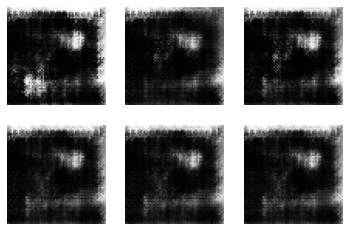

4501 [D loss: 0.676282, acc.: 57.42%] [G loss: 0.959920]
4502 [D loss: 0.665461, acc.: 70.70%] [G loss: 1.000883]
4503 [D loss: 0.678654, acc.: 62.89%] [G loss: 0.964618]
4504 [D loss: 0.704550, acc.: 59.77%] [G loss: 0.889799]
4505 [D loss: 0.722959, acc.: 48.44%] [G loss: 0.765588]
4506 [D loss: 0.770573, acc.: 22.66%] [G loss: 0.681697]
4507 [D loss: 0.788752, acc.: 21.09%] [G loss: 0.647137]
4508 [D loss: 0.800542, acc.: 19.14%] [G loss: 0.640831]
4509 [D loss: 0.794973, acc.: 22.66%] [G loss: 0.627546]
4510 [D loss: 0.817389, acc.: 20.31%] [G loss: 0.621984]
4511 [D loss: 0.792449, acc.: 22.27%] [G loss: 0.630430]
4512 [D loss: 0.785797, acc.: 20.70%] [G loss: 0.638575]
4513 [D loss: 0.772059, acc.: 22.66%] [G loss: 0.644691]
4514 [D loss: 0.778344, acc.: 20.70%] [G loss: 0.643965]
4515 [D loss: 0.755240, acc.: 25.39%] [G loss: 0.652003]
4516 [D loss: 0.773838, acc.: 20.31%] [G loss: 0.643655]
4517 [D loss: 0.754431, acc.: 25.78%] [G loss: 0.655508]
4518 [D loss: 0.754050, acc.: 2

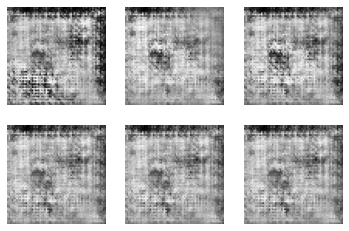

4551 [D loss: 0.688587, acc.: 42.97%] [G loss: 0.708648]
4552 [D loss: 0.693566, acc.: 39.84%] [G loss: 0.691975]
4553 [D loss: 0.693336, acc.: 41.02%] [G loss: 0.684702]
4554 [D loss: 0.703921, acc.: 37.50%] [G loss: 0.682167]
4555 [D loss: 0.710624, acc.: 31.64%] [G loss: 0.673741]
4556 [D loss: 0.707003, acc.: 28.91%] [G loss: 0.681371]
4557 [D loss: 0.702880, acc.: 34.38%] [G loss: 0.684923]
4558 [D loss: 0.712261, acc.: 28.52%] [G loss: 0.692291]
4559 [D loss: 0.706581, acc.: 33.98%] [G loss: 0.700443]
4560 [D loss: 0.694527, acc.: 41.80%] [G loss: 0.715102]
4561 [D loss: 0.688089, acc.: 44.14%] [G loss: 0.723485]
4562 [D loss: 0.683923, acc.: 52.73%] [G loss: 0.737258]
4563 [D loss: 0.680464, acc.: 63.28%] [G loss: 0.749284]
4564 [D loss: 0.669253, acc.: 73.44%] [G loss: 0.770021]
4565 [D loss: 0.660258, acc.: 75.39%] [G loss: 0.787161]
4566 [D loss: 0.653771, acc.: 73.83%] [G loss: 0.800365]
4567 [D loss: 0.637301, acc.: 79.69%] [G loss: 0.819015]
4568 [D loss: 0.634701, acc.: 8

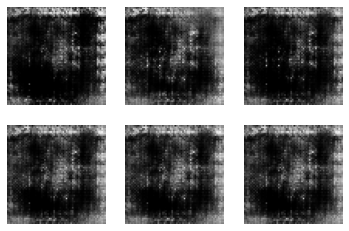

4601 [D loss: 0.469708, acc.: 80.86%] [G loss: 1.701694]
4602 [D loss: 0.504187, acc.: 82.81%] [G loss: 1.440310]
4603 [D loss: 0.621149, acc.: 78.52%] [G loss: 0.970751]
4604 [D loss: 0.701595, acc.: 49.61%] [G loss: 0.716139]
4605 [D loss: 0.753701, acc.: 34.38%] [G loss: 0.630098]
4606 [D loss: 0.777508, acc.: 33.98%] [G loss: 0.586114]
4607 [D loss: 0.791068, acc.: 32.81%] [G loss: 0.584291]
4608 [D loss: 0.763124, acc.: 36.33%] [G loss: 0.585621]
4609 [D loss: 0.802154, acc.: 28.91%] [G loss: 0.576373]
4610 [D loss: 0.778657, acc.: 35.94%] [G loss: 0.584872]
4611 [D loss: 0.756735, acc.: 32.42%] [G loss: 0.597536]
4612 [D loss: 0.720787, acc.: 36.33%] [G loss: 0.612007]
4613 [D loss: 0.716832, acc.: 34.77%] [G loss: 0.633528]
4614 [D loss: 0.708930, acc.: 37.11%] [G loss: 0.655124]
4615 [D loss: 0.697698, acc.: 33.59%] [G loss: 0.674222]
4616 [D loss: 0.682015, acc.: 39.45%] [G loss: 0.688265]
4617 [D loss: 0.680717, acc.: 42.19%] [G loss: 0.705183]
4618 [D loss: 0.668314, acc.: 5

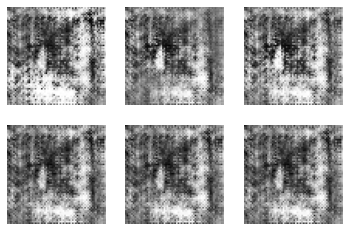

4651 [D loss: 0.671853, acc.: 42.97%] [G loss: 0.686413]
4652 [D loss: 0.698386, acc.: 32.81%] [G loss: 0.680520]
4653 [D loss: 0.705793, acc.: 29.30%] [G loss: 0.677254]
4654 [D loss: 0.706885, acc.: 30.08%] [G loss: 0.681985]
4655 [D loss: 0.732528, acc.: 29.30%] [G loss: 0.673720]
4656 [D loss: 0.718763, acc.: 29.69%] [G loss: 0.686450]
4657 [D loss: 0.729546, acc.: 26.95%] [G loss: 0.701709]
4658 [D loss: 0.735454, acc.: 25.00%] [G loss: 0.729777]
4659 [D loss: 0.727396, acc.: 25.78%] [G loss: 0.784065]
4660 [D loss: 0.694337, acc.: 52.73%] [G loss: 0.859892]
4661 [D loss: 0.644573, acc.: 71.88%] [G loss: 0.983469]
4662 [D loss: 0.621710, acc.: 66.41%] [G loss: 1.130709]
4663 [D loss: 0.565374, acc.: 71.09%] [G loss: 1.269316]
4664 [D loss: 0.537229, acc.: 70.31%] [G loss: 1.408718]
4665 [D loss: 0.503032, acc.: 75.39%] [G loss: 1.453933]
4666 [D loss: 0.489771, acc.: 76.17%] [G loss: 1.524332]
4667 [D loss: 0.473842, acc.: 75.00%] [G loss: 1.586716]
4668 [D loss: 0.475124, acc.: 7

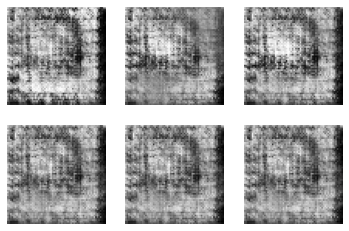

4701 [D loss: 0.748742, acc.: 26.56%] [G loss: 0.639993]
4702 [D loss: 0.749144, acc.: 28.12%] [G loss: 0.648669]
4703 [D loss: 0.738610, acc.: 21.88%] [G loss: 0.661886]
4704 [D loss: 0.733159, acc.: 25.39%] [G loss: 0.668577]
4705 [D loss: 0.733070, acc.: 24.61%] [G loss: 0.676305]
4706 [D loss: 0.712801, acc.: 29.69%] [G loss: 0.693294]
4707 [D loss: 0.711574, acc.: 33.20%] [G loss: 0.707120]
4708 [D loss: 0.712501, acc.: 34.38%] [G loss: 0.702555]
4709 [D loss: 0.698408, acc.: 42.19%] [G loss: 0.716469]
4710 [D loss: 0.703455, acc.: 41.02%] [G loss: 0.721215]
4711 [D loss: 0.702231, acc.: 46.88%] [G loss: 0.724918]
4712 [D loss: 0.692744, acc.: 50.39%] [G loss: 0.730175]
4713 [D loss: 0.677953, acc.: 56.25%] [G loss: 0.753085]
4714 [D loss: 0.675891, acc.: 54.30%] [G loss: 0.761740]
4715 [D loss: 0.677472, acc.: 49.22%] [G loss: 0.768417]
4716 [D loss: 0.652805, acc.: 57.42%] [G loss: 0.799563]
4717 [D loss: 0.652029, acc.: 57.03%] [G loss: 0.820864]
4718 [D loss: 0.635186, acc.: 7

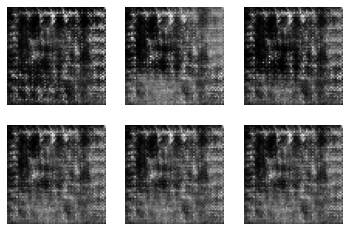

4751 [D loss: 0.656039, acc.: 70.31%] [G loss: 0.892714]
4752 [D loss: 0.687529, acc.: 68.36%] [G loss: 0.835592]
4753 [D loss: 0.675625, acc.: 75.00%] [G loss: 0.781650]
4754 [D loss: 0.697336, acc.: 62.89%] [G loss: 0.765482]
4755 [D loss: 0.683492, acc.: 53.91%] [G loss: 0.746321]
4756 [D loss: 0.711915, acc.: 43.75%] [G loss: 0.729360]
4757 [D loss: 0.687022, acc.: 51.56%] [G loss: 0.720212]
4758 [D loss: 0.720306, acc.: 35.55%] [G loss: 0.705618]
4759 [D loss: 0.697508, acc.: 34.38%] [G loss: 0.694715]
4760 [D loss: 0.722753, acc.: 33.20%] [G loss: 0.697857]
4761 [D loss: 0.716477, acc.: 30.47%] [G loss: 0.695094]
4762 [D loss: 0.714728, acc.: 35.16%] [G loss: 0.695313]
4763 [D loss: 0.699731, acc.: 33.20%] [G loss: 0.700388]
4764 [D loss: 0.708959, acc.: 33.20%] [G loss: 0.700383]
4765 [D loss: 0.687036, acc.: 44.92%] [G loss: 0.710358]
4766 [D loss: 0.682249, acc.: 46.09%] [G loss: 0.717830]
4767 [D loss: 0.681906, acc.: 55.08%] [G loss: 0.727085]
4768 [D loss: 0.690634, acc.: 5

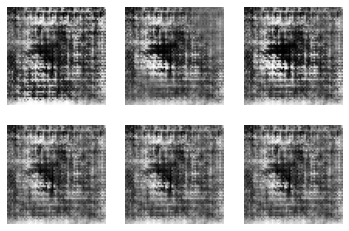

4801 [D loss: 0.720556, acc.: 29.30%] [G loss: 0.645517]
4802 [D loss: 0.758697, acc.: 24.22%] [G loss: 0.625232]
4803 [D loss: 0.781231, acc.: 25.00%] [G loss: 0.595932]
4804 [D loss: 0.802197, acc.: 25.39%] [G loss: 0.571199]
4805 [D loss: 0.832884, acc.: 21.88%] [G loss: 0.564939]
4806 [D loss: 0.832659, acc.: 21.09%] [G loss: 0.558705]
4807 [D loss: 0.834925, acc.: 23.44%] [G loss: 0.560080]
4808 [D loss: 0.816233, acc.: 22.66%] [G loss: 0.609862]
4809 [D loss: 0.779765, acc.: 19.14%] [G loss: 0.664485]
4810 [D loss: 0.741186, acc.: 46.88%] [G loss: 0.740592]
4811 [D loss: 0.693120, acc.: 50.00%] [G loss: 0.833713]
4812 [D loss: 0.652217, acc.: 63.67%] [G loss: 0.935265]
4813 [D loss: 0.632308, acc.: 68.75%] [G loss: 0.978436]
4814 [D loss: 0.619402, acc.: 71.88%] [G loss: 1.005087]
4815 [D loss: 0.626203, acc.: 71.48%] [G loss: 0.980591]
4816 [D loss: 0.634950, acc.: 78.52%] [G loss: 0.908404]
4817 [D loss: 0.660608, acc.: 73.05%] [G loss: 0.828468]
4818 [D loss: 0.684631, acc.: 6

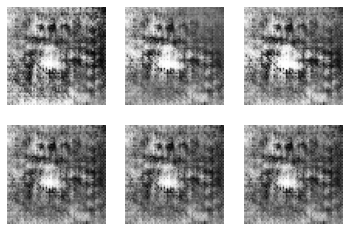

4851 [D loss: 0.645665, acc.: 78.52%] [G loss: 0.764874]
4852 [D loss: 0.661678, acc.: 66.80%] [G loss: 0.752894]
4853 [D loss: 0.677781, acc.: 60.55%] [G loss: 0.740998]
4854 [D loss: 0.673132, acc.: 61.33%] [G loss: 0.733555]
4855 [D loss: 0.684772, acc.: 58.59%] [G loss: 0.722535]
4856 [D loss: 0.703831, acc.: 50.78%] [G loss: 0.702827]
4857 [D loss: 0.695546, acc.: 41.80%] [G loss: 0.705220]
4858 [D loss: 0.699699, acc.: 45.70%] [G loss: 0.719564]
4859 [D loss: 0.703902, acc.: 48.44%] [G loss: 0.736014]
4860 [D loss: 0.690480, acc.: 54.69%] [G loss: 0.776251]
4861 [D loss: 0.661501, acc.: 67.58%] [G loss: 0.843111]
4862 [D loss: 0.629347, acc.: 72.66%] [G loss: 0.915039]
4863 [D loss: 0.604488, acc.: 74.22%] [G loss: 0.987786]
4864 [D loss: 0.562671, acc.: 76.56%] [G loss: 1.070921]
4865 [D loss: 0.557451, acc.: 75.00%] [G loss: 1.145069]
4866 [D loss: 0.508253, acc.: 79.30%] [G loss: 1.251314]
4867 [D loss: 0.506594, acc.: 78.12%] [G loss: 1.331829]
4868 [D loss: 0.471763, acc.: 8

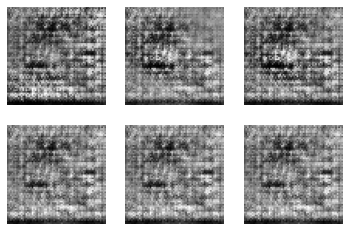

4901 [D loss: 0.774244, acc.: 29.69%] [G loss: 0.595639]
4902 [D loss: 0.768263, acc.: 28.12%] [G loss: 0.609621]
4903 [D loss: 0.766965, acc.: 26.17%] [G loss: 0.629904]
4904 [D loss: 0.749511, acc.: 26.56%] [G loss: 0.643419]
4905 [D loss: 0.747436, acc.: 26.56%] [G loss: 0.656067]
4906 [D loss: 0.736284, acc.: 23.05%] [G loss: 0.671857]
4907 [D loss: 0.713948, acc.: 27.34%] [G loss: 0.687710]
4908 [D loss: 0.729300, acc.: 22.27%] [G loss: 0.697478]
4909 [D loss: 0.720804, acc.: 27.73%] [G loss: 0.708549]
4910 [D loss: 0.711427, acc.: 47.27%] [G loss: 0.720676]
4911 [D loss: 0.693470, acc.: 50.78%] [G loss: 0.725181]
4912 [D loss: 0.704577, acc.: 58.98%] [G loss: 0.732471]
4913 [D loss: 0.694556, acc.: 66.41%] [G loss: 0.741230]
4914 [D loss: 0.694246, acc.: 66.41%] [G loss: 0.745124]
4915 [D loss: 0.693805, acc.: 62.89%] [G loss: 0.749309]
4916 [D loss: 0.686546, acc.: 64.84%] [G loss: 0.755978]
4917 [D loss: 0.688140, acc.: 66.80%] [G loss: 0.758763]
4918 [D loss: 0.686558, acc.: 6

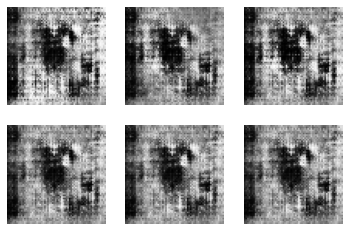

4951 [D loss: 0.680336, acc.: 51.17%] [G loss: 0.737173]
4952 [D loss: 0.680484, acc.: 44.14%] [G loss: 0.727973]
4953 [D loss: 0.708261, acc.: 37.89%] [G loss: 0.715582]
4954 [D loss: 0.714386, acc.: 34.77%] [G loss: 0.712746]
4955 [D loss: 0.723969, acc.: 30.08%] [G loss: 0.692660]
4956 [D loss: 0.736772, acc.: 28.91%] [G loss: 0.694249]
4957 [D loss: 0.737352, acc.: 33.98%] [G loss: 0.691206]
4958 [D loss: 0.751160, acc.: 26.17%] [G loss: 0.720038]
4959 [D loss: 0.723890, acc.: 43.75%] [G loss: 0.782639]
4960 [D loss: 0.688369, acc.: 50.39%] [G loss: 0.877972]
4961 [D loss: 0.639674, acc.: 71.48%] [G loss: 1.014397]
4962 [D loss: 0.618931, acc.: 69.14%] [G loss: 1.135998]
4963 [D loss: 0.587555, acc.: 69.14%] [G loss: 1.224141]
4964 [D loss: 0.579282, acc.: 71.09%] [G loss: 1.244945]
4965 [D loss: 0.570718, acc.: 71.48%] [G loss: 1.249266]
4966 [D loss: 0.560753, acc.: 77.34%] [G loss: 1.211778]
4967 [D loss: 0.606188, acc.: 71.48%] [G loss: 1.152894]
4968 [D loss: 0.614721, acc.: 7

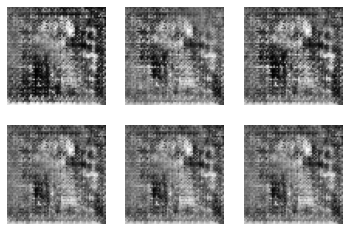

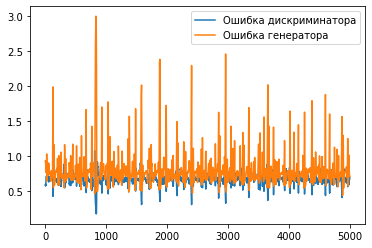

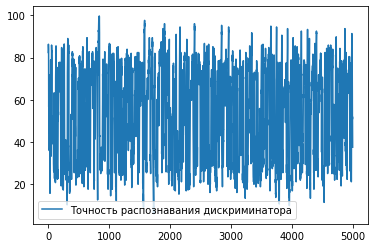

In [35]:
train(generator, discriminator, 5000)

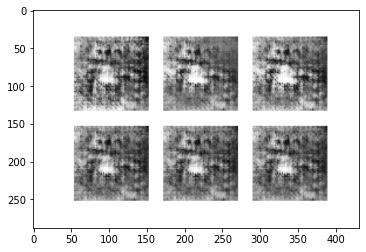

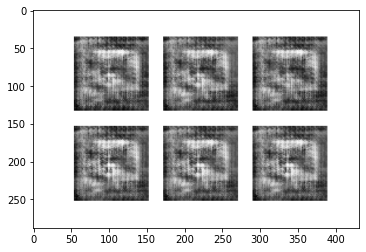

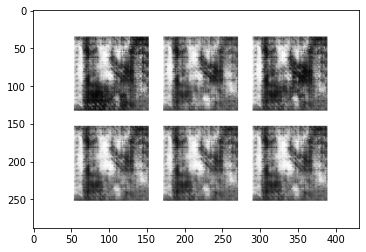

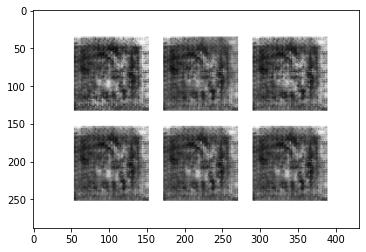

In [45]:
paths = ['4850.png', '1500.png','2100.png','3450.png']
for i in paths :
  img = cv2.imread('images/' + i)
  plt.imshow(img)
  plt.show()